In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.stattools import durbin_watson
from statsmodels.tsa.stattools import grangercausalitytests
import matplotlib.pyplot as plt
import warnings
import os
import glob

warnings.filterwarnings("ignore")

In [2]:
plt.rcParams['axes.labelsize'] = 20
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
plt.rcParams['figure.titlesize'] = 28
plt.rcParams['legend.fontsize'] = 20

In [3]:
plt.rcParams["figure.figsize"] = (8, 6.5)

In [4]:
colors_langs_dict = {"English": "#666666", 
                    "Ukrainian": "#e7298a",
                    "Polish": "#d95f02",
                    "German": "#d95f02",
                    "Russian": "#1b9e77",
                    "Ukrainian refugees": "#000000",
                    "DANE": "#000000"}

# DATA 

## UNHCR data
The data from UNHCR consists of the daily number of Ukrainian refugees crossing the border from Ukraine to Poland 24th of February 2022.

In [5]:
df_official = pd.read_csv("data_official/Border crossings to Poland from Ukraine - by date.csv", sep=",")
df_official["Date"] = df_official["Date"].astype('datetime64[ns]')
df_official.set_index("Date", inplace=True)

df_official

,Ukrainian refugees
Date,
2022-02-24,30096
2022-02-25,46347
2022-02-26,76575
2022-02-27,98115
2022-02-28,99245
...,...
2023-03-03,20058
2023-03-04,21908
2023-03-05,19376


Text(0.5, 1.0, 'Daily number of Ukrainian refugees crossing the border from Ukraine to Poland')

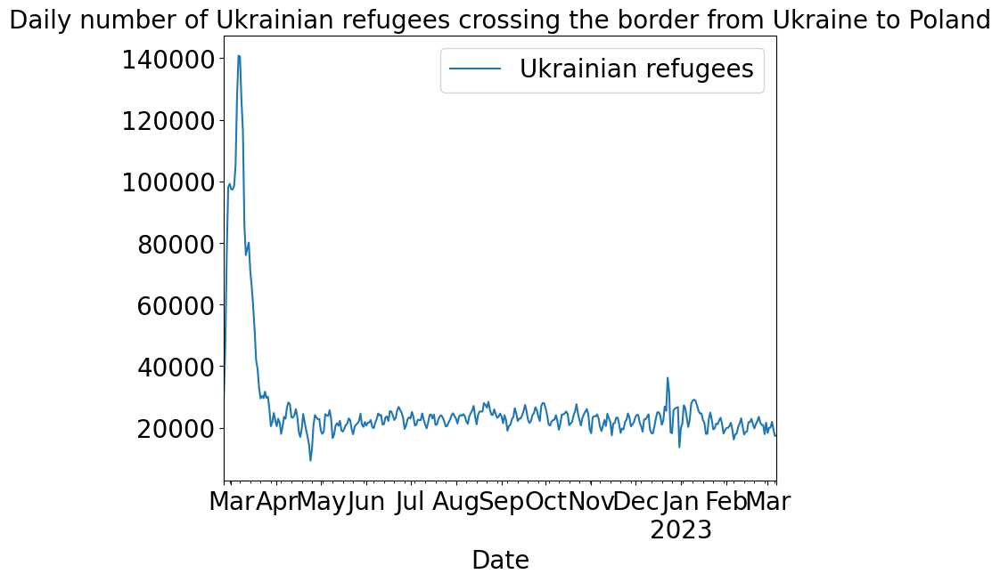

In [6]:
df_official.plot()
plt.title("Daily number of Ukrainian refugees crossing the border from Ukraine to Poland")

## Wikipedia data

In [7]:
# use glob to get all the csv files in the folder
path = os.getcwd()
csv_files_preprocess = glob.glob(os.path.join(path, "data_cities_PL/preprocessed/*-prop-daily.csv"))
csv_files_preprocess = list(set(csv_files_preprocess))

In [8]:
csv_files_preprocess

['C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Kraków-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Łódź-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Poznań-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Gliwice-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Częstochowa-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Lublin-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Sosnowiec-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Kielce-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Radom-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Rzeszów-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Gdynia-prop-daily.csv',
 'C:\\Cloud\\wikimig_OSF-NEW!\\data_cities_PL/preprocessed\\Wrocław-p

In [9]:
df_merged = df_official

for f in csv_files_preprocess:
    city = f.split("\\")[-1].split("-")[0]
    
    df = pd.read_csv(f, low_memory=False, index_col=0)

    df.index = df.index.astype('datetime64[ns]')
    df = df.loc[:, ["English", "Polish", "Russian", "Ukrainian"]]
    
    ## COMBINING DATASETS: UNHRC + WIKIPEDIA VIEWS (PL, EN, UK)
    df_merged = df_merged.merge(df.add_prefix(city + " "), how="right", left_index=True, right_index=True)

In [10]:
df_merged

,Ukrainian refugees,Kraków English,Kraków Polish,Kraków Russian,Kraków Ukrainian,Łódź English,Łódź Polish,Łódź Russian,Łódź Ukrainian,Poznań English,...,Gdańsk Russian,Gdańsk Ukrainian,Białystok English,Białystok Polish,Białystok Russian,Białystok Ukrainian,Katowice English,Katowice Polish,Katowice Russian,Katowice Ukrainian
2020-08-24,NaN,0.000007,0.000201,0.000019,0.000043,0.000003,0.000133,0.000013,0.000024,0.000003,...,0.000025,0.000025,0.000002,0.000130,0.000014,0.000015,0.000002,0.000094,0.000007,0.000029
2020-08-25,NaN,0.000006,0.000204,0.000019,0.000060,0.000003,0.000130,0.000013,0.000025,0.000003,...,0.000023,0.000045,0.000002,0.000115,0.000014,0.000011,0.000002,0.000094,0.000008,0.000018
2020-08-26,NaN,0.000006,0.000214,0.000019,0.000033,0.000002,0.000131,0.000014,0.000034,0.000003,...,0.000023,0.000049,0.000002,0.000106,0.000013,0.000015,0.000002,0.000091,0.000008,0.000023
2020-08-27,NaN,0.000007,0.000278,0.000022,0.000043,0.000002,0.000150,0.000015,0.000030,0.000003,...,0.000024,0.000037,0.000002,0.000116,0.000020,0.000016,0.000002,0.000109,0.000008,0.000016
2020-08-28,NaN,0.000006,0.000248,0.000023,0.000031,0.000003,0.000148,0.000015,0.000028,0.000003,...,0.000024,0.000035,0.000002,0.000111,0.000016,0.000018,0.000002,0.000104,0.000008,0.000021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-08-20,NaN,0.000008,0.000214,0.000024,0.000095,0.000003,0.000189,0.000012,0.000042,0.000003,...,0.000027,0.000088,0.000002,0.000117,0.000016,0.000026,0.000002,0.000129,0.000013,0.000060
2023-08-21,NaN,0.000008,0.000215,0.000021,0.000080,0.000003,0.000171,0.000013,0.000040,0.000003,...,0.000027,0.000081,0.000002,0.000113,0.000014,0.000019,0.000002,0.000125,0.000012,0.000050
2023-08-22,NaN,0.000008,0.000185,0.000021,0.000071,0.000003,0.000156,0.000011,0.000034,0.000003,...,0.000025,0.000060,0.000002,0.000112,0.000012,0.000012,0.000003,0.000124,0.000011,0.000048
2023-08-23,NaN,0.000008,0.000195,0.000019,0.000061,0.000003,0.000155,0.000011,0.000028,0.000003,...,0.000023,0.000057,0.000002,0.000091,0.000010,0.000010,0.000003,0.000117,0.000011,0.000037


In [11]:
df_merged.to_csv("data/data_unhcr_border_crossing_and_wiki_prop_daily_views_merged.csv")

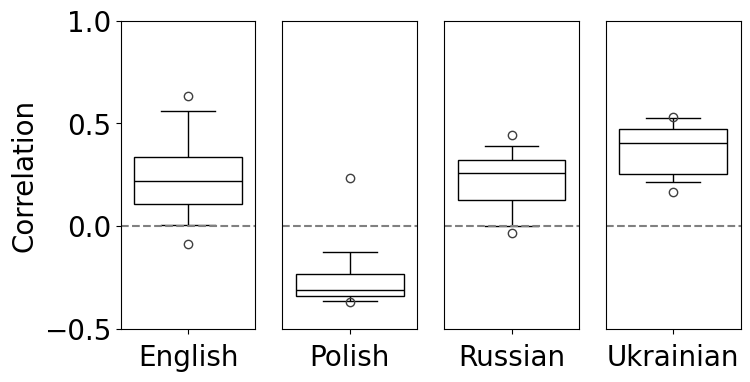

In [12]:
PROPS = {
    'boxprops':{'facecolor':'white', 'edgecolor':'black'},
    'medianprops':{'color':'black'},
    'whiskerprops':{'color':'black'},
    'capprops':{'color':'black'}
}

plt.rcParams["figure.figsize"] = (8, 4)

# Store the list of columns
suffix_columns_to_plot = ['English', 'Polish', 'Russian', 'Ukrainian']

# Create the figure and two subplots
fig, axes = plt.subplots(ncols=len(suffix_columns_to_plot))

# Create the boxplot with Seaborn
for c, axis in zip(suffix_columns_to_plot, axes):
           
    df_aux = df_merged[["Ukrainian refugees"] + [col for col in df_merged if c in col]] #all cities in language c
    df_aux = df_aux.dropna()
    df_aux = df_aux.T.drop_duplicates().T
    corrs = df_aux.corr().iloc[1:-1,0].tolist()
    
    sns.boxplot(data=corrs, ax=axis, whis=[5,95], **PROPS) 
    
    if c == "English":
        #axis.set_title("Correlation between number of views on Wikipedia pages dedicated to \nPolish cities across different languages and the number of Ukrainian \nrefugees crossing the border from Ukraine to Poland (24.02.22-07.03.23)", 
        #              loc="left")
        axis.set(ylabel="Correlation", xlabel="English", ylim=(-0.5, 1))
        
    elif c == "Polish":
        axis.set(yticks=[], xlabel="Polish", ylim=(-0.5, 1))
        
    elif c == "Russian":
        axis.set(yticks=[], xlabel="Russian", ylim=(-0.5, 1))
        
    elif c == "Ukrainian":
        axis.set(yticks=[], xlabel="Ukrainian", ylim=(-0.5, 1))
        
    axis.axhline(0, ls='--', c='gray')
    

plt.savefig(f"figs/corr-boxplot-595.pdf", format="pdf", bbox_inches="tight")
plt.show()

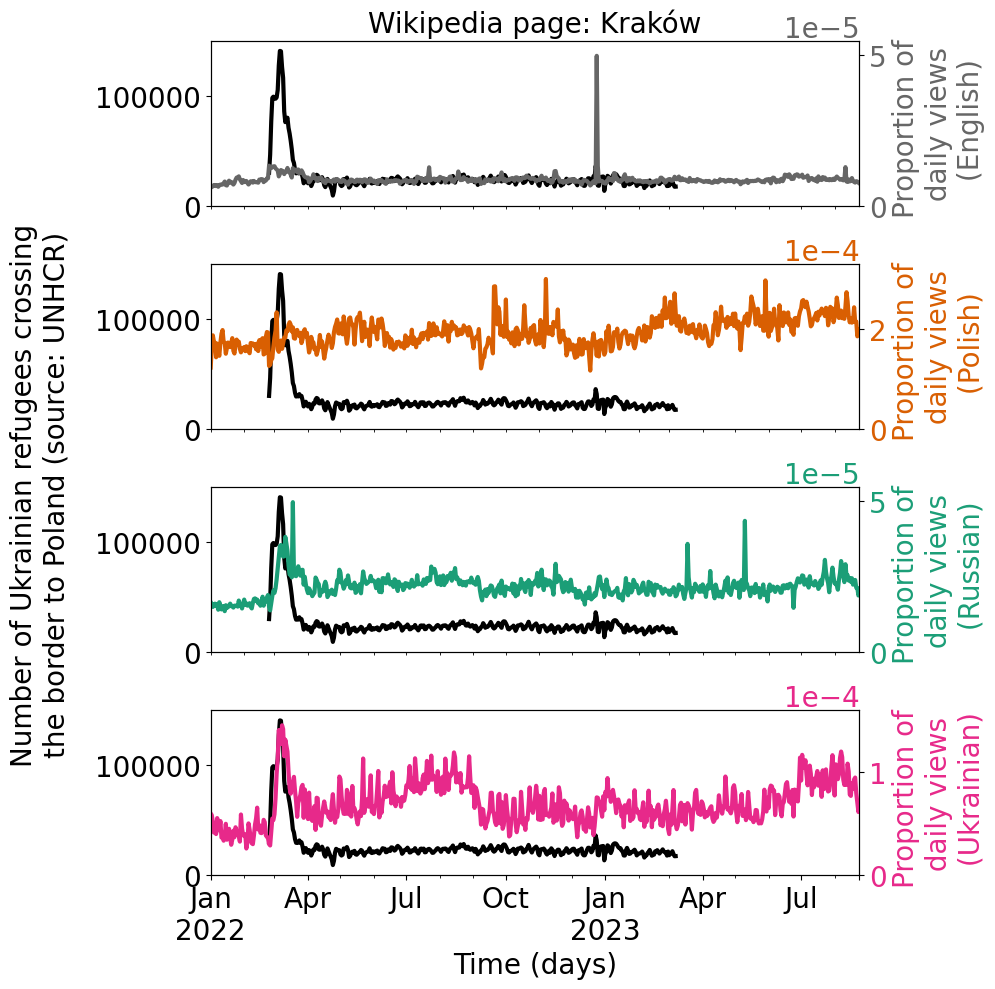

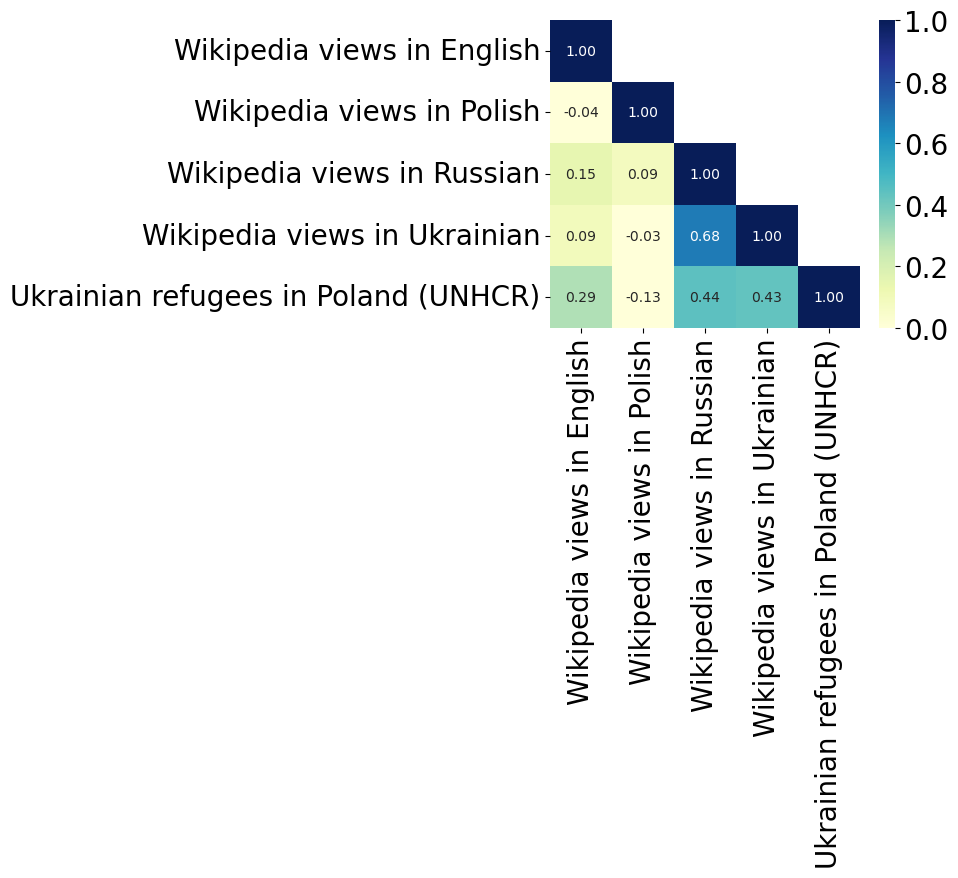

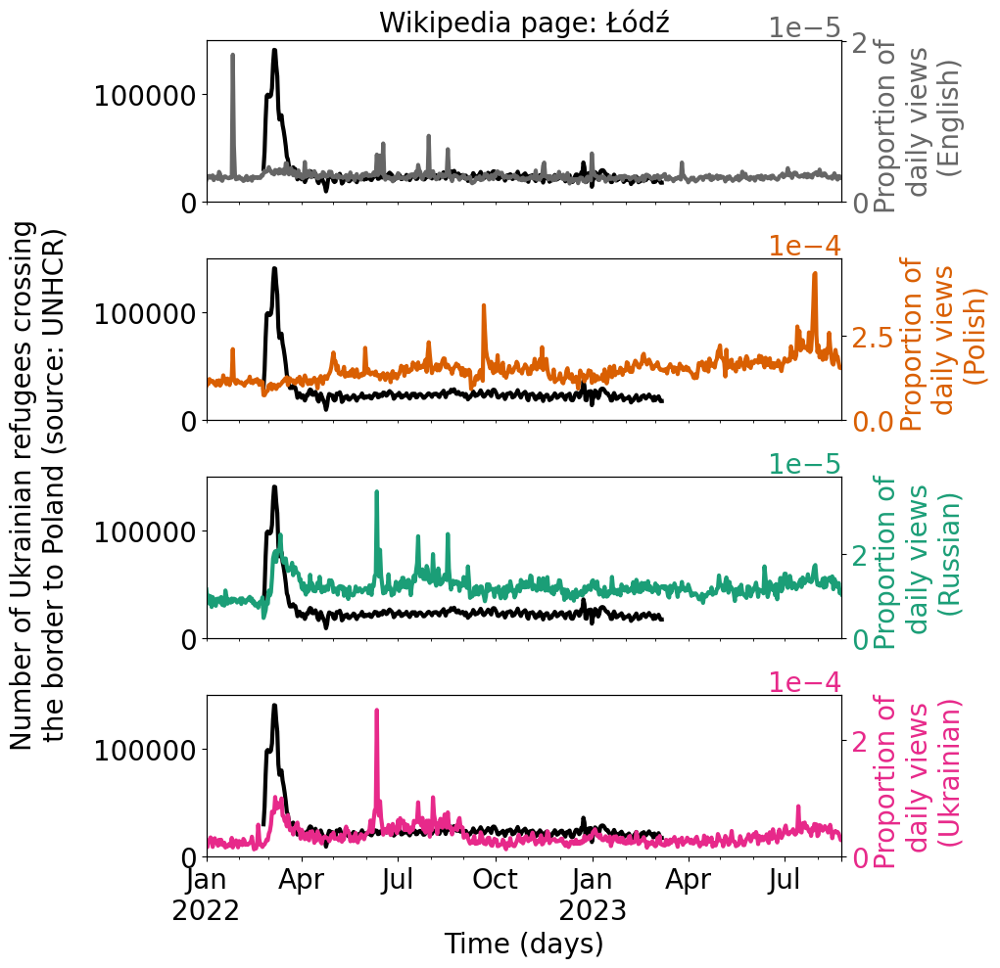

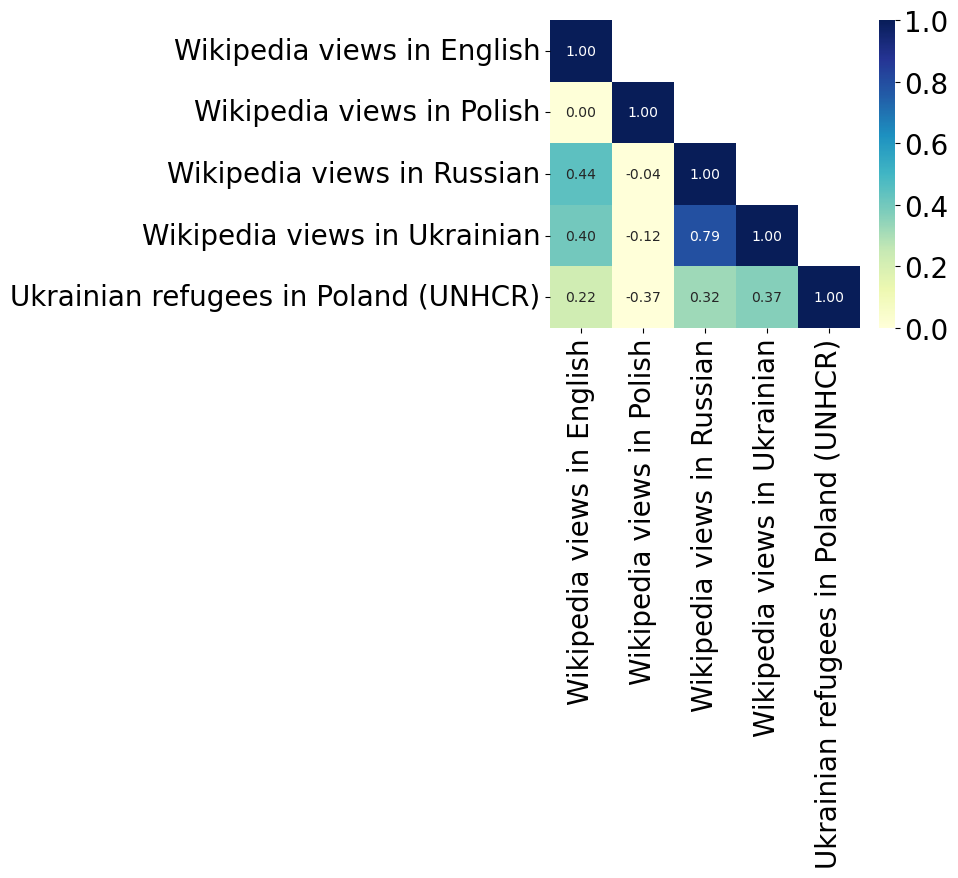

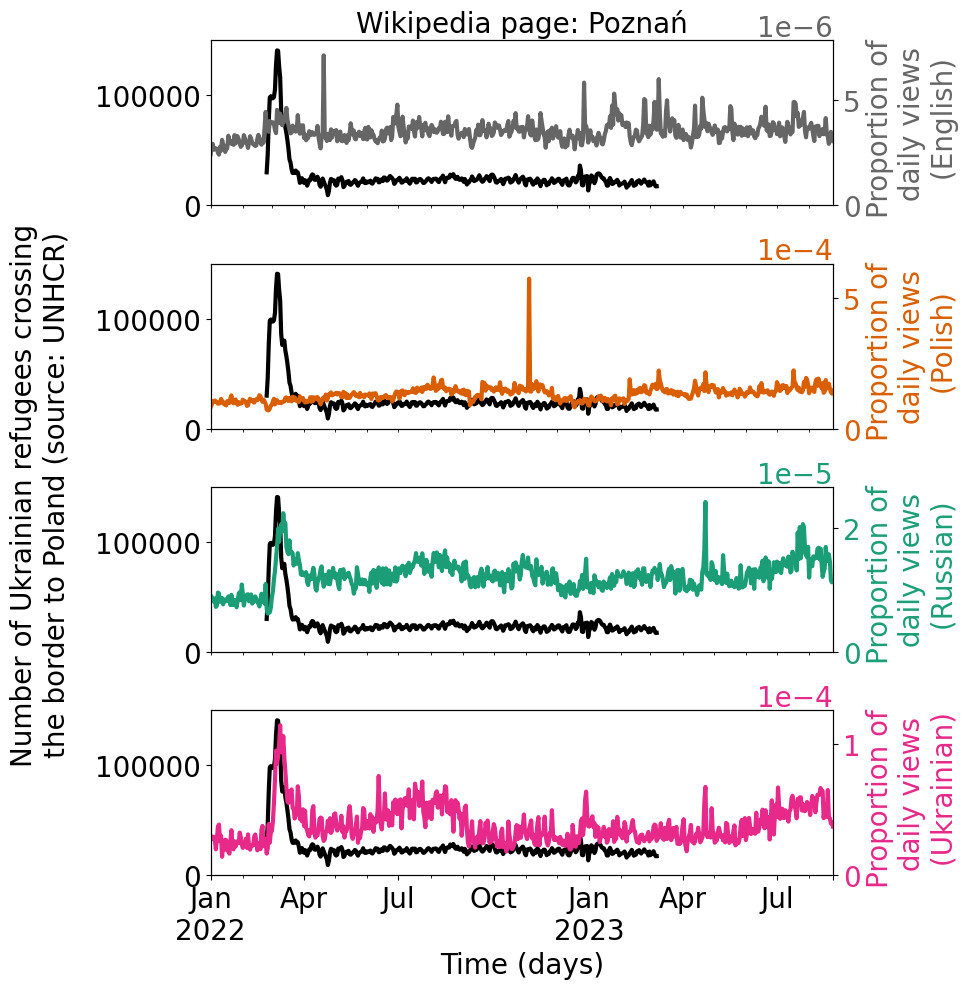

...

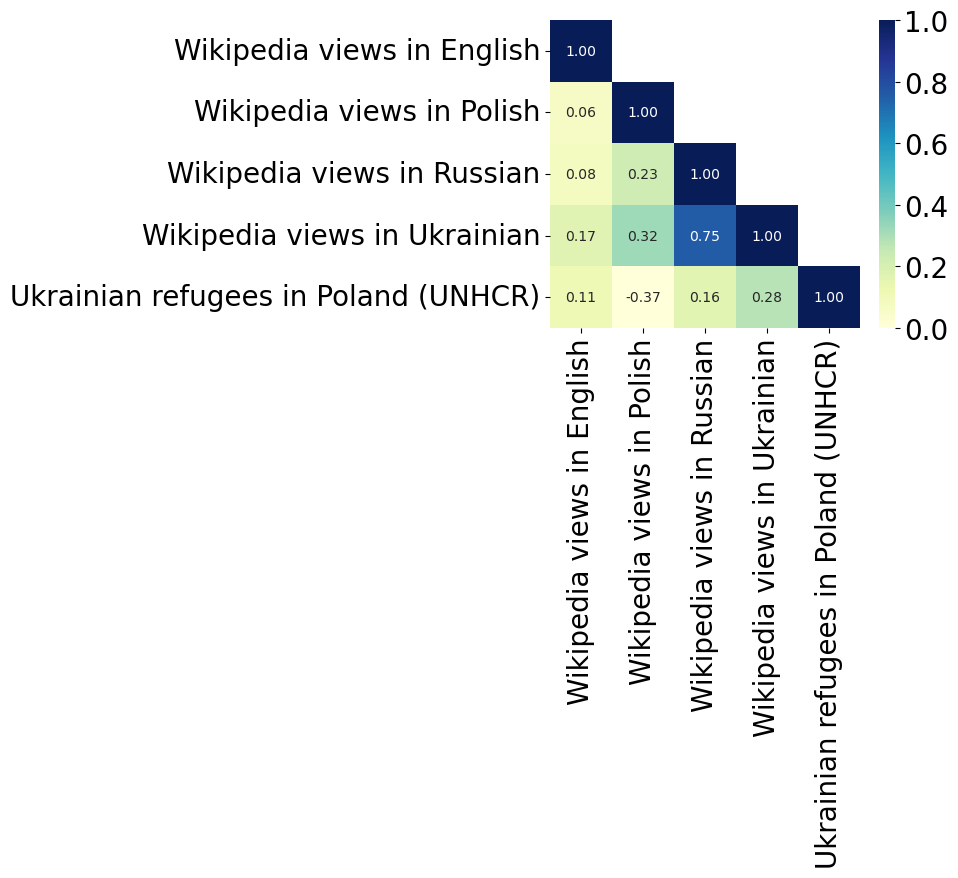

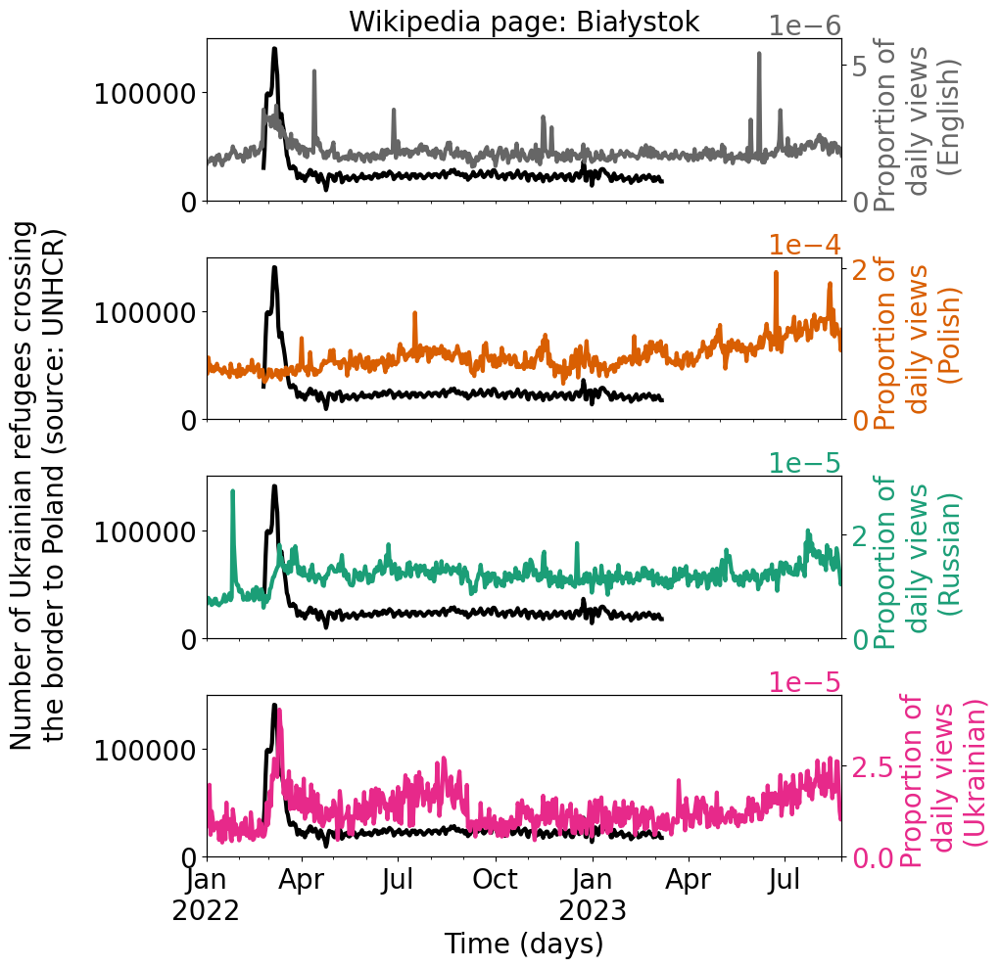

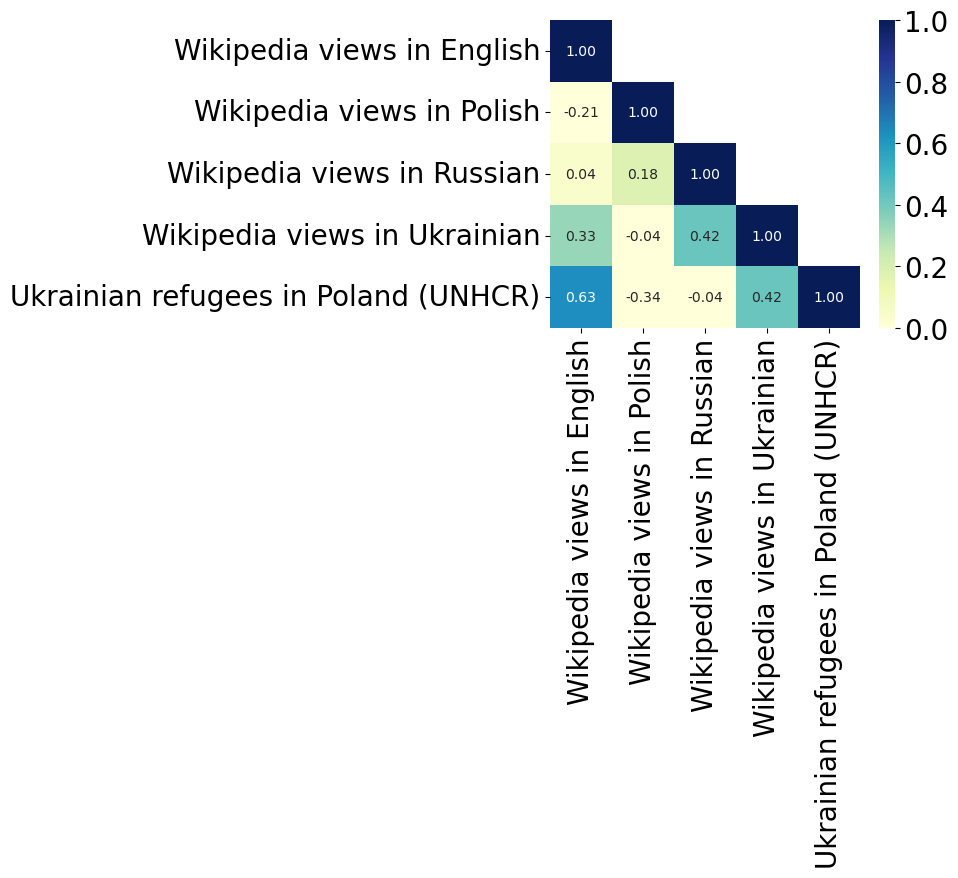

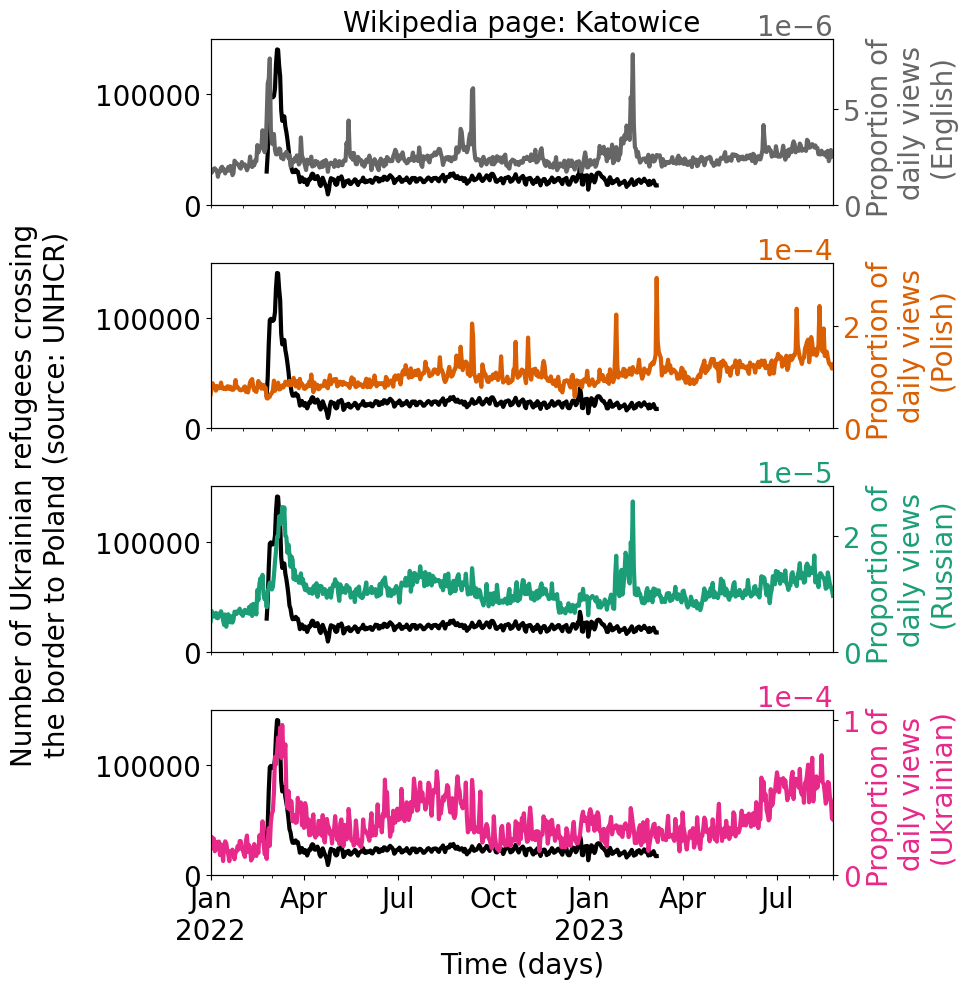

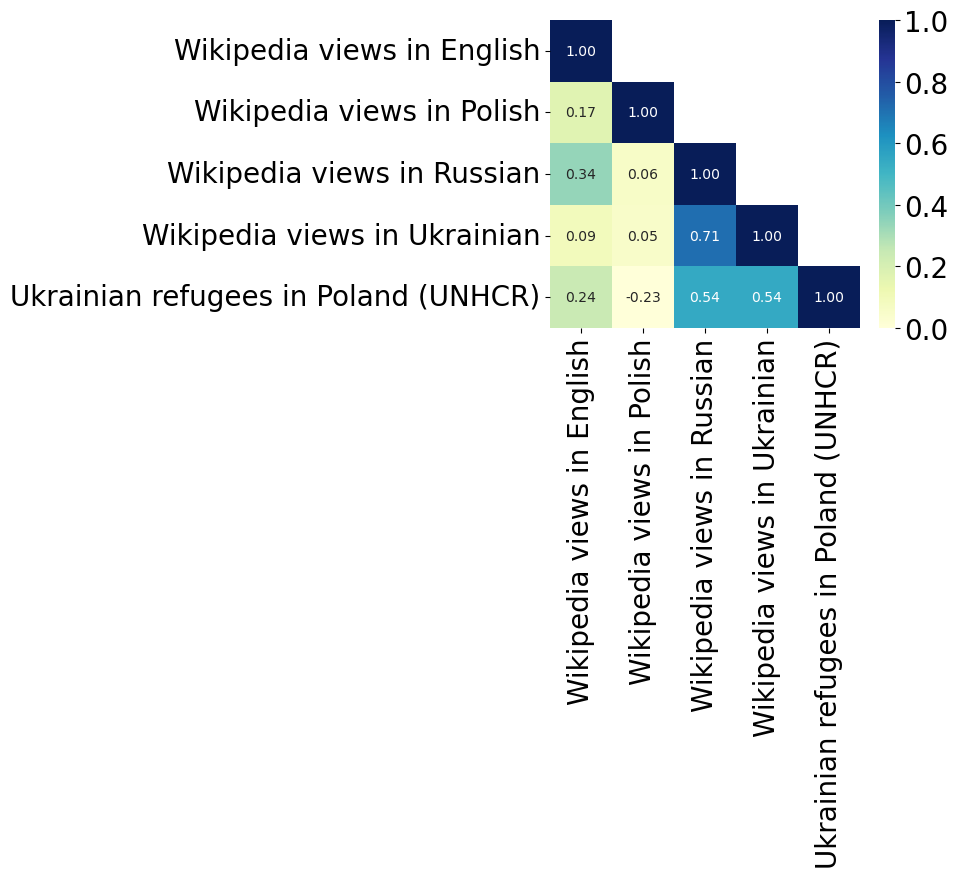

In [13]:
for f in csv_files_preprocess:
    
    plt.rcParams["figure.figsize"] = (8, 8)
    
    city = f.split("\\")[-1].split("-")[0]
    
    filter_col = ["Ukrainian refugees"] + [col for col in df_merged if col.startswith(city)]
    
    df = df_merged[filter_col]
    df.columns = [c.split(" ")[1] if city in c else c for c in df.columns]

    df_plot = df_merged[filter_col]
    df_plot.columns = [c.split(" ")[1] if city in c else c for c in df.columns]

    df_plot = df_plot.reindex(sorted(df_plot.columns), axis=1)

    ## DF PLOT!!! RANGE
    df_plot = df_plot["2022-01-01":]
      
    fig, axes1 = plt.subplots(4, 1, figsize=(10, 10))
    
    df_plot[["Ukrainian refugees"]].plot.line(
        ax=axes1[0], color=colors_langs_dict, title="Wikipedia page: " + city, ylim=(0, 150000), legend=None, lw=3)
    df_plot[["Ukrainian refugees"]].plot.line(
        ax=axes1[1], color=colors_langs_dict, ylim=(0, 150000), legend=None, lw=3)
    df_plot[["Ukrainian refugees"]].plot.line(
        ax=axes1[2], color=colors_langs_dict, ylim=(0, 150000), legend=None, lw=3)
    df_plot[["Ukrainian refugees"]].plot.line(
        ax=axes1[3], color=colors_langs_dict, ylim=(0, 150000), legend=None, lw=3)
    
    axes1[3].set_xlabel('Time (days)')
    # Centralized y-axis label
    fig.text(0.04, 0.5, 'Number of Ukrainian refugees crossing\nthe border to Poland (source: UNHCR)',
         va='center', ha='center', rotation='vertical', color=colors_langs_dict["Ukrainian refugees"], fontsize=20)
    #axes1[1].set_ylabel('Number of Ukrainian refugees crossing\nthe border to Poland (source: UNHCR)', color=colors_langs_dict["Ukrainian refugees"])
    
    axes20 = axes1[0].twinx()  # instantiate a second axes that shares the same x-axis
    axes21 = axes1[1].twinx()  # instantiate a second axes that shares the same x-axis
    axes22 = axes1[2].twinx()  # instantiate a second axes that shares the same x-axis
    axes23 = axes1[3].twinx()  # instantiate a second axes that shares the same x-axis

    df_plot[["English"]].plot.line(
        ax=axes20, color=colors_langs_dict, xticks=[], ylim=(0, df_plot["English"].max()*1.1), legend=None, lw=3)
    axes20.set_ylabel('Proportion of \n daily views \n (English)', color=colors_langs_dict["English"])
    axes20.ticklabel_format(axis='y', scilimits=[-3, 3])
    axes20.tick_params(axis='y', labelcolor=colors_langs_dict["English"])
    
    df_plot[["Polish"]].plot.line(
        ax=axes21, color=colors_langs_dict, xticks=[], ylim=(0, df_plot["Polish"].max()*1.1), legend=None, lw=3)
    axes21.set_ylabel('Proportion of \n daily views \n (Polish)', color=colors_langs_dict["Polish"])
    axes21.ticklabel_format(axis='y', scilimits=[-3, 3])
    axes21.tick_params(axis='y', labelcolor=colors_langs_dict["Polish"])
    
    df_plot[["Russian"]].plot.line(
        ax=axes22, color=colors_langs_dict, xticks=[], ylim=(0, df_plot["Russian"].max()*1.1), legend=None, lw=3)
    axes22.set_ylabel('Proportion of \n daily views \n (Russian)', color=colors_langs_dict["Russian"])
    axes22.ticklabel_format(axis='y', scilimits=[-3, 3])
    axes22.tick_params(axis='y', labelcolor=colors_langs_dict["Russian"])
    
    df_plot[["Ukrainian"]].plot.line(
        ax=axes23, color=colors_langs_dict, ylim=(0, df_plot["Ukrainian"].max()*1.1), legend=None, lw=3)
    axes23.set_ylabel('Proportion of \n daily views \n (Ukrainian)', color=colors_langs_dict["Ukrainian"])
    axes23.ticklabel_format(axis='y', scilimits=[-3, 3])
    axes23.tick_params(axis='y', labelcolor=colors_langs_dict["Ukrainian"])
    
    
    plt.tight_layout(rect=[0.08, 0, 1, 1])  # otherwise the right y-label is slightly clipped
    # Create output directory if it doesn't exist
    output_dir = f"figs/series/"
    os.makedirs(output_dir, exist_ok=True)
    plt.savefig(f"{output_dir}/plot-" + city + ".pdf", format="pdf", bbox_inches="tight")
    plt.show()
    
    plt.rcParams["figure.figsize"] = (5, 4)
    df_plot.rename(columns={"Ukrainian refugees": "Ukrainian refugees in Poland (UNHCR)", 
                       "Polish": "Wikipedia views in Polish", 
                       "English": "Wikipedia views in English", 
                       "Russian": "Wikipedia views in Russian", 
                       "Ukrainian": "Wikipedia views in Ukrainian"}, inplace=True)
    
    corr_wiki_unhcr = df_plot.dropna().corr()
    mask = np.triu(np.ones_like(corr_wiki_unhcr, dtype=bool))
    np.fill_diagonal(mask, False)
    sns.heatmap(corr_wiki_unhcr, cmap="YlGnBu", mask=mask, annot=True, vmin=0, vmax=1, fmt='.2f')
    
    #plt.title(city + ": Correlation between number of views on Wikipedia page \n dedicated to " + city + " across different languages and \n the number of Ukrainian refugees crossing the border \n from Ukraine to Poland (24.02.22-07.03.23)")
    # Create output directory if it doesn't exist
    #output_dir = f"figs/corr/"
    #os.makedirs(output_dir, exist_ok=True)
    #plt.savefig(f"{output_dir}/corr-{city}.pdf", format="pdf", bbox_inches="tight")
    plt.show()   

    # Create output directory if it doesn't exist
    output_dir = f"data_cities_PL/Wiki+UNHCR"
    os.makedirs(output_dir, exist_ok=True)
    df_plot.to_csv(f"{output_dir}/{city}_dataset_prop_wiki_views_polish_cities_and_UNHCR_border_crossing.csv")

    

### Following the methodology presented in: [“Keep Your Heads Held High Boys!”: Examining the Relationship between the Proud Boys’ Online Discourse and Offline Activities](https://www.cambridge.org/core/journals/american-political-science-review/article/keep-your-heads-held-high-boys-examining-the-relationship-between-the-proud-boys-online-discourse-and-offline-activities/D2EFAADAB8EE8633340A4F81460551FC#article)   

AIC and FPE → TO FIND OPTIMAL LAG LENGHTS (~ 8 days lag)  

ADF → STATIONARY (stationary at optimal number of 8 days lag  )

LM → ABSENCE OF AUTOCORRELATION OF THE RESIDUALS  

VAR → STABILITY  

GRANGER CAUSALITY


The Null hypothesis for grangercausalitytests is that the time series in the second column, x2, does NOT Granger cause the time series in the first column, x1. Grange causality means that past values of x2 have a statistically significant effect on the current value of x1, taking past values of x1 into account as regressors. We reject the null hypothesis that x2 does not Granger cause x1 if the pvalues are below a desired size of the test.

https://www.machinelearningplus.com/time-series/granger-causality-test-in-python/


The Granger Causality test is used to determine whether or not one time series is useful for forecasting another.

This test uses the following null and alternative hypotheses:

* Null Hypothesis (H0): Time series x does not Granger-cause time series y

* Alternative Hypothesis (HA): Time series x Granger-causes time series y

The term “Granger-causes” means that knowing the value of time series x at a certain lag is useful for predicting the value of time series y at a later time period.

This test produces an F test statistic with a corresponding p-value. If the p-value is less than a certain significance level (i.e. α = .05), then we can reject the null hypothesis and conclude that we have sufficient evidence to say that time series x Granger-causes time series y.

https://www.statology.org/granger-causality-test-in-python/



In [14]:
def check_stationarity(series, max_lag=30, significance=0.05):
    """Performs ADF test and returns True if series is stationary."""
    adf_result = adfuller(series, maxlag=max_lag, autolag='AIC')
    p_value = adf_result[1]
    return p_value < significance


def optimal_lag_selection(data, maxlags=30):
    """Returns optimal lag length based on AIC and FPE."""
    model = VAR(data)
    results = model.select_order(maxlags=maxlags)
    print("Lag Order Selection:")
    print(results.summary())
    return results.aic


def var_model_diagnostics(var_result):
    """Stability and autocorrelation diagnostics."""
    # Check stability (all eigenvalues inside unit circle)
    is_stable = var_result.is_stable(verbose=True)

    # Durbin-Watson statistic for autocorrelation
    dw_stats = durbin_watson(var_result.resid)
    #The closer to 0 the statistic, the more evidence for positive serial correlation. 
    #The closer to 4, the more evidence for negative serial correlation.
    print(f"\nDurbin-Watson Statistics (close to 2 indicates no autocorrelation):")
    for col, stat in zip(var_result.resid.columns, dw_stats):
        print(f"{col}: {stat:.2f}")

    return is_stable


def run_var_analysis(df, maxlags=30, significance=0.05, irf_steps=30, wiki_page="", language="", save=False):
    # Step 1: Optimal lag selection using AIC and FPE
    print("Step 1: Optimal lag selection using AIC and FPE")
    selected_lag = optimal_lag_selection(df, maxlags=maxlags)
    print(f"Selected lag: {selected_lag}")

    # Step 2: Check stationarity of both time series at selected lags
    print("Step 2: Check stationarity of both time series at selected lags")
    for col in df.columns:
        if not check_stationarity(df[col], max_lag=selected_lag, significance=significance):
            print(f"Warning: Series '{col}' is not stationary at lag {selected_lag}.")
        else:
            print(f"Series '{col}' is stationary at lag {selected_lag}.")

    # Step 3: Fit the VAR model
    print("Step 3: Fit the VAR model")
    model = VAR(df)
    var_result = model.fit(selected_lag)
    print(var_result.summary())

    # Step 4: Diagnostics
    print("Step 4: Testing the VAR model for stability and absence of autocorrelation of the residuals")
    stable = var_model_diagnostics(var_result)
    if not stable:
        print("Warning: VAR model may not be stable.")
    else:
        print("VAR model stable.")

    # Step 5: IRF Plot
    print(wiki_page)
    print(f"\nImpulse Response Functions (up to {irf_steps} steps):")
    irf = var_result.irf(irf_steps)
    fig = irf.plot(orth=True)

    # Loop over all subplots to reduce title font size
    for ax in fig.get_axes():
        title = ax.get_title()
        ax.set_title(title, fontsize=8)  # Customize size here
    
    plt.tight_layout()
    if save:
        # Create output directory if it doesn't exist
        output_dir = f"figs/irf/"
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/{wiki_page}-{language}.pdf", format="pdf", bbox_inches="tight")
    plt.show()

    return selected_lag

In [15]:
def extract_granger_combined_results(data, maxlag):
    """
    Extract F-statistic and p-value for each lag/direction and combine them into a single string.
    """
    variables = data.columns
    records = []

    for cause, effect in [(variables[0], variables[1]), (variables[1], variables[0])]:
        result = grangercausalitytests(data[[effect, cause]], maxlag=maxlag, verbose=False)

        f_stat, p_val = result[maxlag][0]['ssr_ftest'][:2]
        chi2_stat, chi2_p_val = result[maxlag][0]['ssr_chi2test'][:2]
        records.append({
            'Cause': cause,
            'Effect': effect,
            'Lag': maxlag,
            'F-statistic': f"{f_stat:.4f}",
            'p-value': f"{p_val:.4f}",
            'Chi-squared test (p-value)': f"{chi2_stat:.4f} (p = {chi2_p_val:.4f})",
        })

    return records


def format_granger_combined_table(df_results, significance_level=0.05):
    """
    Format combined F-statistic and p-value into a pivoted table.
    """
    table = df_results.pivot(index='Lag', columns=['Cause', 'Effect'], values=['F-statistic', 'p-value'])

    return table


def plot_granger_causality(df, city, save=False):
    
    df = df[df["City"] == city]
    df_f = pd.pivot_table(df, values='F-statistic', index=['Cause'],
                       columns=['Effect'])
    # Select a specific variable (e.g., 'A')
    var = "Ukrainian refugees in Poland (UNHCR)"
    
    # Row 1: var as cause — other columns are effect
    cause_row = df_f.loc[var].drop(var)
    
    # Row 2: var as effect — other rows are cause
    effect_row = df_f.drop(var)[var]
    
    # Create 2-row dataframe for heatmap
    heatmap_df = pd.DataFrame([cause_row.values, effect_row.values],
                              index=[f"{var} is the cause", f"{var} is the effect"],
                              columns=cause_row.index)
    
    # Plot
    plt.figure(figsize=(6, 2.5))
    sns.heatmap(heatmap_df, cmap="YlGnBu", annot=True, vmin=0, vmax=max(heatmap_df.max())+1, fmt='.2f', cbar_kws={'label': 'F-statistic'}, annot_kws={'va':'bottom'})
    plt.title(f"{city}: Granger Causality")
    plt.ylabel("")
    
    if save:
        # Create output directory if it doesn't exist
        output_dir = f"figs/granger/"
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/granger-f-{city}.pdf", format="pdf", bbox_inches="tight")
        
    plt.show()
    

def plot_fstat_by_relationship(df_input):
    PROPS = {
    'boxprops':{'facecolor':'white', 'edgecolor':'black'},
    'medianprops':{'color':'black'},
    'whiskerprops':{'color':'black'},
    'capprops':{'color':'black'}
    }

    # Define prettier colors with transparency
    blue = (31/255, 119/255, 180/255, 0.7)  # seaborn-style blue, 70% opacity
    red  = (214/255, 39/255, 40/255, 0.7)   # seaborn-style red, 70% opacity
    # Define color based on p-value
    df = df_input.copy(deep=True)
    df['color'] = df['p-value'].apply(lambda p: blue if p < 0.05 else red)
    
    # Set style
    #sns.set(style="whitegrid")
    
    # Create the boxplot (with outliers)
    fig, ax = plt.subplots(figsize=(10, 4))
    sns.boxplot(x='F-statistic', y='Relationship', data=df, ax=ax, whis=[5,95], **PROPS)
    
    # Get group y-locations
    group_order = df['Relationship'].unique()
    group_to_y = {group: i for i, group in enumerate(group_order)}
    
    # Plot each point centered on its group (no jitter)
    for _, row in df.iterrows():
        y_pos = group_to_y[row['Relationship']]
        ax.scatter(row['F-statistic'], y_pos, color=row['color'], s=10, zorder=3)
    
    # Custom legend
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor=blue, label='p-value < 0.05'),
        Patch(facecolor=red, label='p-value ≥ 0.05')
    ]
    ax.legend(handles=legend_elements, title="", loc='upper right')
    
    # Final touches
    plt.title("Granger Causality F-statistics")
    plt.xlabel("F-statistic")
    plt.ylabel("Relationship")
    plt.savefig(f"figs/granger-f-boxplot595.pdf", format="pdf", bbox_inches="tight")
    plt.show()

In [16]:
# use glob to get all the csv files in the folder
path = os.getcwd()
csv_files = glob.glob(os.path.join(path, "data_cities_PL/Wiki+UNHCR/*.csv"))
csv_files = list(set(csv_files))

Toruń
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -15.16      -15.14   2.599e-07      -15.15
1       -15.79      -15.73   1.383e-07      -15.77
2       -15.85     -15.74*   1.304e-07      -15.81
3       -15.84      -15.68   1.325e-07      -15.77
4       -15.83      -15.63   1.334e-07      -15.75
5       -15.86      -15.62   1.293e-07      -15.76
6       -15.95      -15.66   1.181e-07     -15.84*
7       -15.95      -15.61   1.187e-07      -15.81
8      -15.98*      -15.60  1.152e-07*      -15.83
9       -15.96      -15.54   1.173e-07      -15.79
10      -15.94      -15.48   1.193e-07      -15.76
11      -15.94      -15.43   1.199e-07      -15.73
12      -15.93      -15.38   1.207e-07      -15.71
13      -15.93      -15.33   1.204e-07      -15.69
14      -15.94      -15.29   1.202e-07      -15.68
15     

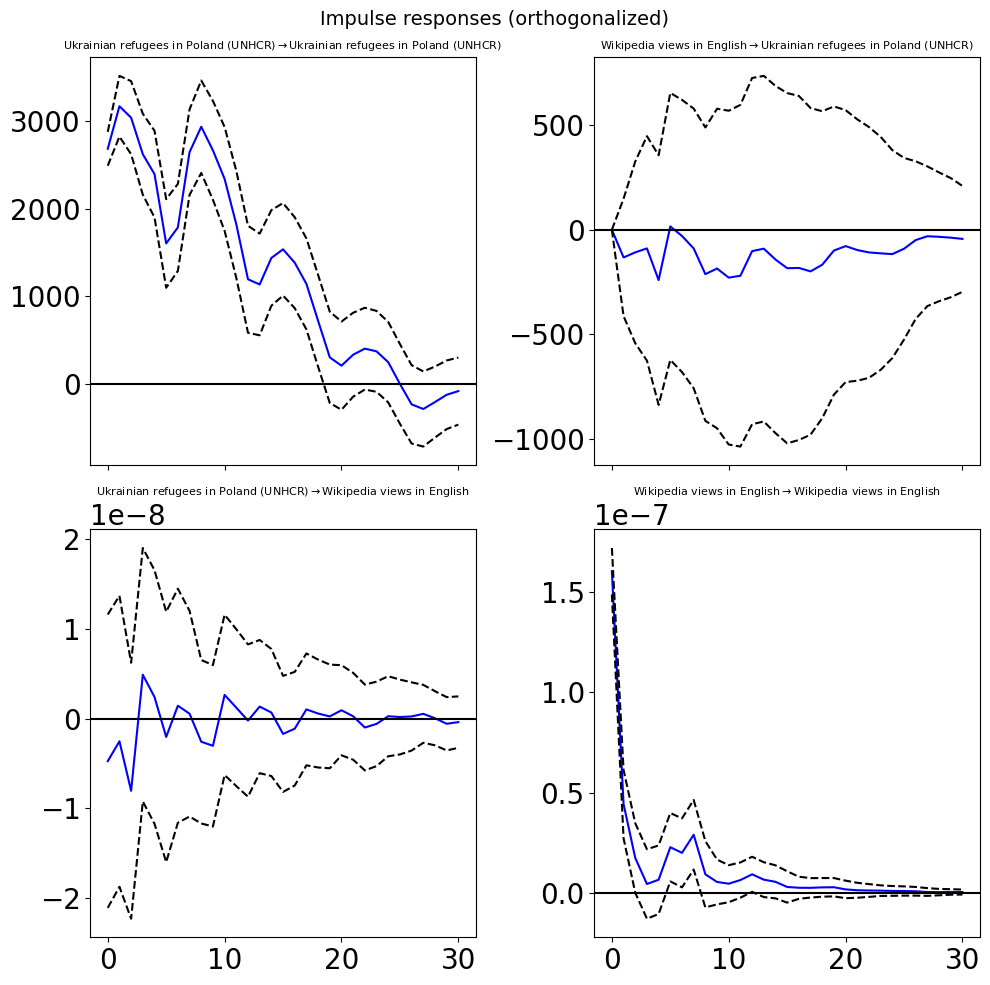

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.2770   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.9472   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.9732   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.4775

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.862      -5.840    0.002845      -5.853
1       -6.917      -6.851   0.0009906      -6.891
2       -7.003     -6.892*   0.0009089      -6.959
3       -7.004      -6.849   0.0009079      -6.943
4       -7.011      -6.811   0.0009022      -6.931
5       -7.048      -6.804   0.0008690      -6.951
6       -7.123      -6.835   0.0008062     -7.008*
7       -7.131      -6.798   0.0008000      -6.998
8      -7.154*      -6.777  0.0007817*      -7.004
9       -7.135      -6.714   0.0007967      -6.967
10      -7.125      -6.659   0.0008049      -6.940
11      -7.108      -6.598   0.0008188      -6.905
12      -7.095      -6.540   0.0008296      -6.874
13      -7.078      -6.479   0.0008436      -6.840
14      -7.062      -6.418   0.0008579      -6.806
15      -7.05

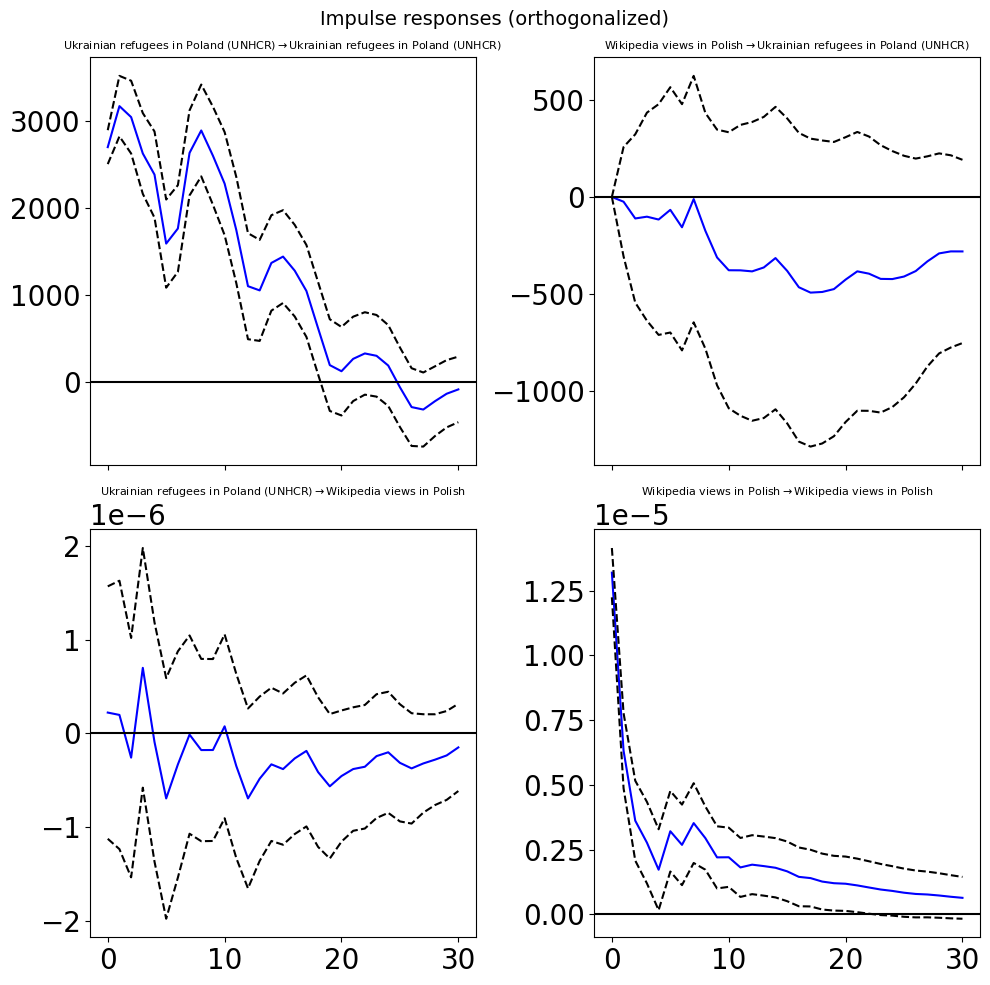

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.6589   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.5834   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.7276   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.7916

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -11.98      -11.96   6.261e-06      -11.97
1       -12.72      -12.65   3.004e-06      -12.69
2       -12.84     -12.72*   2.665e-06      -12.79
3       -12.83      -12.67   2.684e-06      -12.77
4       -12.82      -12.62   2.713e-06      -12.74
5       -12.86      -12.61   2.608e-06      -12.76
6       -12.98      -12.70   2.297e-06     -12.87*
7       -12.98      -12.64   2.312e-06      -12.85
8      -13.01*      -12.64  2.232e-06*      -12.86
9       -12.99      -12.57   2.284e-06      -12.82
10      -12.98      -12.52   2.301e-06      -12.80
11      -12.99      -12.48   2.274e-06      -12.79
12      -12.98      -12.42   2.311e-06      -12.76
13      -12.97      -12.37   2.329e-06      -12.73
14      -12.95      -12.31   2.369e-06      -12.70
15      -12.9

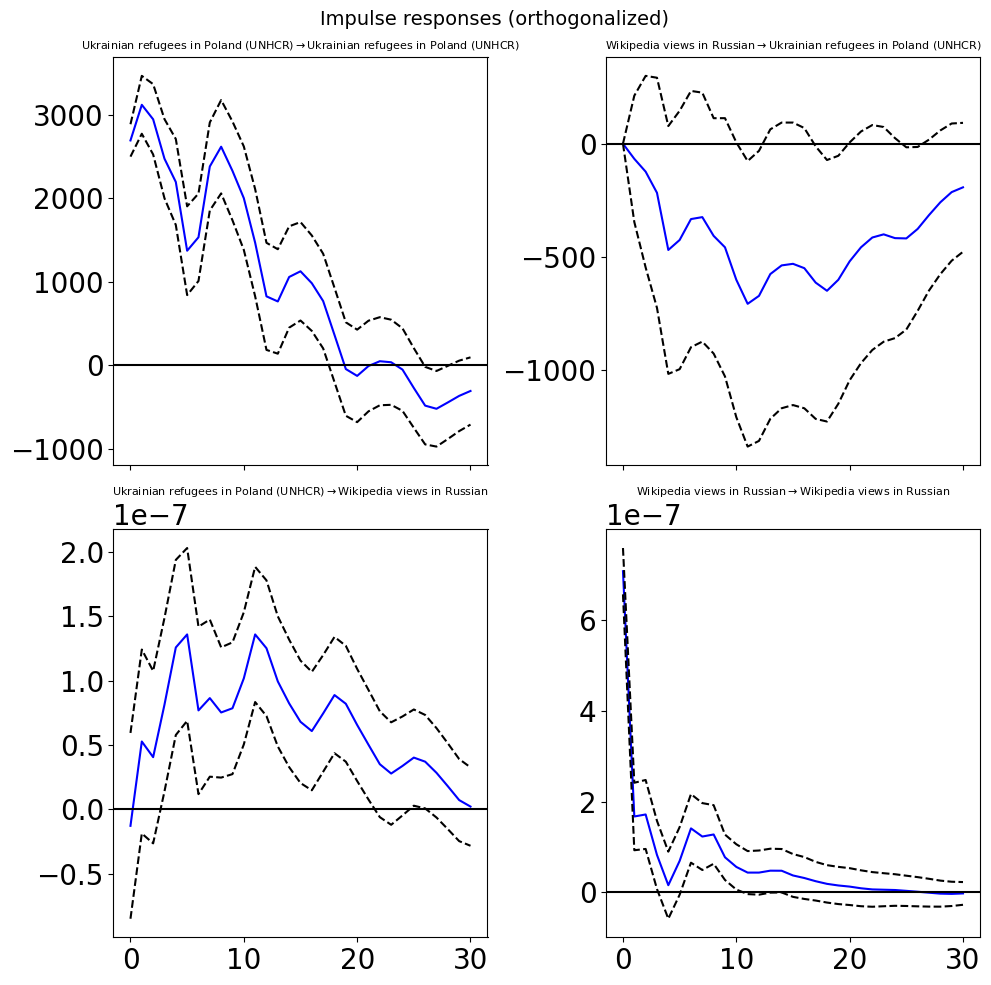

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    6.2105   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.8172   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.5878

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -8.352      -8.330   0.0002359      -8.343
1       -9.278      -9.211   9.349e-05      -9.251
2       -9.382      -9.272   8.419e-05      -9.338
3       -9.399      -9.244   8.280e-05      -9.337
4       -9.464      -9.264   7.762e-05      -9.384
5       -9.524      -9.279   7.312e-05      -9.426
6       -9.624     -9.335*   6.616e-05      -9.509
7       -9.667      -9.334   6.335e-05      -9.534
8      -9.697*      -9.320  6.148e-05*     -9.547*
9       -9.678      -9.256   6.267e-05      -9.510
10      -9.658      -9.193   6.390e-05      -9.473
11      -9.641      -9.131   6.504e-05      -9.438
12      -9.639      -9.084   6.518e-05      -9.418
13      -9.628      -9.029   6.592e-05      -9.389
14      -9.617      -8.974   6.662e-05      -9.361
15      -9.62

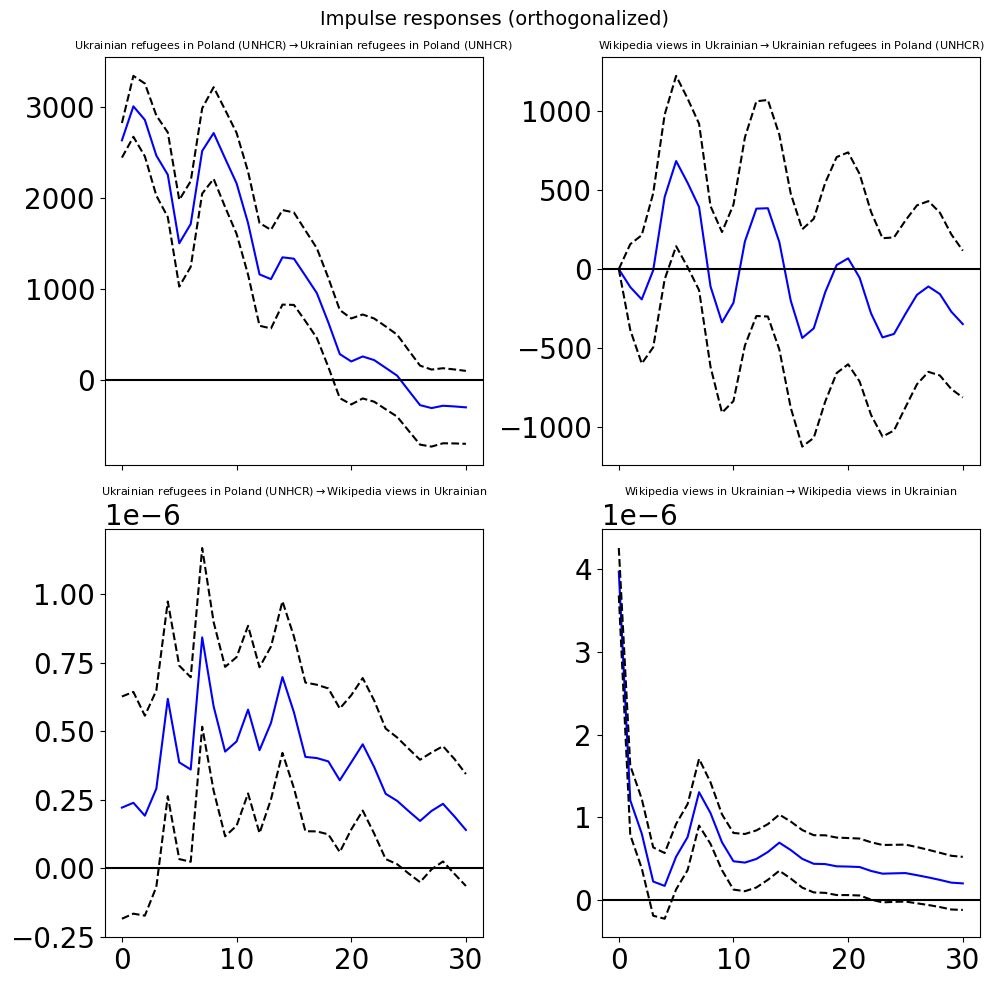

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    5.2471   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    2.8956   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0039

Kielce
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -15.18      -15.16   2.548e-07      -15.17
1       -15.96      -15.90   1.167e-07      -15.94
2       -16.02     -15.91*   1.106e-07      -15.97
3       -16.01      -15.86   1.111e-07      -15.95
4       -16.01      -15.81   1.118e-07      -15.93
5       -16.02      -15.77   1.106e-07      -15.92
6       -16.10      -15.81   1.017e-07     -15.99*
7       -16.08      -15.75   1.036e-07      -15.95
8      -16.11*      -15.74  1.005e-07*      -15.96
9       -16.10      -15.67   1.022e-07      -15.93
10      -16.08      -15.61   1.042e-07      -15.89
11      -16.06      -15.55   1.057e-07      -15.86
12      -16.05      -15.49   1.073e-07      -15.83
13      -16.05      -15.45   1.075e-07      -15.81
14      -16.04      -15.40   1.079e-07      -15.79
15    

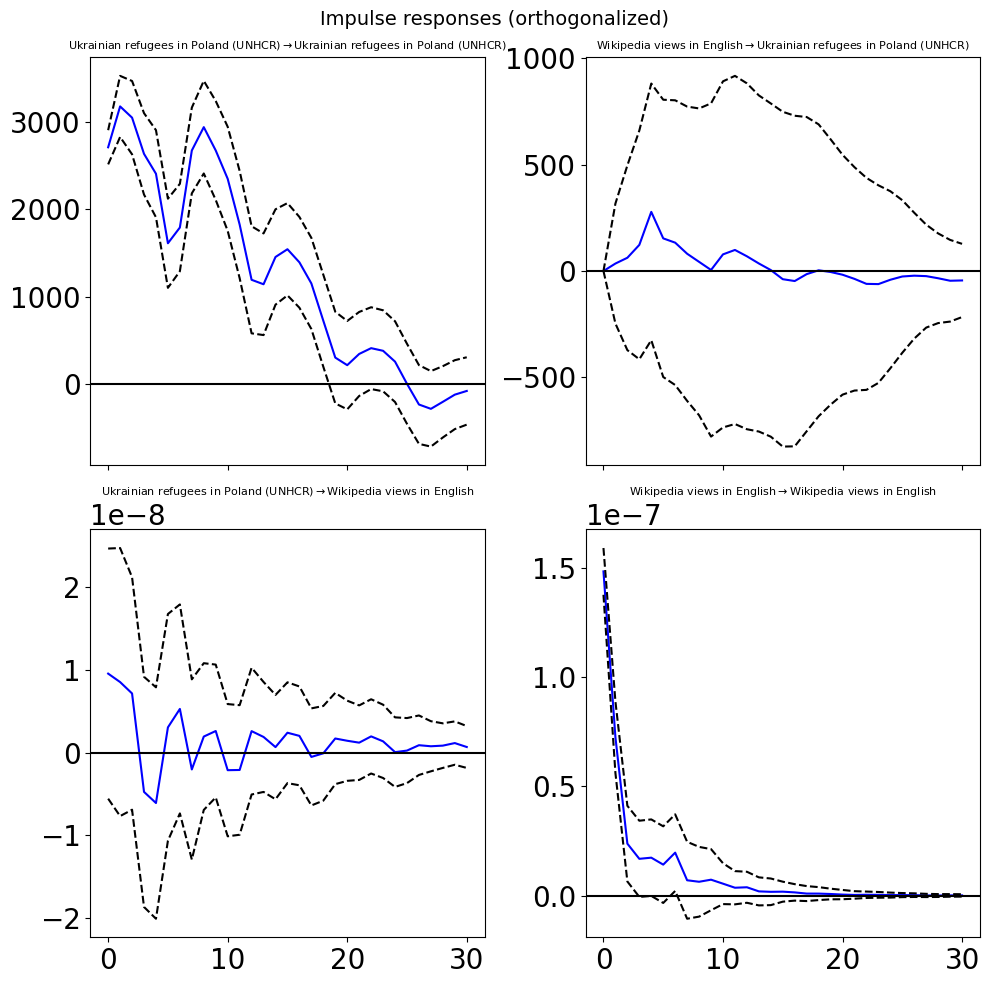

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.4695   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.3147   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.8774   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.9603

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.525      -6.502    0.001467      -6.516
1       -7.843      -7.776   0.0003927      -7.816
2       -7.953     -7.842*   0.0003515      -7.909
3       -7.960      -7.805   0.0003490      -7.899
4       -7.949      -7.749   0.0003531      -7.869
5       -7.976      -7.732   0.0003435      -7.879
6       -8.066      -7.778   0.0003140     -7.951*
7       -8.068      -7.736   0.0003133      -7.936
8      -8.096*      -7.719  0.0003047*      -7.946
9       -8.075      -7.653   0.0003113      -7.907
10      -8.058      -7.592   0.0003165      -7.873
11      -8.047      -7.537   0.0003202      -7.844
12      -8.039      -7.484   0.0003228      -7.818
13      -8.028      -7.429   0.0003265      -7.789
14      -8.038      -7.394   0.0003232      -7.782
15      -8.02

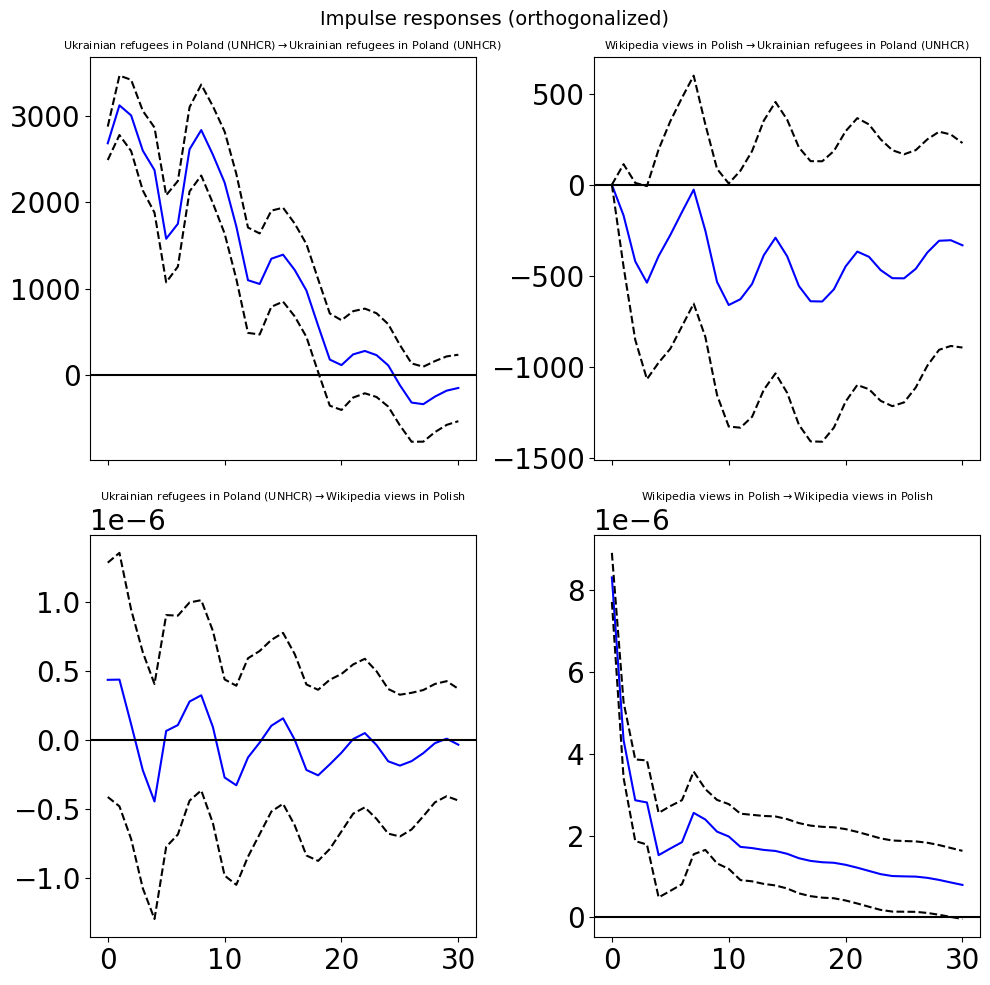

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.5343   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.0642   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.8306   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.3877

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -12.56      -12.54   3.500e-06      -12.55
1       -13.58      -13.51   1.268e-06      -13.55
2       -13.71     -13.60*   1.108e-06      -13.67
3       -13.74      -13.59   1.078e-06      -13.68
4       -13.73      -13.53   1.089e-06      -13.65
5       -13.74      -13.50   1.079e-06      -13.64
6       -13.84      -13.56   9.724e-07     -13.73*
7       -13.83      -13.49   9.888e-07      -13.69
8      -13.86*      -13.48  9.608e-07*      -13.71
9       -13.84      -13.42   9.754e-07      -13.67
10      -13.83      -13.37   9.818e-07      -13.65
11      -13.81      -13.30   1.001e-06      -13.61
12      -13.80      -13.24   1.019e-06      -13.58
13      -13.78      -13.18   1.035e-06      -13.54
14      -13.77      -13.13   1.042e-06      -13.52
15      -13.7

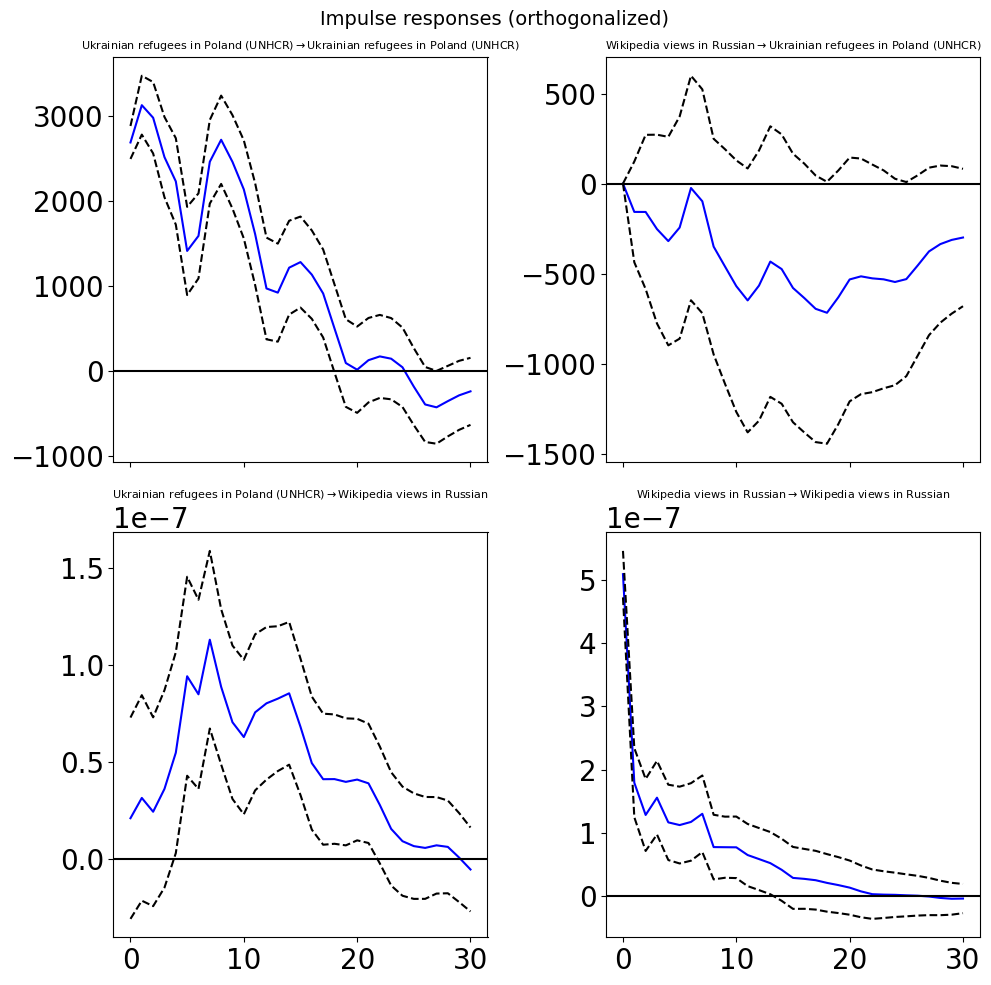

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    4.1887   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.9649   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0001   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.4632

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -8.906      -8.884   0.0001355      -8.897
1       -9.910      -9.844   4.966e-05      -9.884
2       -10.06     -9.951*   4.266e-05      -10.02
3       -10.08      -9.924   4.195e-05      -10.02
4       -10.10      -9.897   4.122e-05      -10.02
5       -10.14      -9.900   3.931e-05      -10.05
6       -10.22      -9.933   3.640e-05      -10.11
7       -10.22      -9.889   3.636e-05      -10.09
8      -10.26*      -9.883  3.501e-05*     -10.11*
9       -10.24      -9.820   3.567e-05      -10.07
10      -10.23      -9.766   3.600e-05      -10.05
11      -10.21      -9.703   3.669e-05      -10.01
12      -10.20      -9.646   3.715e-05      -9.980
13      -10.20      -9.597   3.733e-05      -9.958
14      -10.19      -9.544   3.767e-05      -9.931
15      -10.1

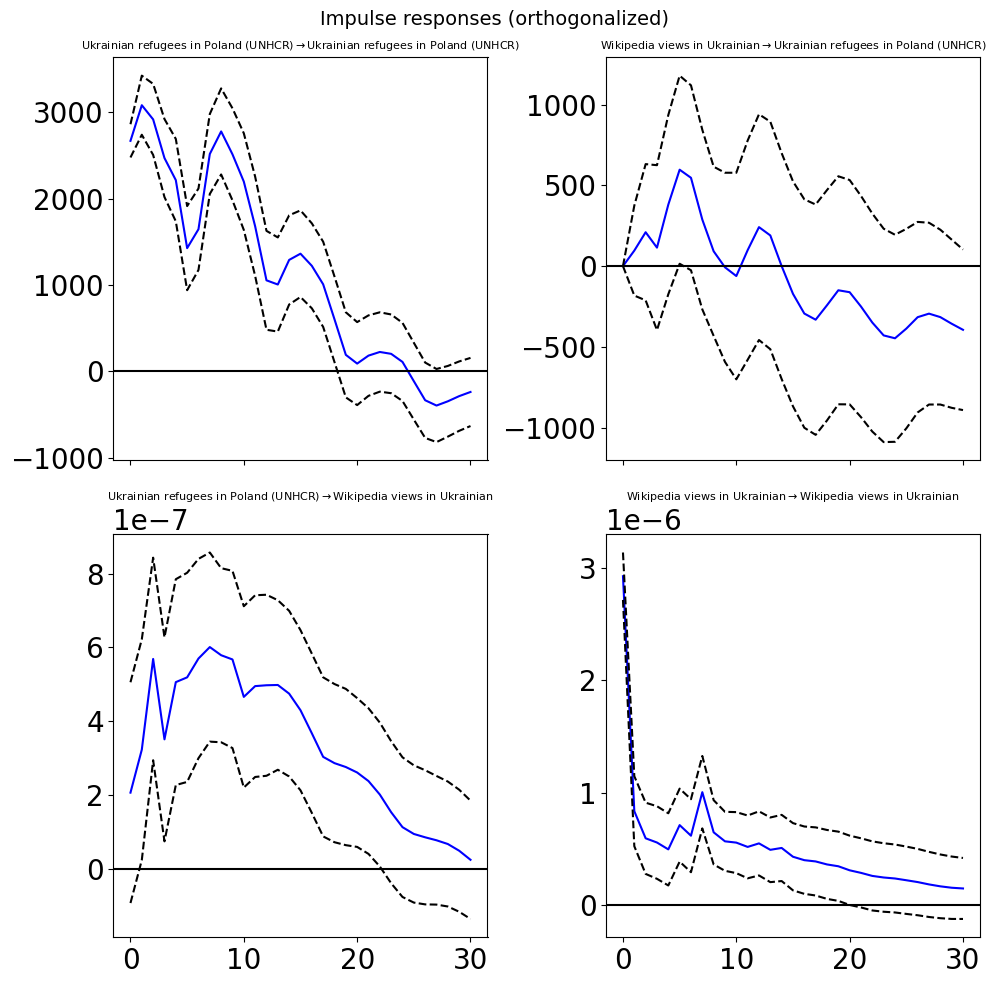

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    4.8039   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.5733   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1314

Sosnowiec
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -17.19      -17.17   3.407e-08      -17.19
1       -17.81      -17.75   1.838e-08      -17.79
2       -17.88     -17.77*   1.710e-08      -17.84
3       -17.91      -17.76   1.665e-08      -17.85
4       -17.92      -17.72   1.653e-08      -17.84
5       -17.93      -17.69   1.634e-08      -17.83
6       -18.03      -17.74   1.480e-08     -17.91*
7       -18.02      -17.69   1.496e-08      -17.89
8      -18.05*      -17.68  1.442e-08*      -17.90
9       -18.04      -17.62   1.460e-08      -17.87
10      -18.03      -17.56   1.484e-08      -17.84
11      -18.03      -17.52   1.476e-08      -17.83
12      -18.01      -17.46   1.503e-08      -17.79
13      -18.01      -17.41   1.505e-08      -17.77
14      -18.01      -17.36   1.516e-08      -17.75
15 

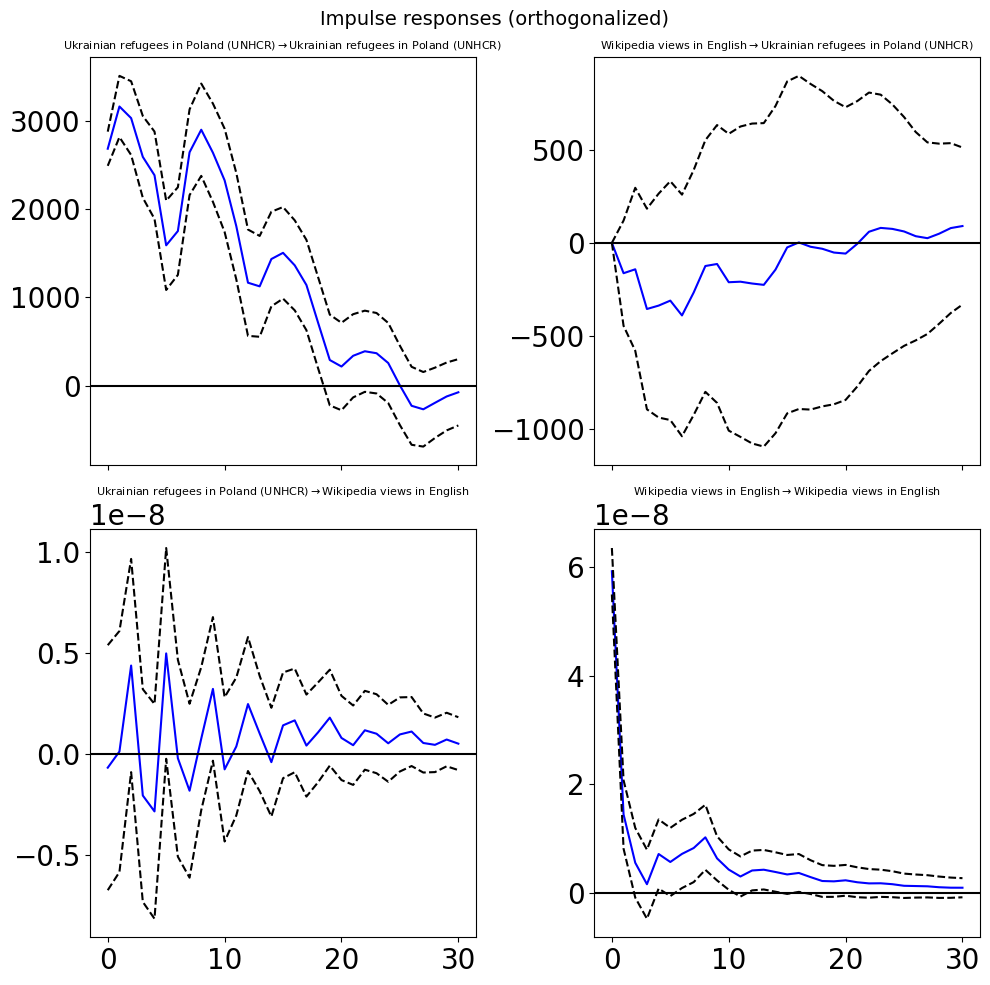

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    1.3295   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.8920   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.2275   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.5232

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -7.263      -7.241   0.0007008      -7.255
1       -8.312      -8.245   0.0002456      -8.285
2       -8.490     -8.379*   0.0002056      -8.446
3       -8.507      -8.352   0.0002020      -8.445
4       -8.522      -8.323   0.0001989      -8.443
5       -8.547      -8.303   0.0001941      -8.450
6       -8.664      -8.375   0.0001727      -8.549
7       -8.676      -8.343   0.0001706      -8.544
8      -8.720*      -8.343  0.0001633*     -8.570*
9       -8.702      -8.281   0.0001663      -8.534
10      -8.703      -8.237   0.0001662      -8.517
11      -8.698      -8.187   0.0001670      -8.495
12      -8.696      -8.141   0.0001674      -8.475
13      -8.676      -8.077   0.0001708      -8.437
14      -8.678      -8.035   0.0001704      -8.422
15      -8.66

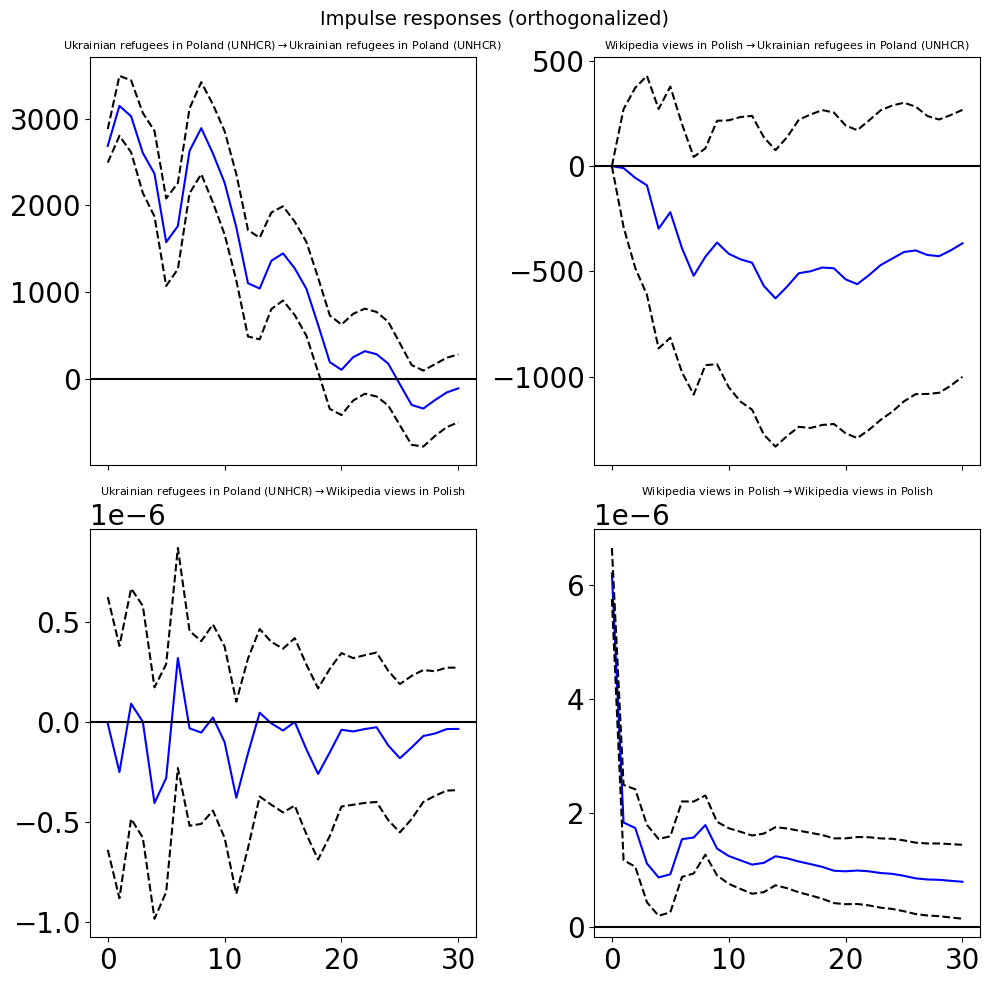

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.9291   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.9262   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.4923   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.4947

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -13.40      -13.38   1.512e-06      -13.39
1       -14.20      -14.13   6.809e-07      -14.17
2       -14.31     -14.20*   6.100e-07      -14.27
3       -14.32      -14.16   6.067e-07      -14.25
4       -14.33      -14.13   5.992e-07      -14.25
5       -14.33      -14.09   5.964e-07      -14.24
6       -14.42      -14.13   5.472e-07     -14.30*
7       -14.40      -14.07   5.553e-07      -14.27
8      -14.44*      -14.07  5.344e-07*      -14.29
9       -14.43      -14.01   5.428e-07      -14.26
10      -14.41      -13.95   5.504e-07      -14.23
11      -14.41      -13.90   5.545e-07      -14.20
12      -14.39      -13.83   5.635e-07      -14.17
13      -14.39      -13.79   5.625e-07      -14.15
14      -14.37      -13.73   5.720e-07      -14.12
15      -14.3

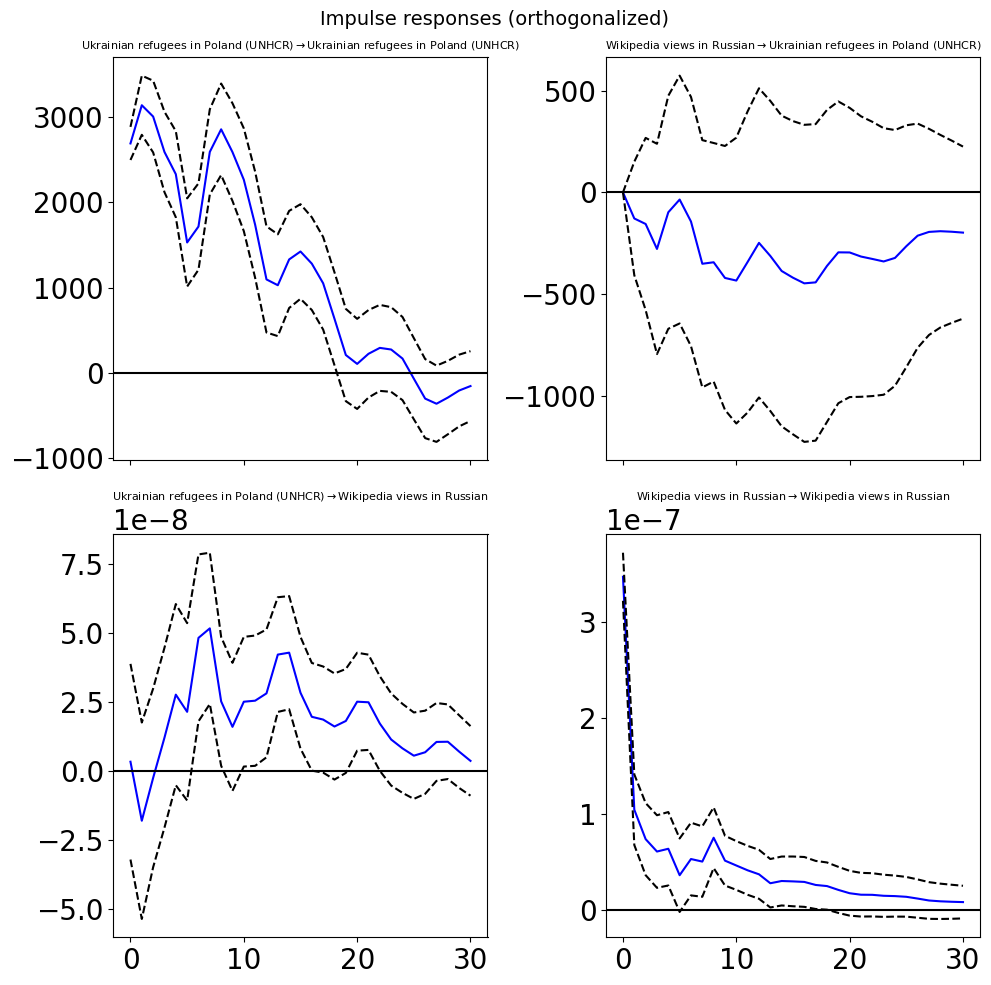

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    3.5258   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.7752   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0006   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.6248

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -9.937      -9.915   4.836e-05      -9.928
1       -10.64      -10.57   2.397e-05      -10.61
2       -10.71      -10.60   2.236e-05      -10.66
3       -10.74      -10.59   2.156e-05      -10.68
4       -10.77      -10.57   2.109e-05      -10.69
5       -10.81      -10.56   2.029e-05      -10.71
6       -10.89     -10.60*   1.869e-05     -10.77*
7       -10.89      -10.55   1.870e-05      -10.75
8      -10.92*      -10.54  1.811e-05*      -10.77
9       -10.90      -10.48   1.841e-05      -10.74
10      -10.89      -10.42   1.872e-05      -10.70
11      -10.88      -10.37   1.875e-05      -10.68
12      -10.88      -10.32   1.893e-05      -10.65
13      -10.91      -10.31   1.828e-05      -10.67
14      -10.91      -10.27   1.831e-05      -10.65
15      -10.9

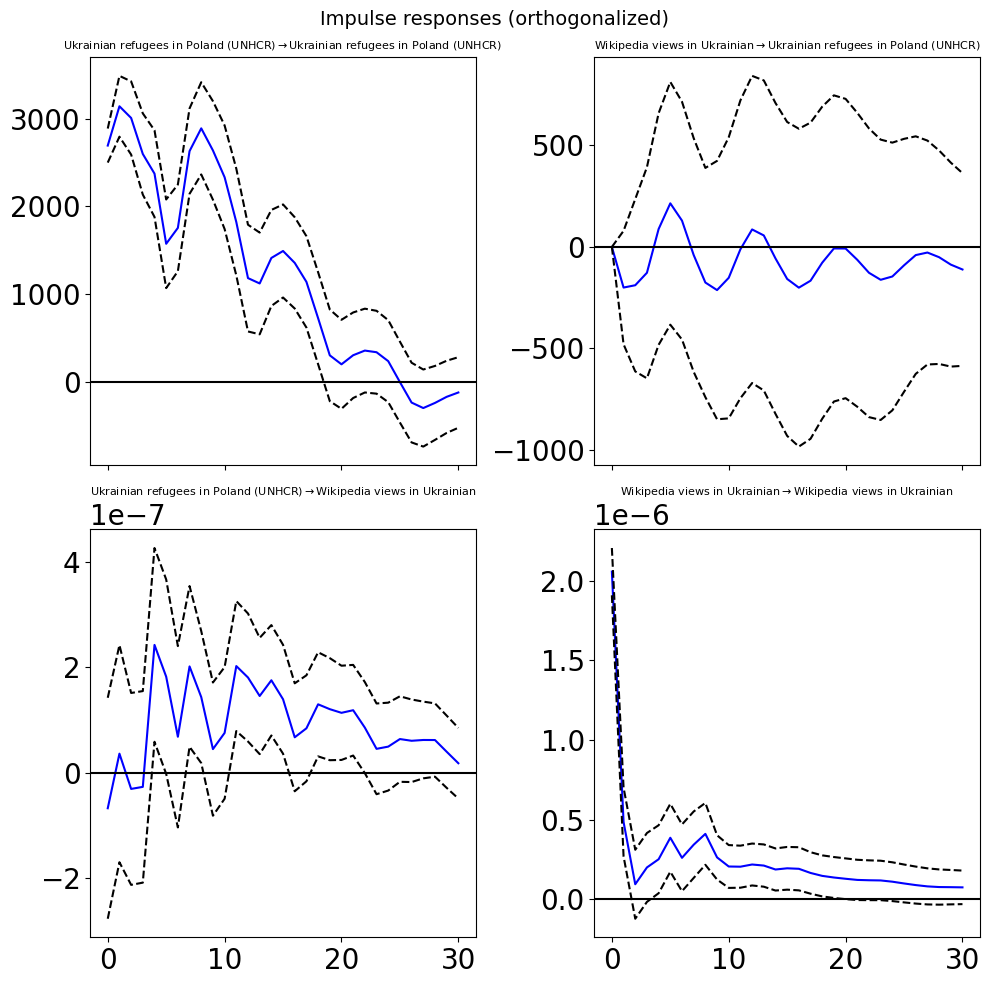

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    2.8566   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.6925   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0043   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.6982

Katowice
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -12.67      -12.64   3.154e-06      -12.66
1       -13.85      -13.78   9.697e-07      -13.82
2       -13.92     -13.81*   8.985e-07     -13.88*
3       -13.91      -13.75   9.118e-07      -13.85
4       -13.91      -13.71   9.142e-07      -13.83
5       -13.91      -13.66   9.110e-07      -13.81
6       -13.99      -13.70   8.405e-07      -13.87
7       -13.97      -13.64   8.575e-07      -13.84
8      -13.99*      -13.62  8.365e-07*      -13.84
9       -13.97      -13.55   8.553e-07      -13.80
10      -13.96      -13.49   8.665e-07      -13.77
11      -13.94      -13.43   8.797e-07      -13.74
12      -13.94      -13.39   8.818e-07      -13.72
13      -13.94      -13.34   8.857e-07      -13.70
14      -13.93      -13.29   8.938e-07      -13.67
15  

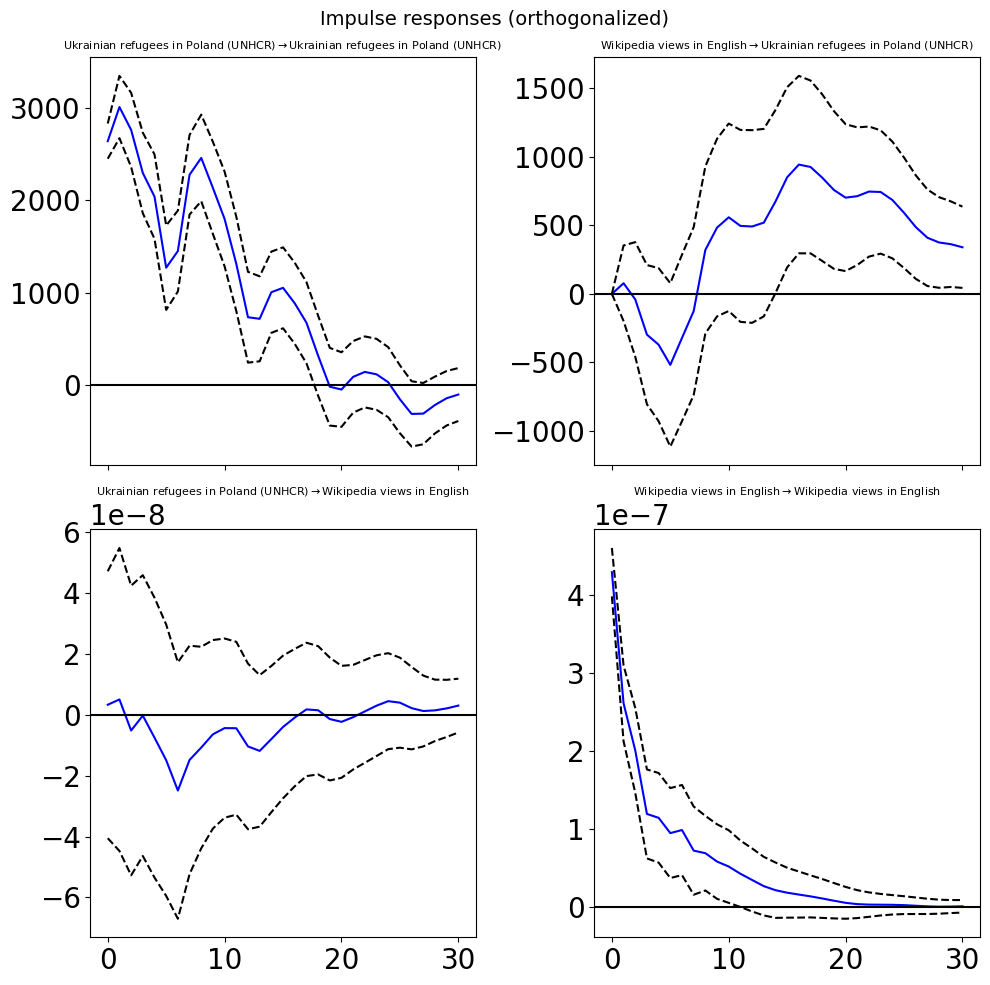

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.2359   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    2.5590   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.9840   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0101

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.570      -5.548    0.003810      -5.561
1       -6.545      -6.478    0.001437      -6.518
2       -6.604     -6.493*    0.001355      -6.560
3       -6.630      -6.474    0.001320      -6.568
4       -6.632      -6.432    0.001318      -6.552
5       -6.664      -6.420    0.001276      -6.567
6       -6.754      -6.466    0.001166     -6.639*
7       -6.739      -6.406    0.001184      -6.606
8      -6.779*      -6.402   0.001137*      -6.629
9       -6.766      -6.344    0.001153      -6.598
10      -6.755      -6.289    0.001165      -6.570
11      -6.748      -6.238    0.001174      -6.545
12      -6.742      -6.187    0.001181      -6.521
13      -6.742      -6.143    0.001181      -6.504
14      -6.728      -6.084    0.001198      -6.471
15      -6.71

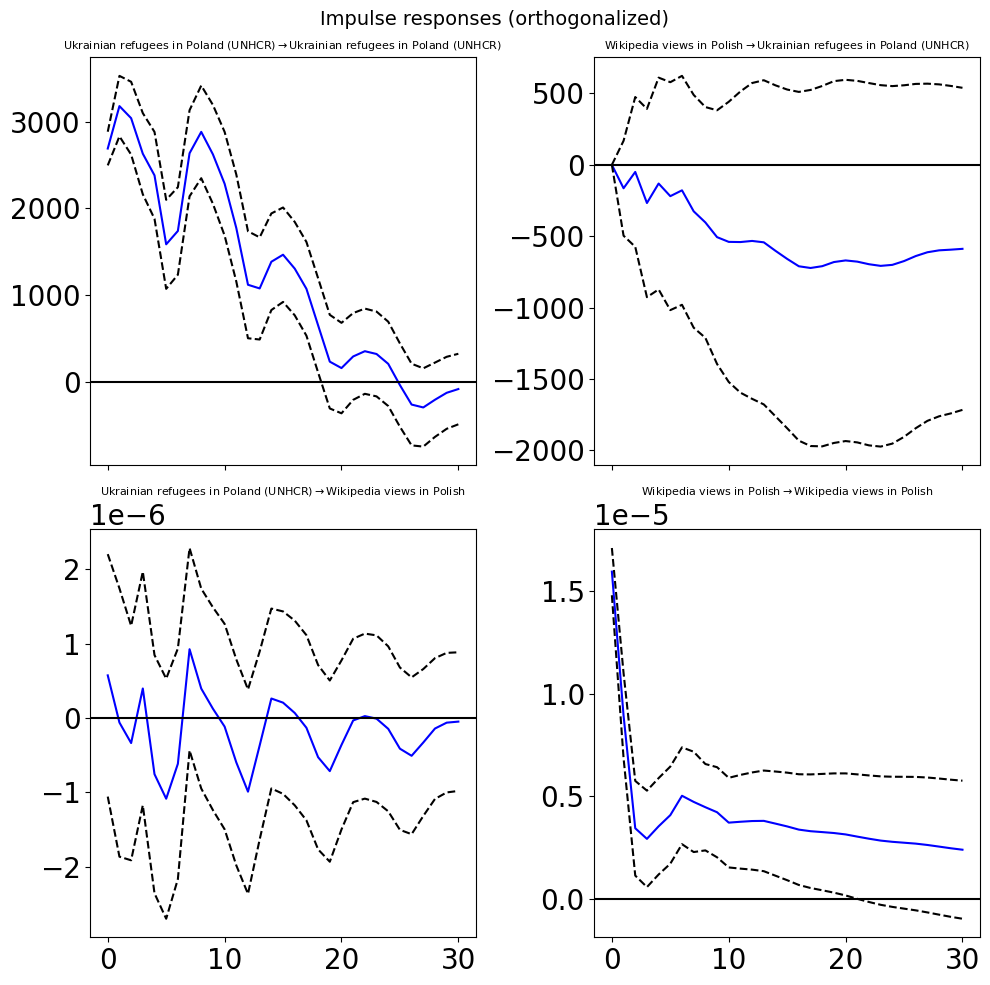

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.9634   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.8186   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.4645   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.5865

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -10.28      -10.25   3.447e-05      -10.27
1       -11.43      -11.37   1.081e-05      -11.41
2       -11.52     -11.41*   9.913e-06      -11.48
3       -11.52      -11.36   9.962e-06      -11.45
4       -11.55      -11.35   9.675e-06      -11.47
5       -11.60      -11.36   9.150e-06      -11.50
6       -11.69      -11.40   8.367e-06     -11.58*
7       -11.67      -11.34   8.506e-06      -11.54
8      -11.71*      -11.33  8.248e-06*      -11.56
9       -11.69      -11.26   8.414e-06      -11.52
10      -11.68      -11.21   8.499e-06      -11.49
11      -11.66      -11.15   8.632e-06      -11.46
12      -11.65      -11.10   8.711e-06      -11.43
13      -11.64      -11.05   8.770e-06      -11.41
14      -11.65      -11.01   8.694e-06      -11.40
15      -11.6

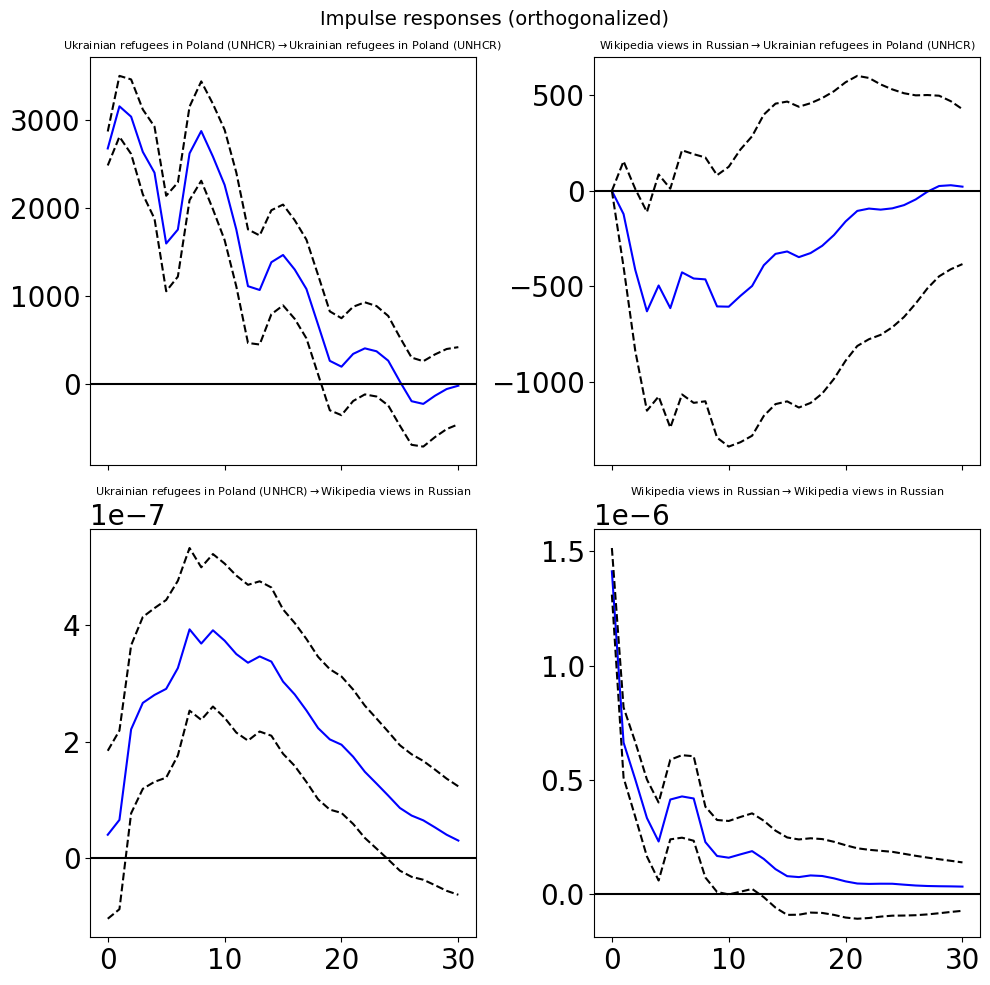

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    5.9935   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.3781   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.2047

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -7.017      -6.994   0.0008970      -7.008
1       -8.263      -8.197   0.0002579      -8.237
2       -8.330      -8.220   0.0002411      -8.286
3       -8.360      -8.205   0.0002340      -8.298
4       -8.396      -8.196   0.0002258      -8.316
5       -8.415      -8.170   0.0002216      -8.317
6       -8.596     -8.308*   0.0001848      -8.482
7       -8.639      -8.307   0.0001770      -8.507
8      -8.678*      -8.301  0.0001703*     -8.528*
9       -8.666      -8.245   0.0001724      -8.498
10      -8.664      -8.198   0.0001728      -8.478
11      -8.657      -8.146   0.0001740      -8.453
12      -8.658      -8.103   0.0001738      -8.437
13      -8.666      -8.067   0.0001725      -8.427
14      -8.673      -8.030   0.0001712      -8.417
15      -8.67

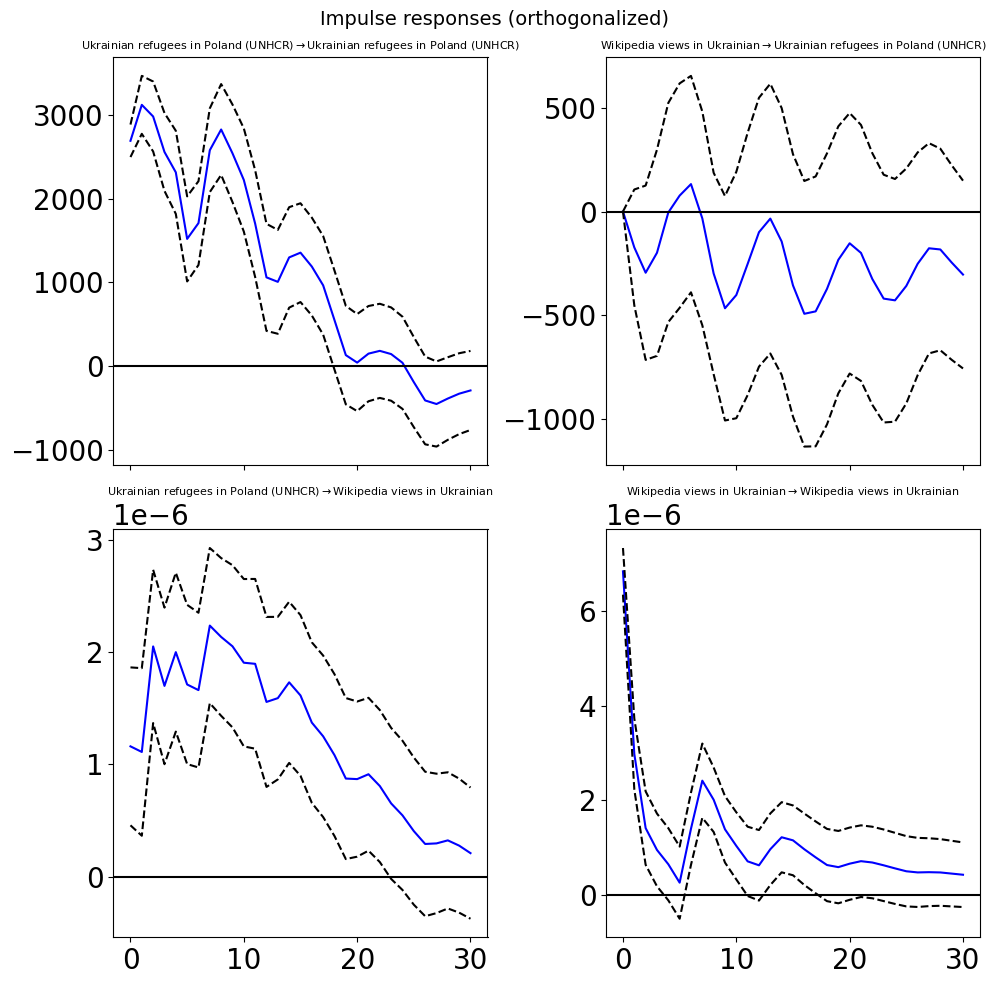

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    8.7256   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.8625   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.5484

Bydgoszcz
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -15.07      -15.05   2.841e-07      -15.07
1       -15.77      -15.70   1.417e-07      -15.74
2       -15.84     -15.73*   1.322e-07      -15.79
3       -15.83      -15.67   1.339e-07      -15.76
4       -15.82      -15.62   1.348e-07      -15.74
5       -15.85      -15.60   1.310e-07      -15.75
6       -15.92      -15.63   1.219e-07     -15.80*
7       -15.91      -15.58   1.229e-07      -15.78
8      -15.94*      -15.56  1.198e-07*      -15.79
9       -15.92      -15.50   1.219e-07      -15.75
10      -15.91      -15.44   1.234e-07      -15.72
11      -15.90      -15.39   1.241e-07      -15.70
12      -15.90      -15.35   1.239e-07      -15.68
13      -15.90      -15.30   1.249e-07      -15.66
14      -15.89      -15.25   1.253e-07      -15.64
15 

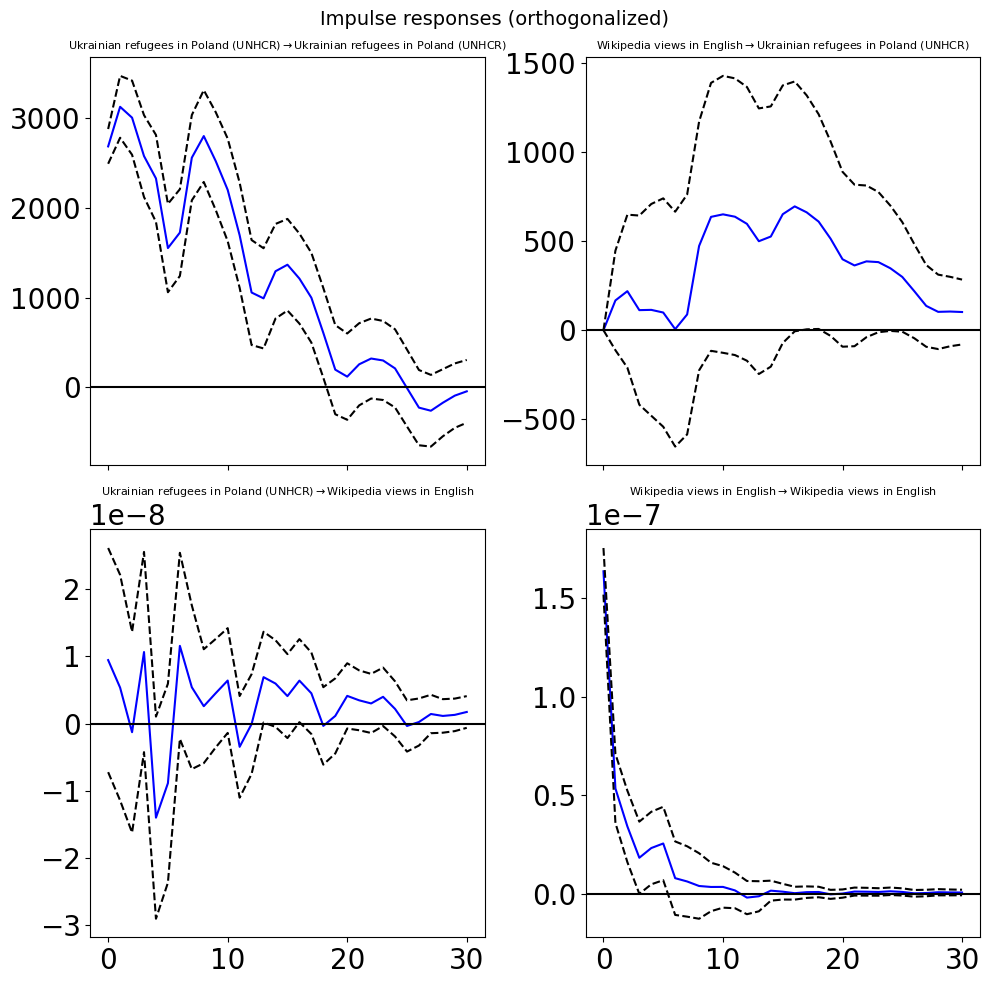

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    1.9953   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.0113   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.0462   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.4270

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.617      -5.595    0.003636      -5.608
1       -6.790      -6.724    0.001125      -6.764
2       -6.858     -6.747*    0.001051      -6.814
3       -6.877      -6.722    0.001031      -6.815
4       -6.893      -6.693    0.001015      -6.813
5       -6.915      -6.671   0.0009933      -6.817
6       -6.986      -6.698   0.0009247     -6.871*
7       -6.986      -6.653   0.0009253      -6.853
8      -7.016*      -6.639  0.0008978*      -6.866
9       -7.009      -6.587   0.0009040      -6.841
10      -7.014      -6.548   0.0008998      -6.828
11      -7.001      -6.490   0.0009117      -6.797
12      -6.981      -6.427   0.0009295      -6.761
13      -6.970      -6.371   0.0009405      -6.731
14      -6.962      -6.319   0.0009477      -6.706
15      -6.96

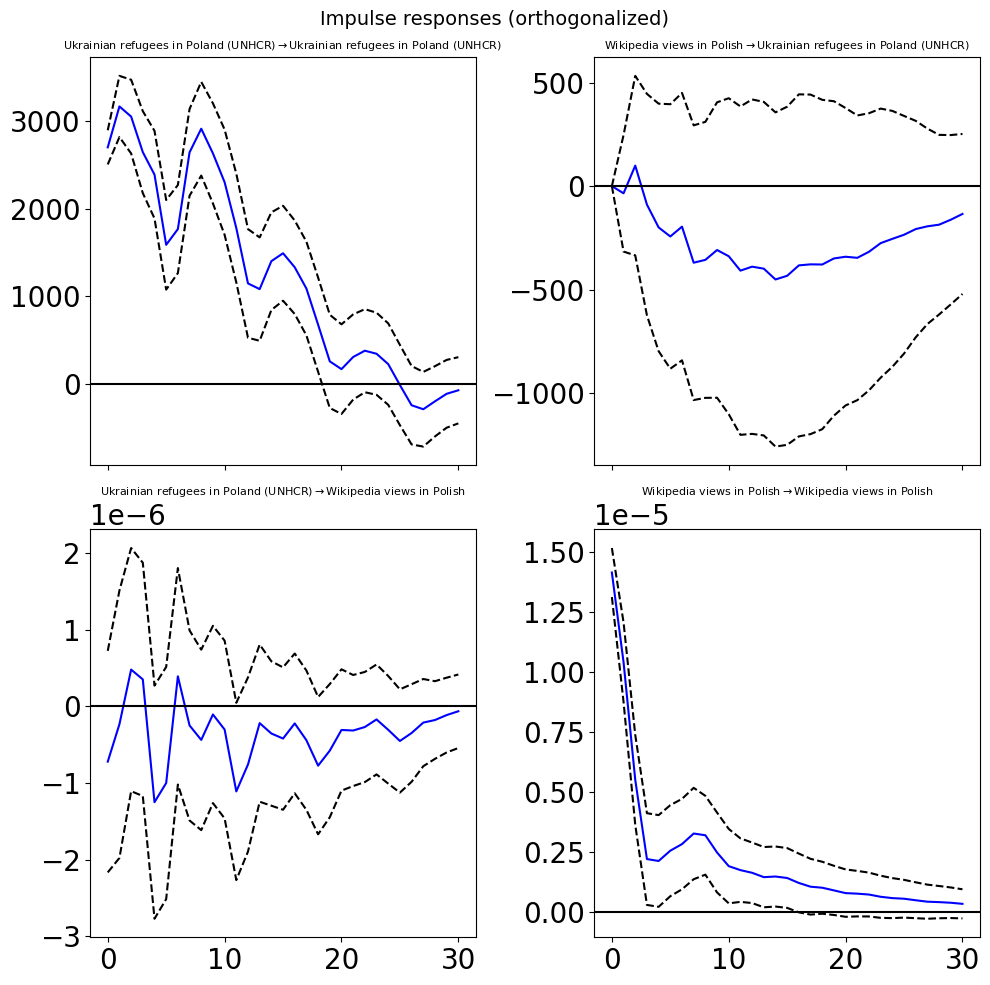

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    1.2281   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.6402   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.2813   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.7438

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -11.16      -11.14   1.419e-05      -11.15
1       -12.02      -11.96   5.995e-06      -12.00
2       -12.20      -12.08   5.052e-06      -12.15
3       -12.22      -12.06   4.946e-06      -12.16
4       -12.25      -12.05   4.789e-06      -12.17
5       -12.26      -12.02   4.715e-06      -12.17
6       -12.38     -12.10*   4.187e-06      -12.27
7       -12.42      -12.09   4.042e-06      -12.29
8      -12.46*      -12.08  3.879e-06*     -12.31*
9       -12.44      -12.02   3.966e-06      -12.27
10      -12.45      -11.98   3.924e-06      -12.26
11      -12.43      -11.92   3.997e-06      -12.23
12      -12.43      -11.87   4.012e-06      -12.21
13      -12.42      -11.82   4.045e-06      -12.18
14      -12.40      -11.76   4.115e-06      -12.15
15      -12.4

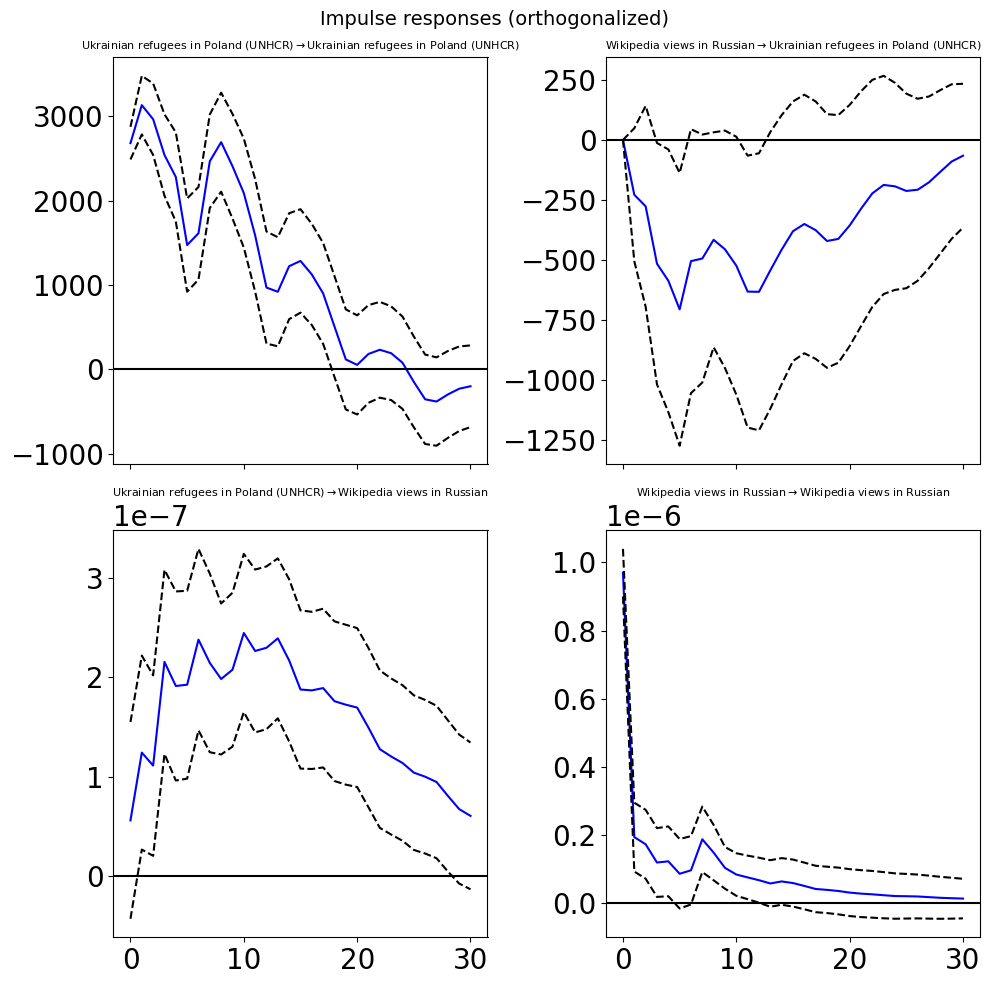

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                   10.3122   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.0845   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.3733

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -7.636      -7.614   0.0004829      -7.627
1       -8.931      -8.865   0.0001322      -8.905
2       -9.053      -8.942   0.0001171      -9.009
3       -9.117      -8.962   0.0001098      -9.055
4       -9.127      -8.928   0.0001086      -9.048
5       -9.160      -8.916   0.0001051      -9.063
6       -9.276     -8.988*   9.362e-05      -9.162
7       -9.292      -8.959   9.221e-05      -9.159
8      -9.334*      -8.957  8.836e-05*     -9.184*
9       -9.319      -8.898   8.970e-05      -9.151
10      -9.299      -8.833   9.155e-05      -9.113
11      -9.289      -8.778   9.250e-05      -9.086
12      -9.276      -8.721   9.368e-05      -9.055
13      -9.264      -8.665   9.482e-05      -9.026
14      -9.294      -8.650   9.208e-05      -9.037
15      -9.28

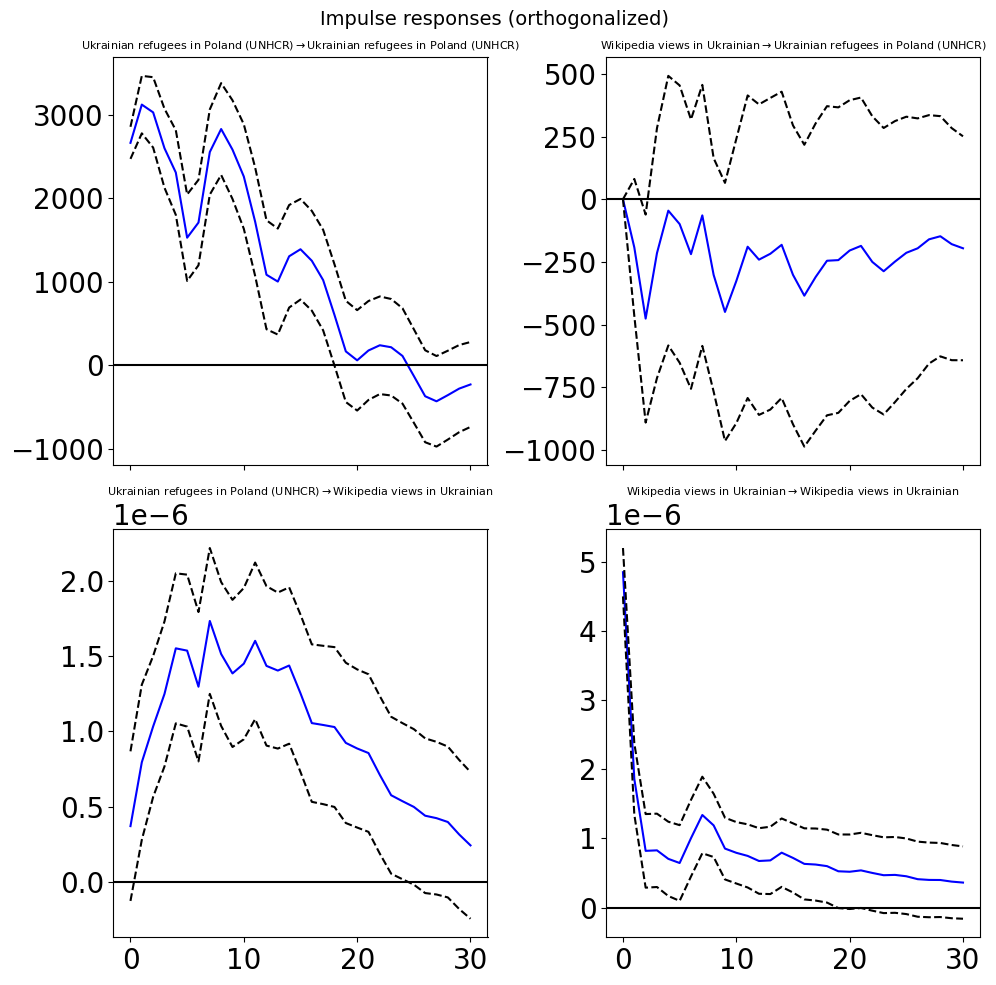

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                   10.3689   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.7059   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0957

Łódź
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -12.72      -12.70   2.984e-06      -12.71
1       -13.32      -13.26   1.633e-06      -13.30
2       -13.39     -13.28*   1.534e-06      -13.34
3       -13.42      -13.26   1.487e-06      -13.36
4       -13.40      -13.20   1.509e-06      -13.32
5       -13.41      -13.16   1.507e-06      -13.31
6       -13.49      -13.20   1.383e-06     -13.38*
7       -13.47      -13.14   1.412e-06      -13.34
8      -13.51*      -13.13  1.360e-06*      -13.36
9       -13.49      -13.07   1.388e-06      -13.32
10      -13.47      -13.01   1.407e-06      -13.29
11      -13.46      -12.95   1.429e-06      -13.26
12      -13.45      -12.89   1.445e-06      -13.23
13      -13.44      -12.84   1.461e-06      -13.20
14      -13.45      -12.81   1.443e-06      -13.19
15      

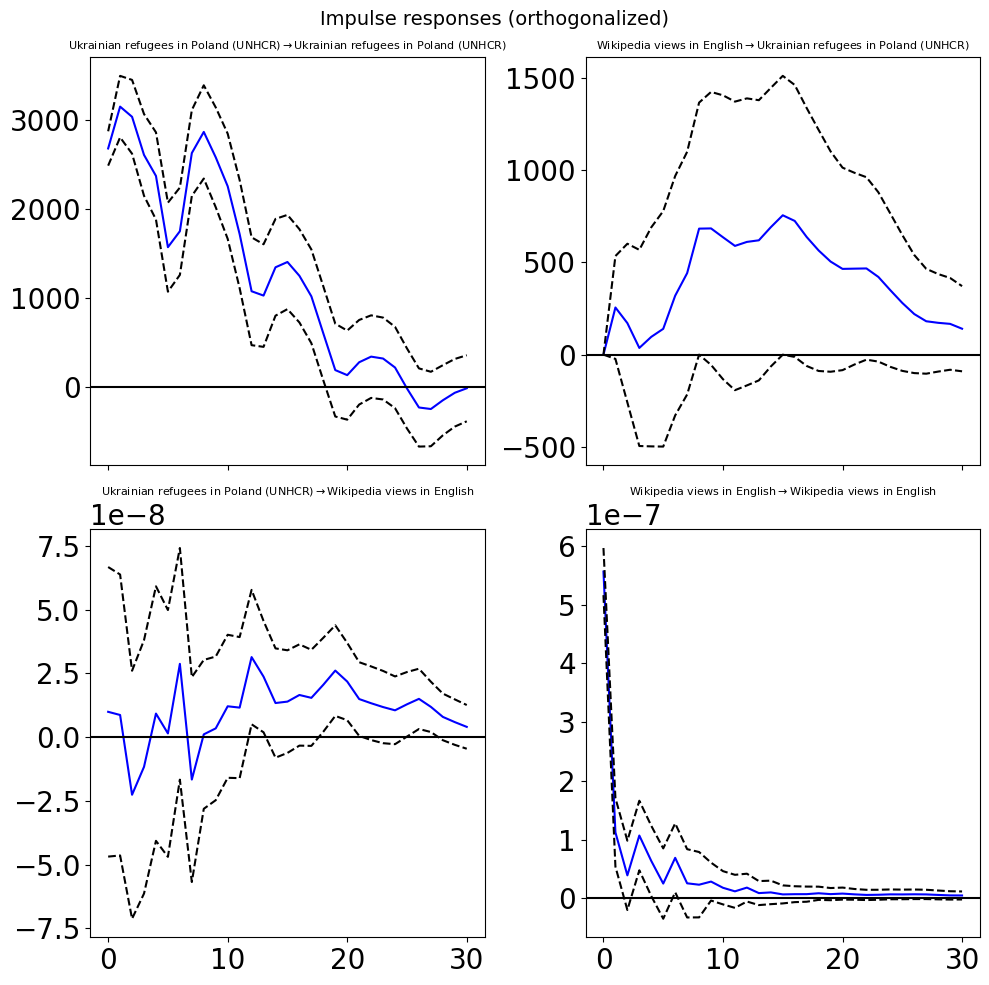

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    1.2138   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.2484   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.2897   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.2698

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.247      -5.225    0.005262      -5.238
1       -6.318      -6.251    0.001804      -6.291
2       -6.385     -6.274*    0.001687      -6.340
3       -6.393      -6.238    0.001673      -6.332
4       -6.388      -6.189    0.001681      -6.309
5       -6.396      -6.151    0.001669      -6.298
6       -6.477      -6.189    0.001538     -6.362*
7       -6.473      -6.140    0.001545      -6.340
8      -6.503*      -6.126   0.001499*      -6.353
9       -6.487      -6.066    0.001523      -6.320
10      -6.476      -6.010    0.001540      -6.291
11      -6.460      -5.950    0.001566      -6.257
12      -6.444      -5.889    0.001591      -6.223
13      -6.446      -5.847    0.001587      -6.208
14      -6.436      -5.792    0.001605      -6.180
15      -6.42

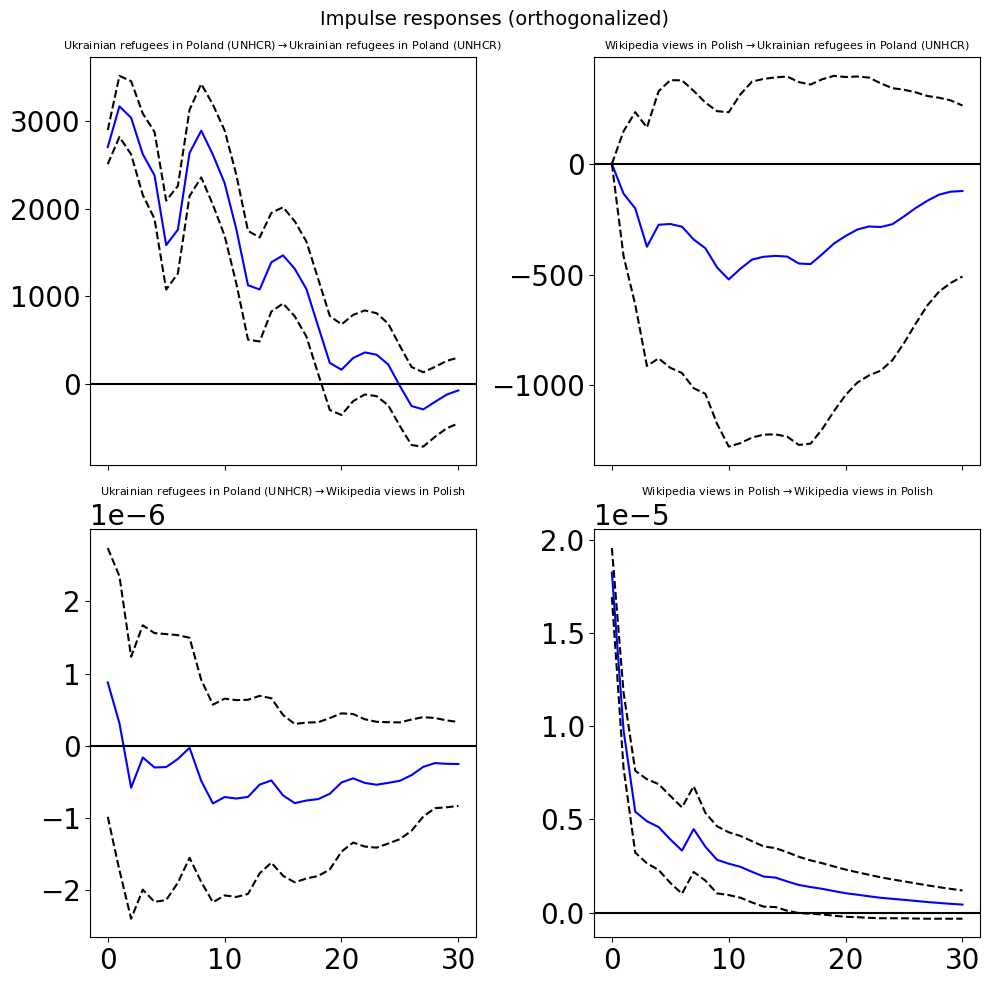

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.3698   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.4640   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.9361   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.8811

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -10.03      -10.01   4.401e-05      -10.02
1       -10.81      -10.74   2.028e-05      -10.78
2       -10.89     -10.78*   1.863e-05      -10.85
3       -10.92      -10.76   1.817e-05      -10.85
4       -10.91      -10.71   1.832e-05      -10.83
5       -10.91      -10.67   1.828e-05      -10.81
6       -10.99      -10.70   1.695e-05     -10.87*
7       -10.97      -10.63   1.730e-05      -10.83
8      -11.01*      -10.63  1.658e-05*      -10.86
9       -11.00      -10.57   1.678e-05      -10.83
10      -10.98      -10.52   1.698e-05      -10.80
11      -10.96      -10.45   1.730e-05      -10.76
12      -10.95      -10.40   1.757e-05      -10.73
13      -10.93      -10.34   1.784e-05      -10.70
14      -10.92      -10.28   1.804e-05      -10.67
15      -10.9

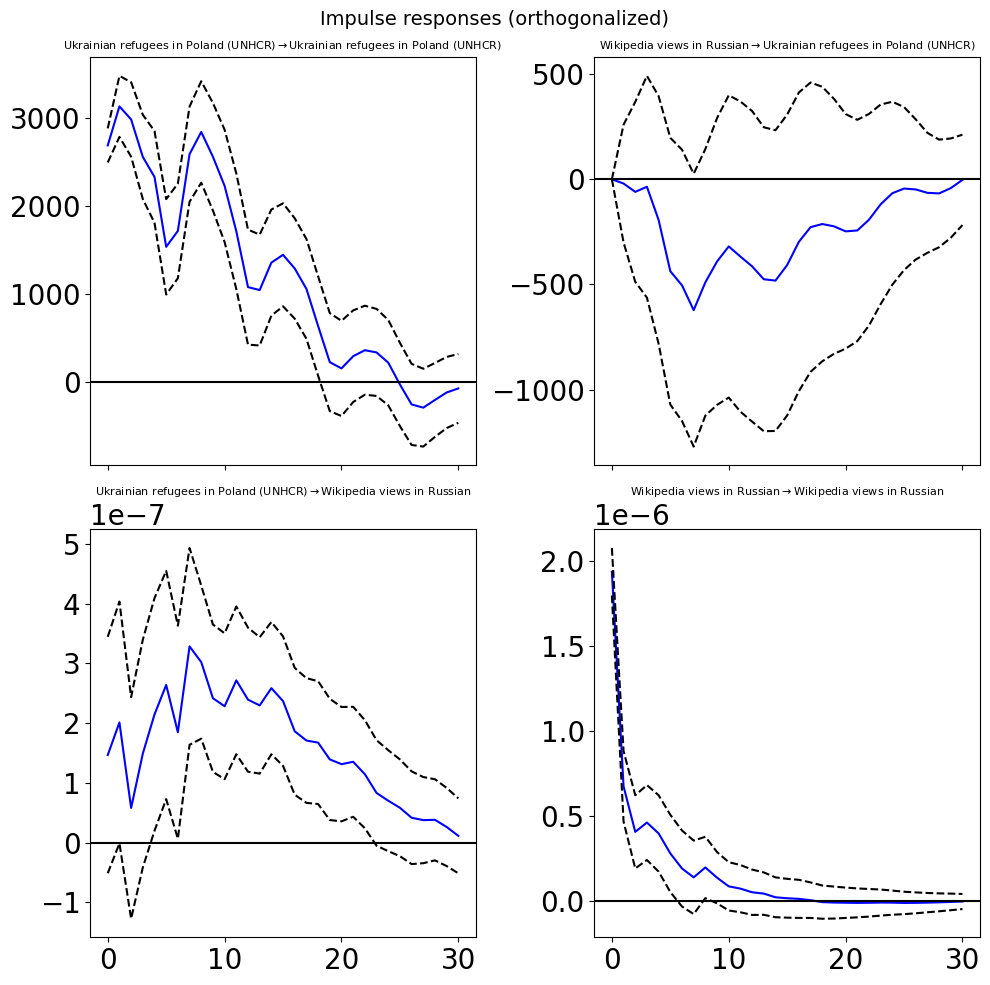

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    4.5082   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.7553   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.6425

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.872      -5.849    0.002818      -5.863
1       -6.896      -6.829    0.001012      -6.870
2       -7.044     -6.933*   0.0008725      -7.000
3       -7.078      -6.923   0.0008432      -7.017
4       -7.066      -6.866   0.0008536      -6.987
5       -7.071      -6.826   0.0008498      -6.973
6       -7.161      -6.873   0.0007763     -7.046*
7       -7.144      -6.812   0.0007894      -7.012
8      -7.171*      -6.793  0.0007690*      -7.020
9       -7.151      -6.729   0.0007844      -6.983
10      -7.132      -6.667   0.0007990      -6.947
11      -7.123      -6.613   0.0008063      -6.920
12      -7.116      -6.561   0.0008124      -6.895
13      -7.100      -6.501   0.0008254      -6.862
14      -7.094      -6.451   0.0008304      -6.838
15      -7.09

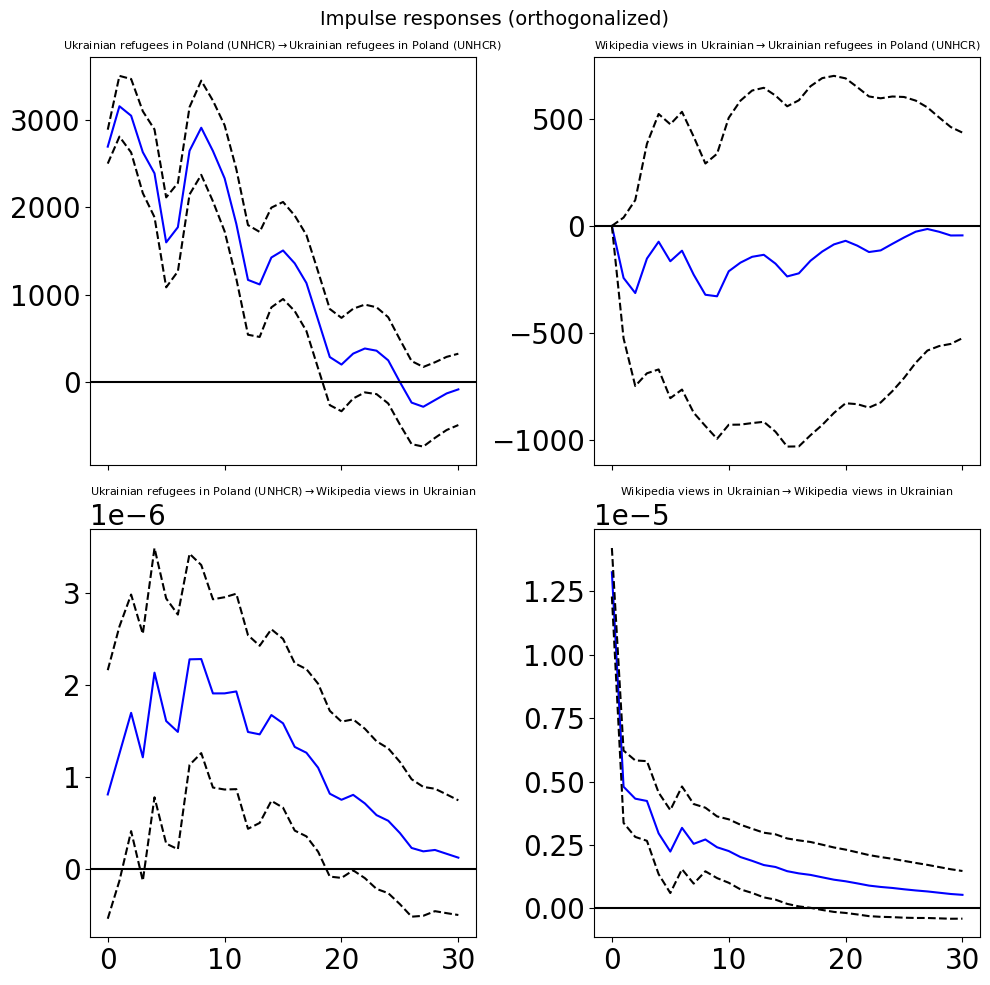

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    2.7142   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.6544   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0065   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.7316

Gdańsk
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -9.925      -9.903   4.891e-05      -9.917
1       -10.50      -10.44   2.745e-05      -10.48
2       -10.56     -10.45*   2.599e-05      -10.51
3       -10.58      -10.42   2.546e-05      -10.52
4       -10.57      -10.37   2.559e-05      -10.49
5       -10.58      -10.33   2.552e-05      -10.48
6       -10.65      -10.36   2.366e-05      -10.54
7       -10.69      -10.36   2.270e-05      -10.56
8      -10.78*      -10.40  2.084e-05*     -10.63*
9       -10.76      -10.34   2.125e-05      -10.59
10      -10.74      -10.28   2.160e-05      -10.56
11      -10.72      -10.21   2.209e-05      -10.52
12      -10.71      -10.15   2.235e-05      -10.49
13      -10.69      -10.09   2.275e-05      -10.45
14      -10.70      -10.06   2.258e-05      -10.44
15    

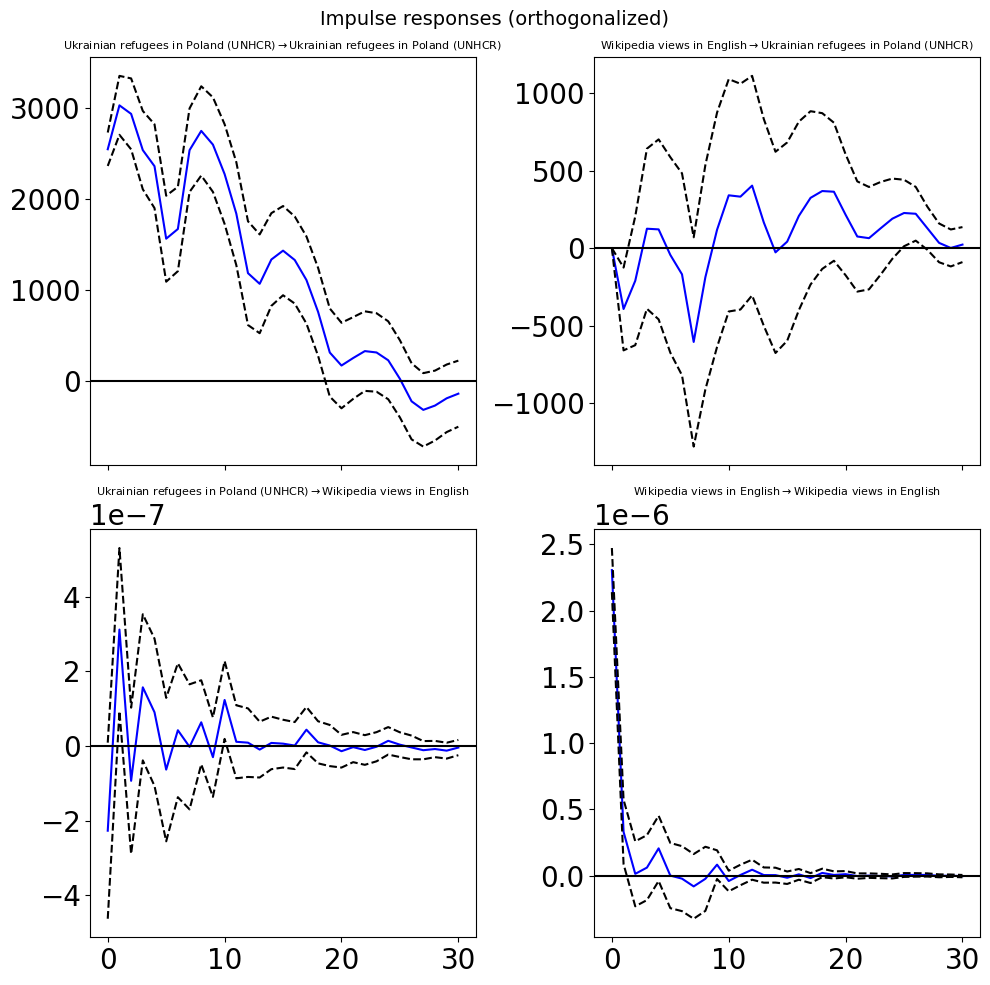

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    2.0272   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    6.0599   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.0425   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0000

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.294      -5.272    0.005021      -5.285
1       -6.757      -6.691    0.001162      -6.731
2       -6.869      -6.759    0.001039      -6.825
3       -6.951      -6.795   0.0009579      -6.889
4       -6.983      -6.783   0.0009276      -6.903
5       -7.007      -6.763   0.0009054      -6.910
6       -7.101     -6.813*   0.0008239      -6.987
7       -7.104      -6.771   0.0008220      -6.971
8      -7.141*      -6.763  0.0007924*     -6.990*
9       -7.123      -6.701   0.0008068      -6.955
10      -7.104      -6.638   0.0008221      -6.918
11      -7.098      -6.587   0.0008273      -6.895
12      -7.082      -6.527   0.0008406      -6.861
13      -7.069      -6.469   0.0008520      -6.830
14      -7.060      -6.416   0.0008596      -6.804
15      -7.05

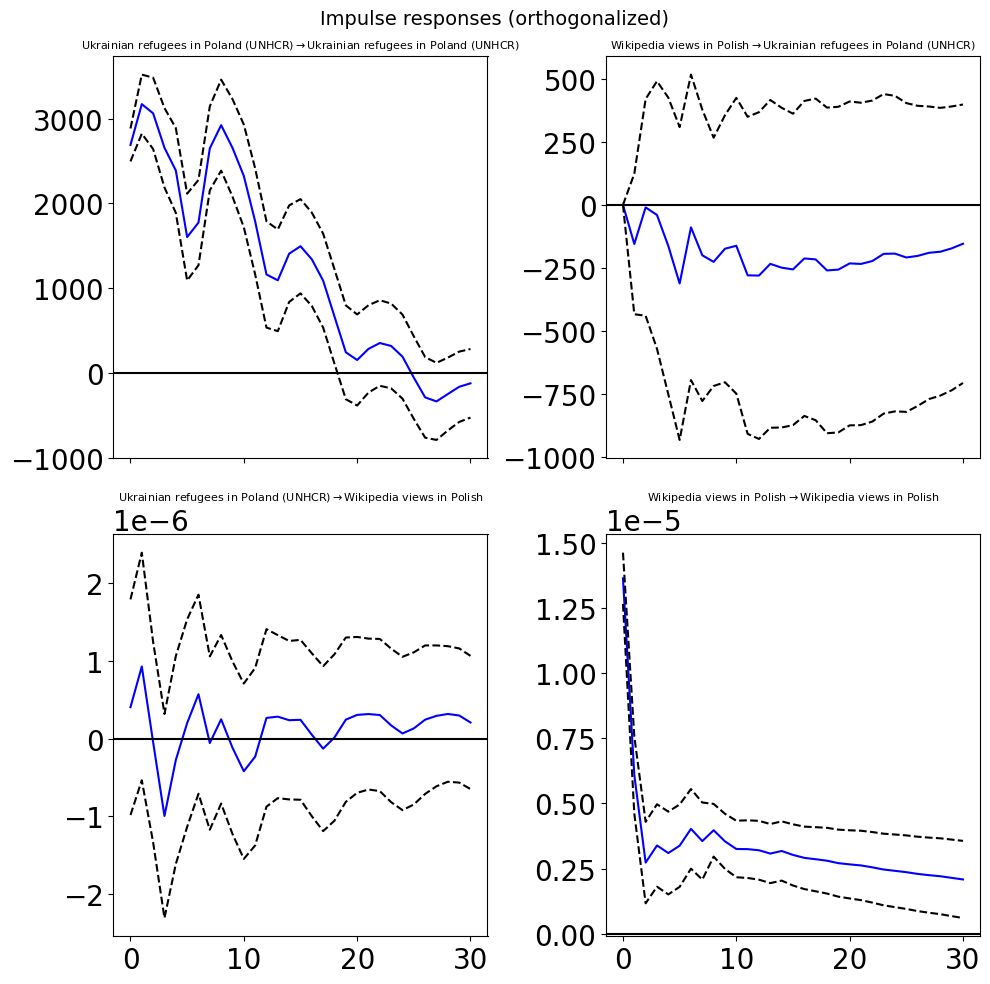

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.7811   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.9126   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.6196   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.5060

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -8.232      -8.210   0.0002659      -8.223
1       -9.589      -9.522   6.848e-05      -9.562
2       -9.646     -9.535*   6.471e-05      -9.601
3       -9.689      -9.534   6.193e-05      -9.628
4       -9.695      -9.495   6.160e-05      -9.615
5       -9.698      -9.454   6.143e-05      -9.601
6       -9.804      -9.516   5.521e-05      -9.690
7       -9.793      -9.460   5.585e-05      -9.660
8       -9.826      -9.449   5.401e-05      -9.676
9       -9.862      -9.441   5.211e-05      -9.695
10      -9.886      -9.420   5.088e-05      -9.701
11      -9.924      -9.414   4.899e-05     -9.721*
12      -9.912      -9.357   4.961e-05      -9.691
13      -9.925      -9.326   4.897e-05      -9.686
14      -9.916      -9.273   4.941e-05      -9.660
15      -9.93

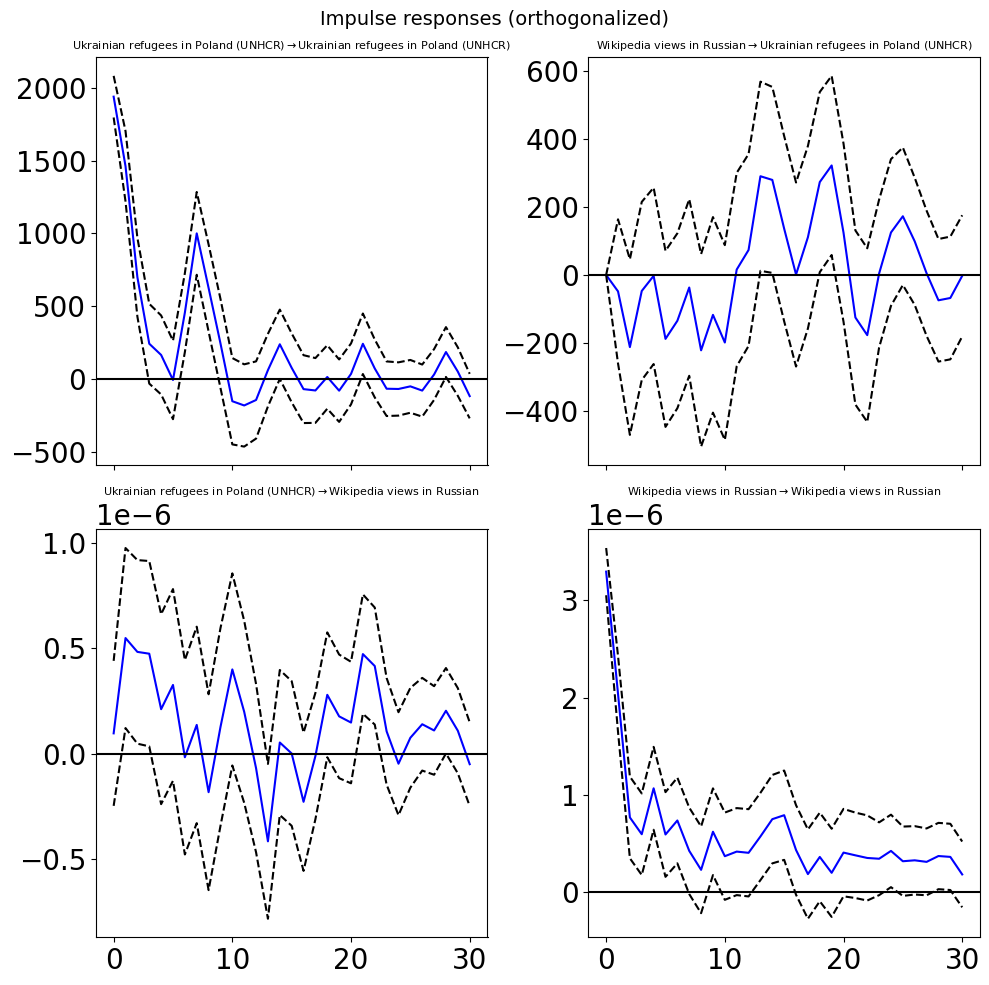

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
23                                   3.9712   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
23                                   1.6555   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
23                                   0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
23                                   0.0317

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.747      -5.724    0.003194      -5.738
1       -6.920      -6.853   0.0009880      -6.893
2       -7.087      -6.976   0.0008356      -7.043
3       -7.183      -7.027   0.0007598      -7.121
4       -7.265      -7.065   0.0006998      -7.185
5       -7.296      -7.052   0.0006782      -7.199
6       -7.382     -7.094*   0.0006224      -7.267
7       -7.419      -7.086   0.0005999      -7.286
8      -7.451*      -7.074  0.0005811*     -7.301*
9       -7.431      -7.009   0.0005929      -7.263
10      -7.424      -6.958   0.0005968      -7.239
11      -7.413      -6.902   0.0006038      -7.209
12      -7.399      -6.844   0.0006125      -7.178
13      -7.382      -6.783   0.0006227      -7.144
14      -7.368      -6.724   0.0006319      -7.111
15      -7.38

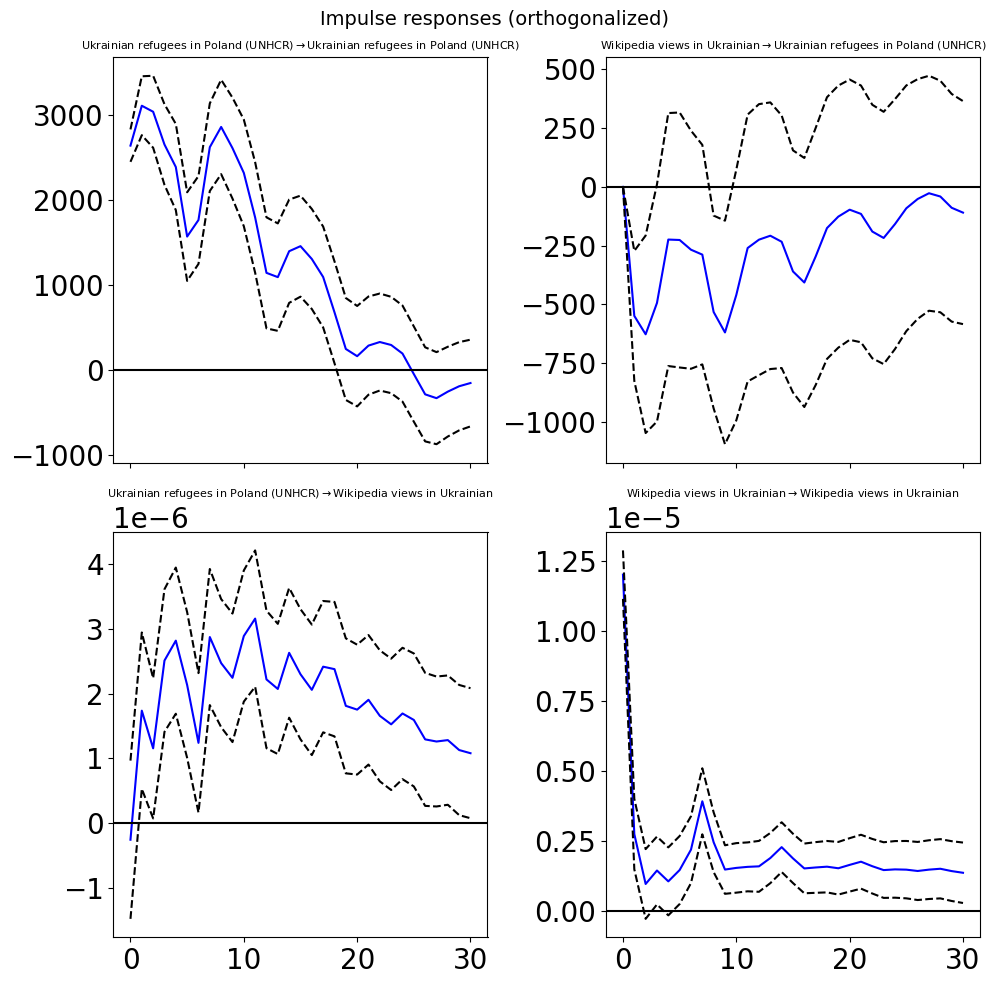

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    9.1071   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    2.4832   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0125

Szczecin
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -13.52      -13.50   1.337e-06      -13.52
1       -14.21      -14.14   6.761e-07      -14.18
2       -14.34     -14.23*   5.929e-07      -14.29
3       -14.36      -14.21   5.783e-07      -14.30
4       -14.36      -14.16   5.815e-07      -14.28
5       -14.38      -14.14   5.675e-07      -14.28
6       -14.46      -14.18   5.225e-07     -14.35*
7       -14.47      -14.13   5.217e-07      -14.33
8      -14.50*      -14.12  5.049e-07*      -14.35
9       -14.49      -14.07   5.100e-07      -14.32
10      -14.47      -14.00   5.194e-07      -14.29
11      -14.45      -13.94   5.289e-07      -14.25
12      -14.44      -13.88   5.367e-07      -14.22
13      -14.43      -13.83   5.398e-07      -14.19
14      -14.42      -13.78   5.476e-07      -14.16
15  

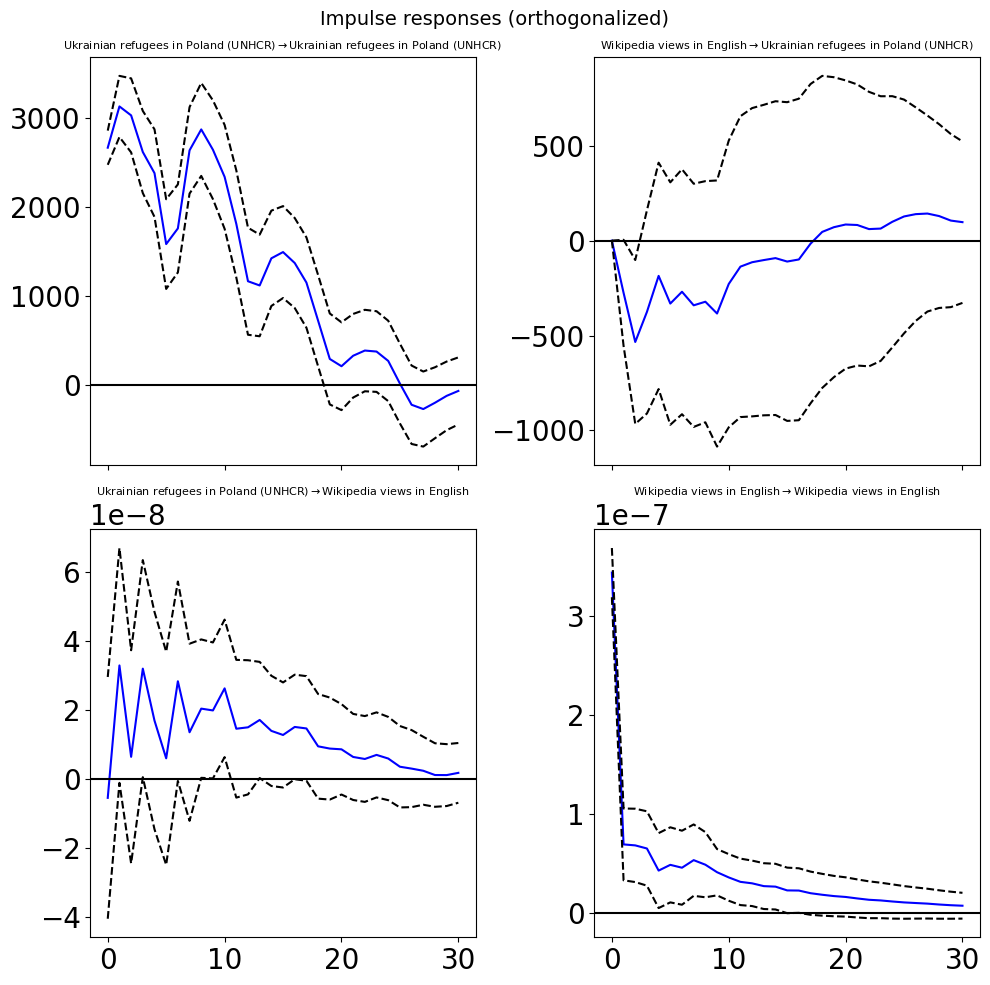

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    1.4034   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.5738   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.1936   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1312

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.746      -5.724    0.003196      -5.737
1       -7.052      -6.985   0.0008657      -7.025
2       -7.127     -7.016*   0.0008029      -7.083
3       -7.133      -6.978   0.0007984      -7.071
4       -7.127      -6.927   0.0008035      -7.047
5       -7.150      -6.906   0.0007850      -7.053
6       -7.248      -6.959   0.0007118     -7.133*
7       -7.239      -6.906   0.0007181      -7.107
8      -7.279*      -6.902  0.0006900*      -7.129
9       -7.272      -6.850   0.0006950      -7.104
10      -7.263      -6.797   0.0007012      -7.077
11      -7.245      -6.735   0.0007137      -7.042
12      -7.228      -6.673   0.0007263      -7.007
13      -7.222      -6.623   0.0007306      -6.984
14      -7.211      -6.568   0.0007389      -6.955
15      -7.20

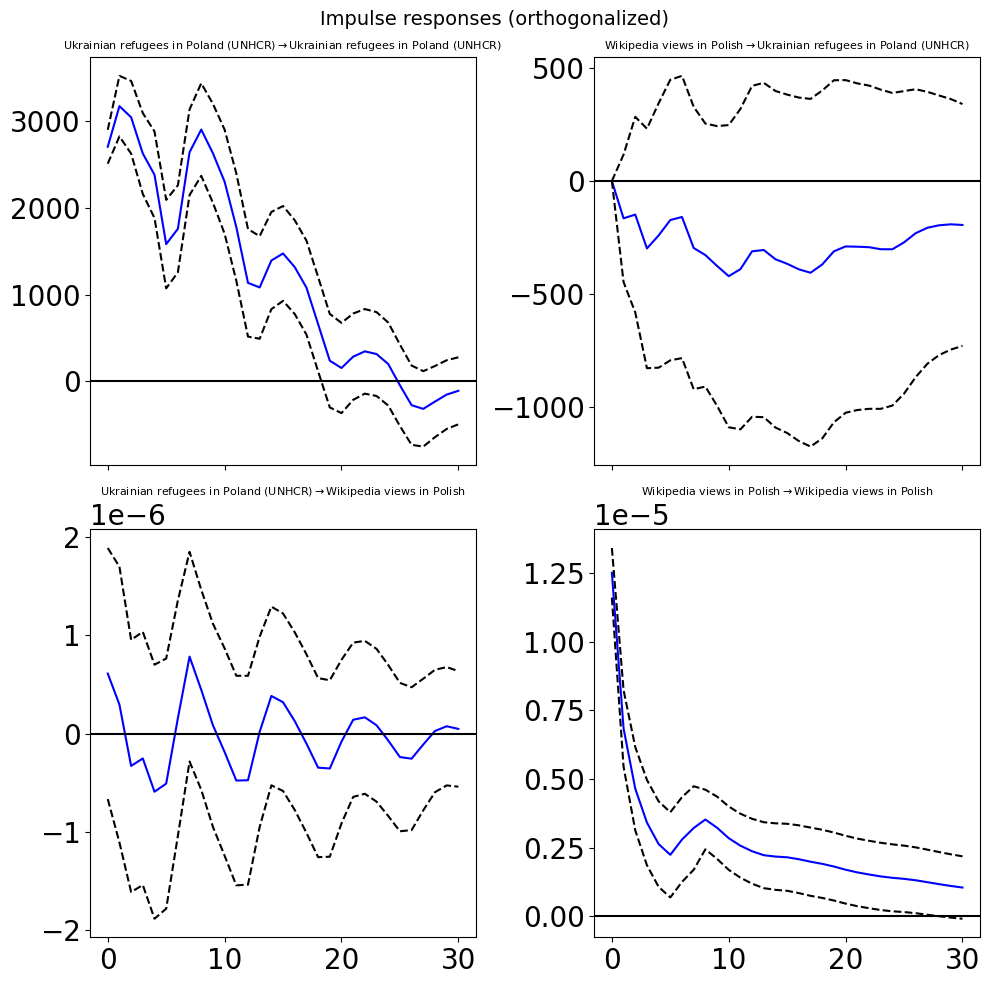

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.6240   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.5037   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.7577   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.8534

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -10.27      -10.24   3.478e-05      -10.26
1       -11.35      -11.28   1.176e-05      -11.32
2       -11.45      -11.34   1.060e-05      -11.41
3       -11.50     -11.35*   1.012e-05      -11.44
4       -11.50      -11.30   1.017e-05      -11.42
5       -11.53      -11.28   9.880e-06      -11.43
6       -11.62      -11.33   8.998e-06     -11.50*
7       -11.61      -11.28   9.060e-06      -11.48
8       -11.65      -11.28   8.693e-06      -11.50
9       -11.65      -11.23   8.678e-06      -11.49
10     -11.68*      -11.21  8.488e-06*      -11.49
11      -11.66      -11.15   8.660e-06      -11.45
12      -11.66      -11.10   8.665e-06      -11.44
13      -11.64      -11.04   8.825e-06      -11.40
14      -11.63      -10.98   8.928e-06      -11.37
15      -11.6

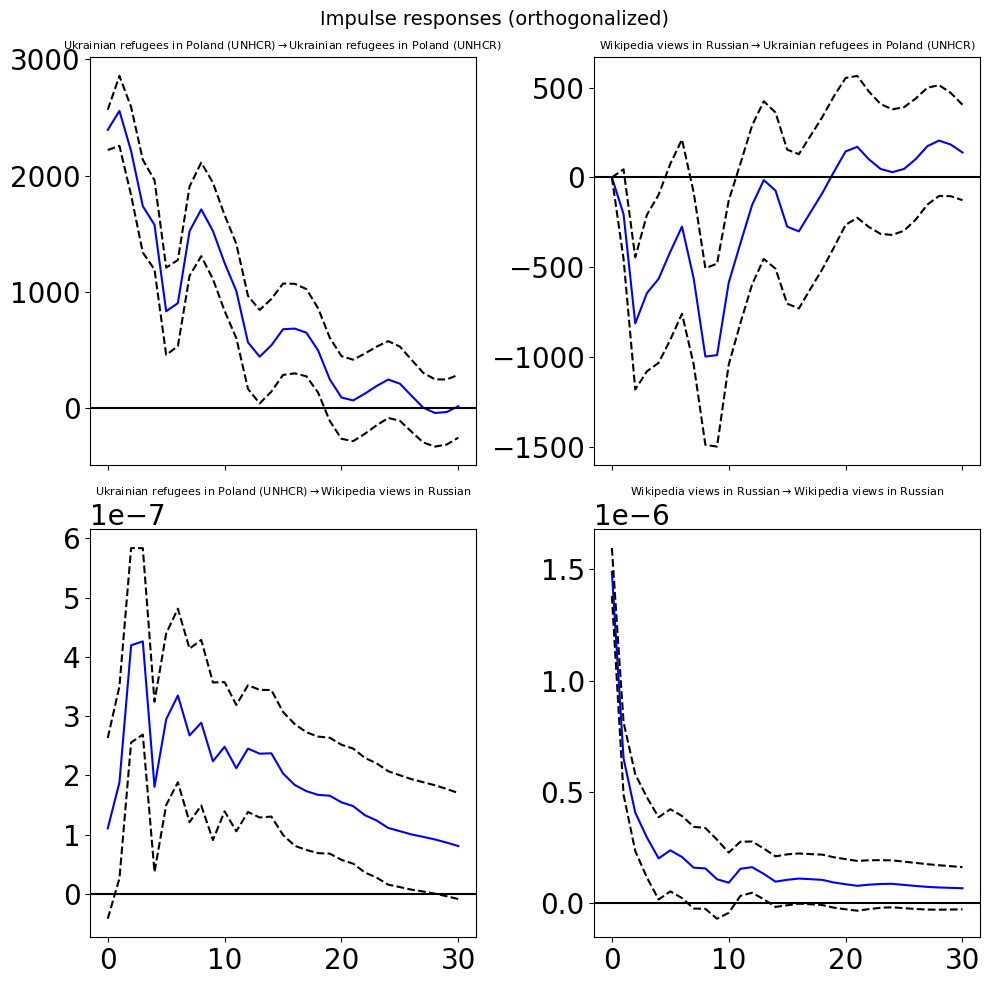

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
10                                   6.7014   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
10                                   5.3232   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
10                                   0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
10                                   0.0000

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.885      -6.863    0.001023      -6.877
1       -8.404      -8.337   0.0002241      -8.377
2       -8.497      -8.386   0.0002041      -8.453
3       -8.586      -8.431   0.0001867      -8.524
4       -8.596      -8.396   0.0001848      -8.517
5       -8.636      -8.392   0.0001777      -8.538
6       -8.744     -8.456*   0.0001594      -8.630
7       -8.772      -8.439   0.0001550      -8.640
8      -8.810*      -8.433  0.0001492*     -8.660*
9       -8.807      -8.385   0.0001497      -8.639
10      -8.795      -8.329   0.0001516      -8.609
11      -8.786      -8.276   0.0001529      -8.583
12      -8.783      -8.228   0.0001535      -8.562
13      -8.768      -8.169   0.0001558      -8.529
14      -8.775      -8.132   0.0001547      -8.519
15      -8.76

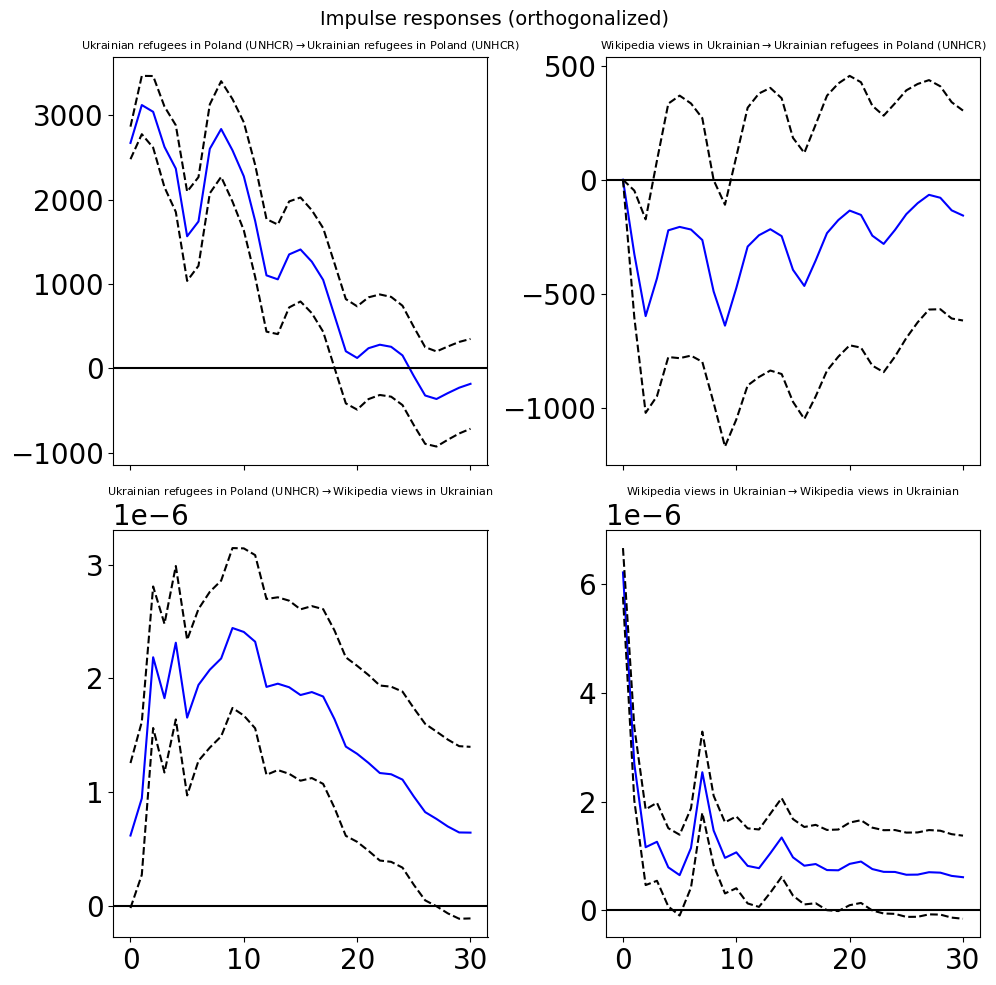

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                   10.8184   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.4250   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1845

Kraków
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -9.987      -9.964   4.601e-05      -9.978
1       -10.59      -10.52   2.515e-05      -10.56
2       -10.66      -10.55   2.346e-05      -10.62
3       -10.69      -10.53   2.278e-05      -10.63
4       -10.68      -10.49   2.289e-05      -10.61
5       -10.69      -10.45   2.273e-05      -10.59
6       -10.78      -10.49   2.082e-05      -10.66
7       -10.85      -10.52   1.938e-05      -10.72
8       -10.97     -10.59*   1.719e-05     -10.82*
9      -10.97*      -10.55  1.719e-05*      -10.80
10      -10.96      -10.49   1.742e-05      -10.77
11      -10.94      -10.43   1.775e-05      -10.74
12      -10.93      -10.38   1.789e-05      -10.71
13      -10.92      -10.32   1.819e-05      -10.68
14      -10.93      -10.29   1.788e-05      -10.68
15    

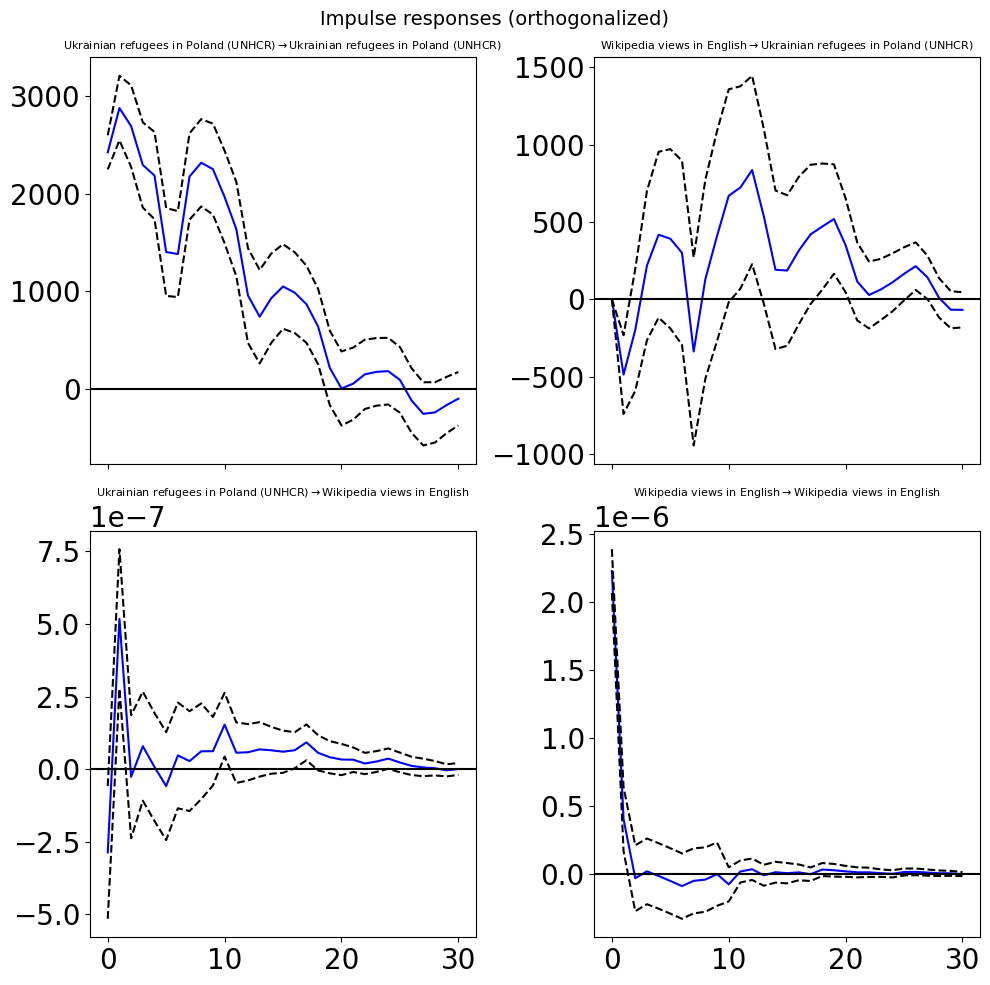

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
9                                    4.4329   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
9                                    9.6654   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
9                                    0.0000   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
9                                    0.0000

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.278      -5.256    0.005102      -5.269
1       -6.263      -6.196    0.001906      -6.236
2       -6.326     -6.215*    0.001789      -6.282
3       -6.354      -6.198    0.001740      -6.292
4       -6.378      -6.178    0.001698      -6.299
5       -6.384      -6.140    0.001689      -6.286
6       -6.489      -6.200    0.001520      -6.374
7       -6.541      -6.208    0.001444      -6.408
8      -6.574*      -6.197   0.001397*     -6.424*
9       -6.552      -6.131    0.001427      -6.384
10      -6.539      -6.073    0.001447      -6.353
11      -6.539      -6.029    0.001446      -6.336
12      -6.574      -6.019    0.001397      -6.353
13      -6.571      -5.972    0.001402      -6.332
14      -6.566      -5.923    0.001408      -6.310
15      -6.56

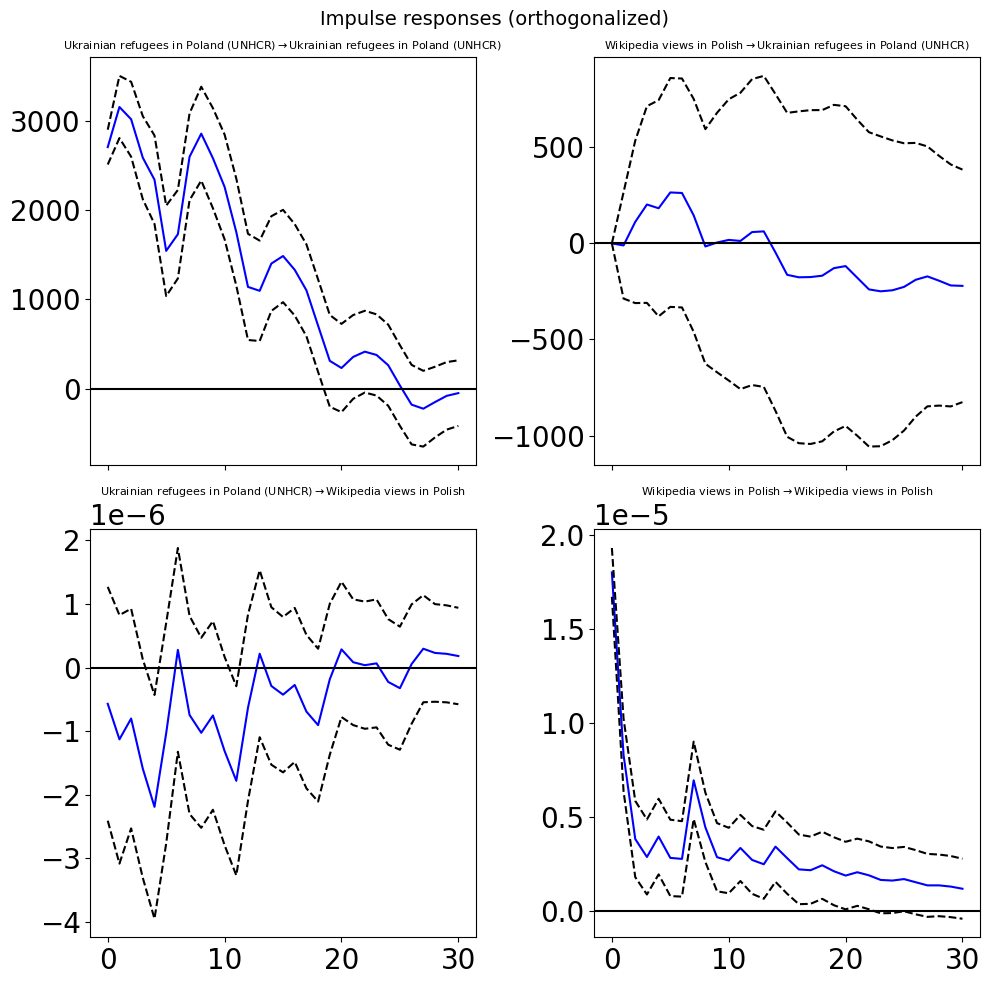

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    1.1065   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.3700   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.3580   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.9360

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -10.06      -10.04   4.276e-05      -10.05
1       -11.05      -10.98   1.590e-05      -11.02
2       -11.14     -11.03*   1.450e-05      -11.10
3       -11.13      -10.98   1.464e-05      -11.07
4       -11.15      -10.95   1.436e-05      -11.07
5       -11.16      -10.92   1.418e-05      -11.07
6       -11.26      -10.97   1.292e-05     -11.14*
7       -11.25      -10.91   1.306e-05      -11.11
8      -11.28*      -10.90  1.260e-05*      -11.13
9       -11.26      -10.84   1.289e-05      -11.09
10      -11.25      -10.78   1.302e-05      -11.06
11      -11.24      -10.73   1.315e-05      -11.04
12      -11.23      -10.67   1.330e-05      -11.01
13      -11.21      -10.61   1.354e-05      -10.97
14      -11.19      -10.55   1.376e-05      -10.94
15      -11.1

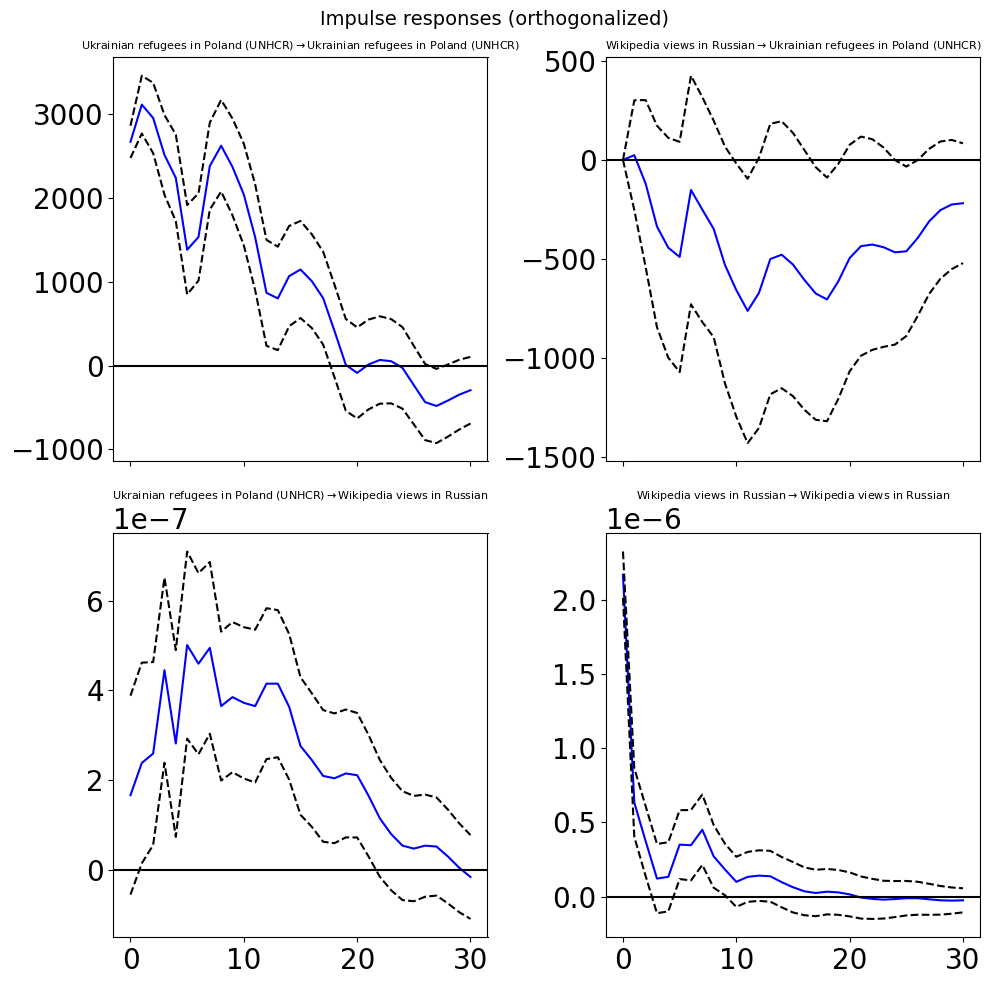

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    8.0116   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.7008   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0969

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.109      -6.087    0.002223      -6.100
1       -7.234      -7.167   0.0007218      -7.207
2       -7.347      -7.236   0.0006443      -7.303
3       -7.372      -7.217   0.0006285      -7.310
4       -7.405      -7.205   0.0006081      -7.326
5       -7.429      -7.185   0.0005938      -7.332
6       -7.567      -7.279   0.0005173      -7.452
7       -7.638     -7.306*   0.0004816      -7.506
8      -7.667*      -7.289  0.0004683*     -7.516*
9       -7.666      -7.244   0.0004688      -7.498
10      -7.651      -7.185   0.0004758      -7.465
11      -7.637      -7.127   0.0004824      -7.434
12      -7.649      -7.095   0.0004766      -7.429
13      -7.642      -7.043   0.0004803      -7.403
14      -7.663      -7.020   0.0004701      -7.407
15      -7.66

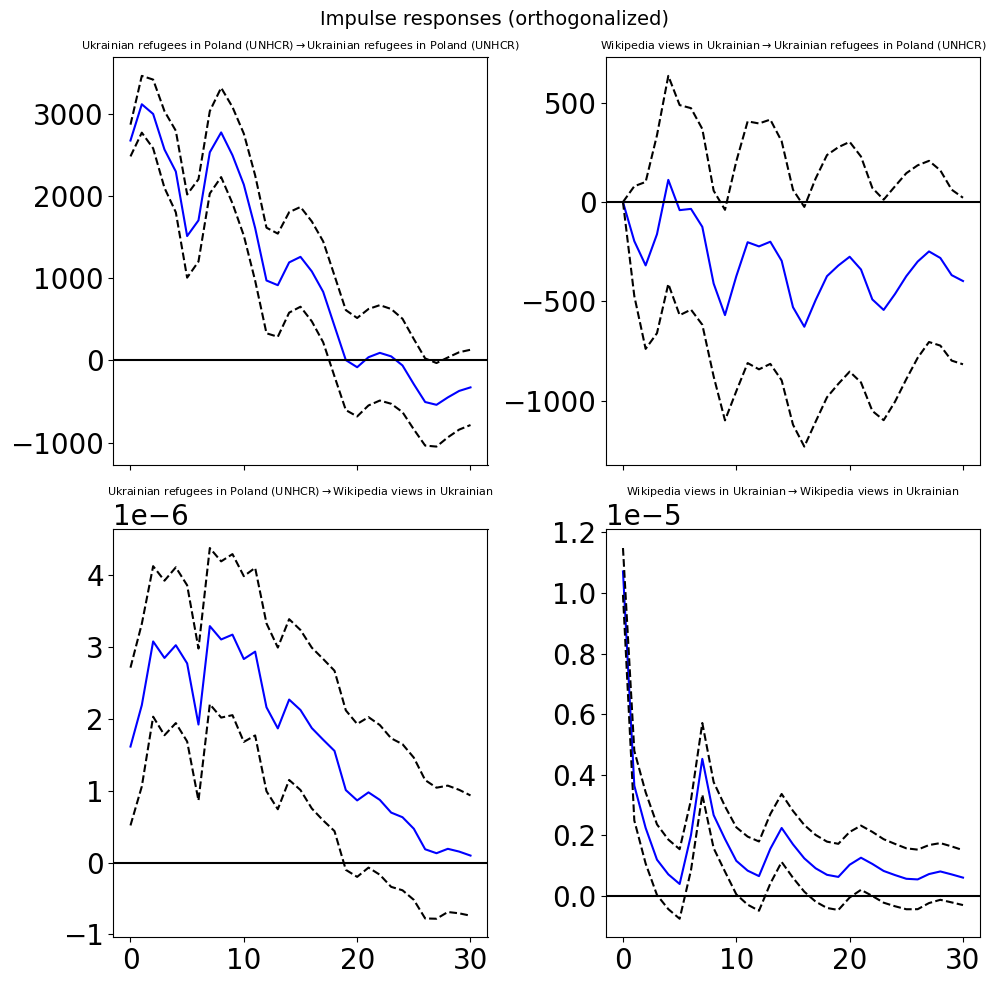

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    8.5023   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.4589   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1710

Lublin
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -12.89      -12.87   2.514e-06      -12.88
1       -13.75      -13.68   1.068e-06      -13.72
2       -13.81     -13.70*   1.004e-06      -13.77
3       -13.80      -13.65   1.012e-06      -13.74
4       -13.80      -13.61   1.011e-06      -13.73
5       -13.82      -13.58   9.937e-07      -13.72
6       -13.90      -13.61   9.184e-07     -13.79*
7       -13.88      -13.55   9.361e-07      -13.75
8       -13.91      -13.53   9.120e-07      -13.76
9       -13.89      -13.47   9.281e-07      -13.72
10      -13.88      -13.41   9.387e-07      -13.69
11      -13.87      -13.36   9.441e-07      -13.67
12      -13.91      -13.36   9.090e-07      -13.69
13     -13.92*      -13.32  9.020e-07*      -13.68
14      -13.91      -13.26   9.151e-07      -13.65
15    

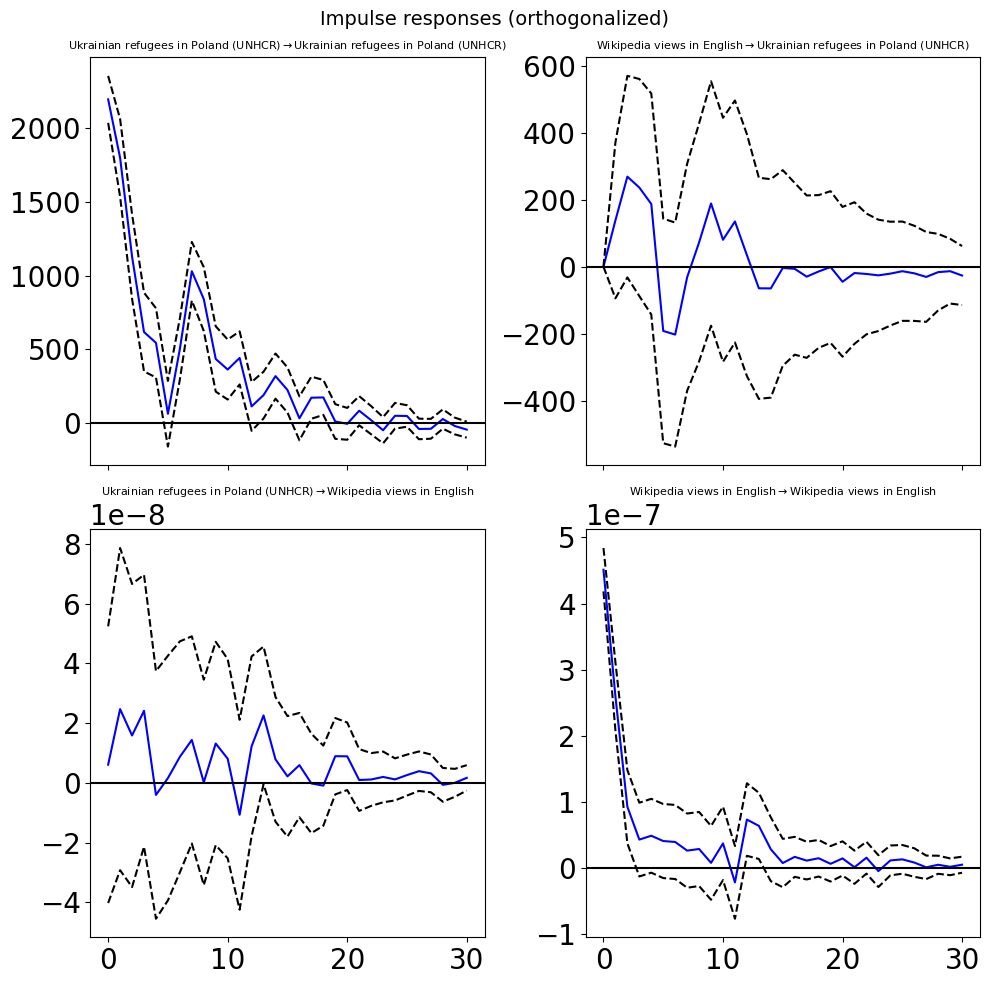

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
13                                   0.4530   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
13                                   1.2192   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
13                                   0.9486   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
13                                   0.2635

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.130      -6.108    0.002176      -6.121
1       -7.057      -6.990   0.0008617      -7.030
2       -7.144     -7.033*   0.0007894      -7.100
3       -7.160      -7.005   0.0007768      -7.098
4       -7.181      -6.982   0.0007606      -7.102
5       -7.209      -6.965   0.0007402      -7.111
6       -7.297      -7.009   0.0006775     -7.182*
7       -7.288      -6.955   0.0006839      -7.155
8      -7.315*      -6.937  0.0006659*      -7.164
9       -7.296      -6.875   0.0006784      -7.128
10      -7.277      -6.811   0.0006917      -7.091
11      -7.263      -6.753   0.0007011      -7.060
12      -7.249      -6.694   0.0007111      -7.028
13      -7.238      -6.639   0.0007191      -7.000
14      -7.256      -6.612   0.0007068      -6.999
15      -7.25

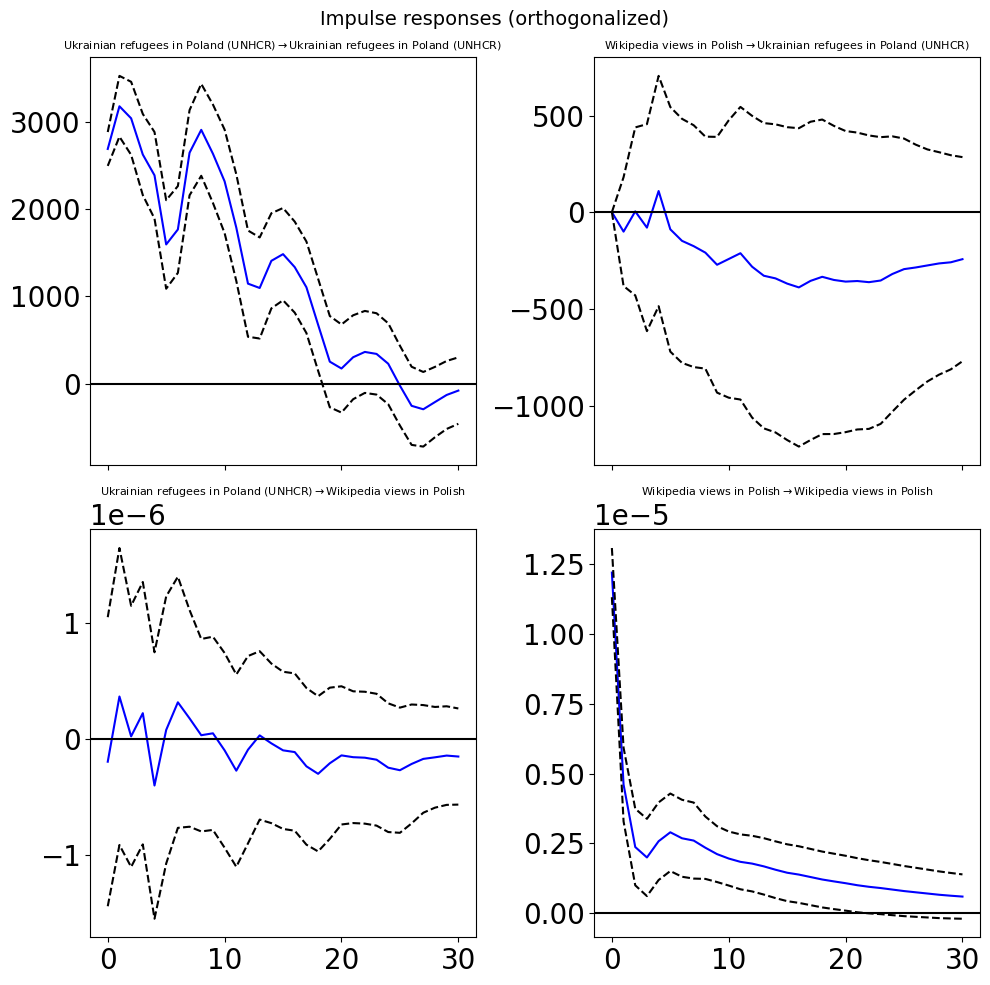

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.3327   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.8901   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.9531   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.5249

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -7.120      -7.098   0.0008085      -7.111
1       -7.726      -7.659   0.0004412      -7.700
2       -7.783     -7.672*   0.0004168     -7.739*
3       -7.771      -7.616   0.0004216      -7.710
4       -7.764      -7.565   0.0004246      -7.685
5       -7.777      -7.533   0.0004194      -7.680
6       -7.853      -7.565   0.0003885      -7.738
7       -7.834      -7.502   0.0003959      -7.702
8      -7.862*      -7.484  0.0003853*      -7.711
9       -7.842      -7.420   0.0003931      -7.674
10      -7.824      -7.358   0.0004002      -7.638
11      -7.812      -7.302   0.0004050      -7.609
12      -7.800      -7.245   0.0004100      -7.579
13      -7.787      -7.188   0.0004153      -7.549
14      -7.786      -7.142   0.0004159      -7.530
15      -7.77

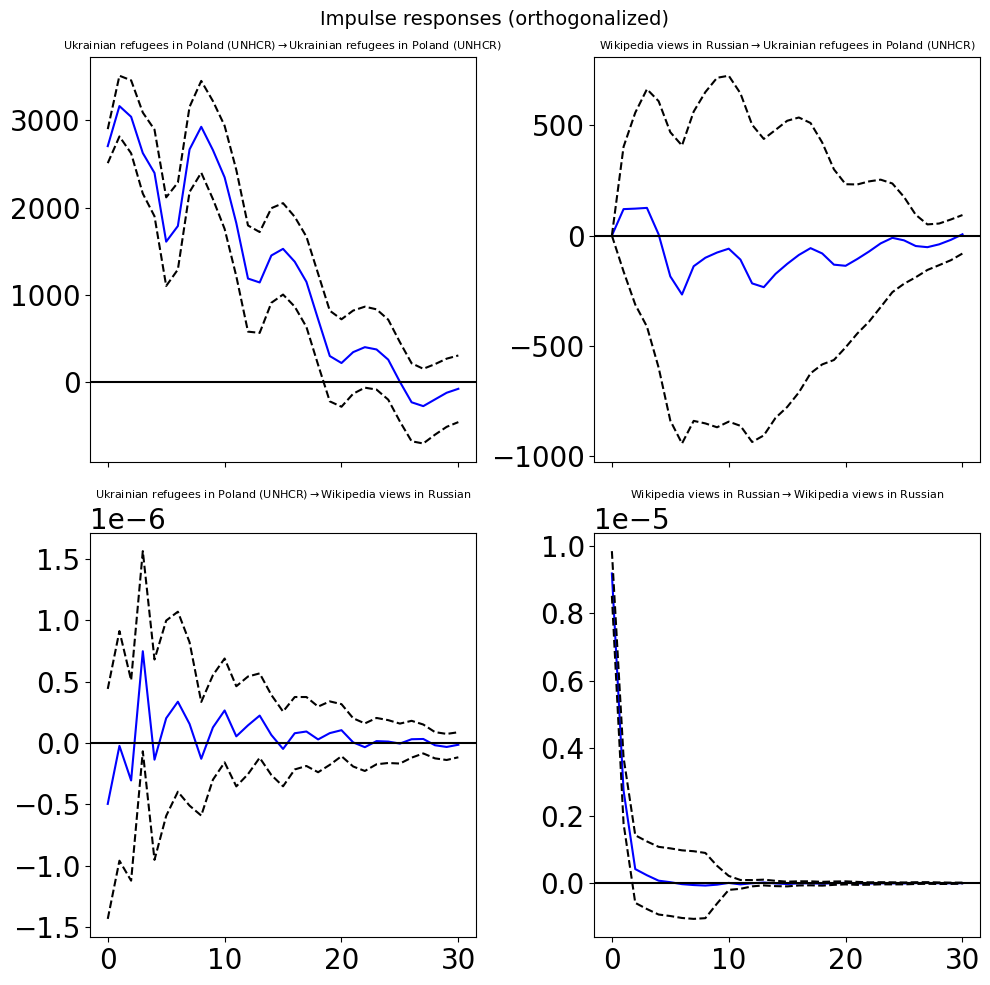

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.8618   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.3950   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.5490   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.9230

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.227      -5.205    0.005369      -5.218
1       -5.874      -5.807    0.002812      -5.847
2       -5.932     -5.821*    0.002653      -5.888
3       -5.931      -5.776    0.002655      -5.869
4       -5.927      -5.727    0.002667      -5.847
5       -5.936      -5.692    0.002643      -5.839
6       -6.011      -5.722    0.002453     -5.896*
7       -5.990      -5.658    0.002503      -5.858
8      -6.019*      -5.642   0.002432*      -5.869
9       -6.007      -5.586    0.002462      -5.839
10      -5.991      -5.525    0.002503      -5.805
11      -5.983      -5.473    0.002522      -5.780
12      -5.970      -5.415    0.002557      -5.749
13      -5.956      -5.357    0.002592      -5.718
14      -5.949      -5.306    0.002610      -5.693
15      -5.93

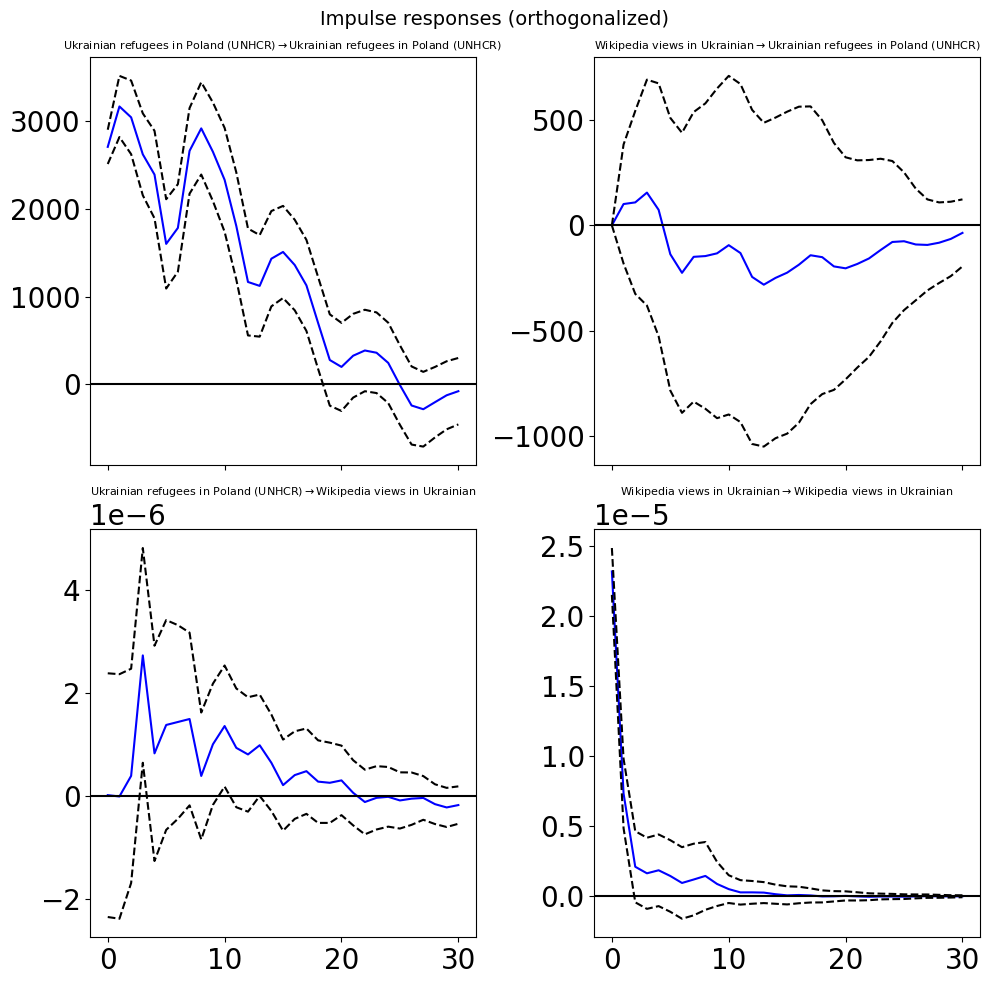

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    1.6805   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.3777   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.1018   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.9322

Warsaw
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -9.998      -9.976   4.550e-05      -9.989
1       -10.73      -10.66   2.191e-05      -10.70
2       -10.79     -10.68*   2.051e-05      -10.75
3       -10.80      -10.64   2.049e-05      -10.73
4       -10.80      -10.60   2.032e-05      -10.72
5       -10.82      -10.57   2.008e-05      -10.72
6       -10.90      -10.61   1.848e-05      -10.78
7       -10.90      -10.56   1.853e-05      -10.76
8       -10.97      -10.60   1.713e-05     -10.82*
9       -10.98      -10.56   1.704e-05      -10.81
10      -10.97      -10.51   1.715e-05      -10.79
11      -10.96      -10.45   1.734e-05      -10.76
12      -10.98      -10.43   1.703e-05      -10.76
13      -10.97      -10.37   1.720e-05      -10.73
14      -10.97      -10.32   1.730e-05      -10.71
15    

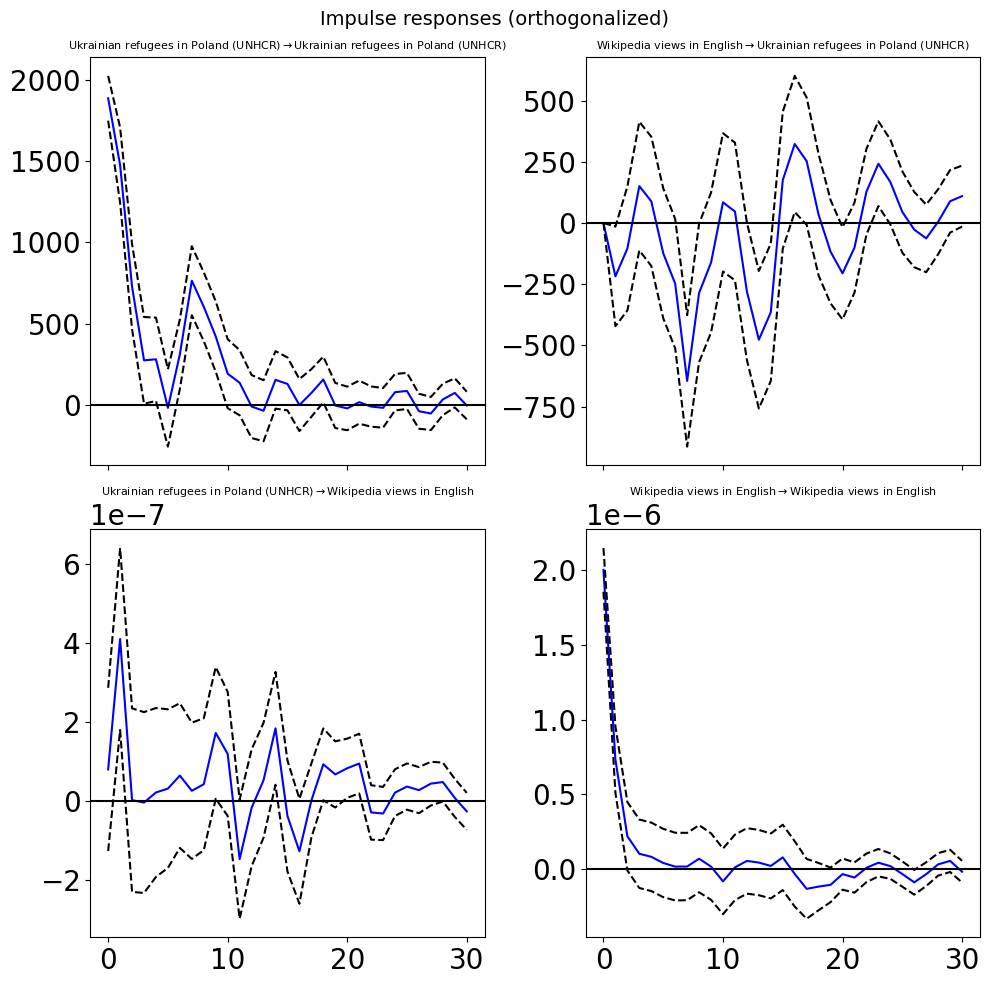

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
17                                   2.9418   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
17                                   3.8055   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
17                                   0.0001   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
17                                   0.0000

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -3.969      -3.947     0.01889      -3.960
1       -5.224      -5.158    0.005385      -5.198
2       -5.278     -5.167*    0.005105      -5.233
3       -5.291      -5.136    0.005037      -5.229
4       -5.314      -5.115    0.004921      -5.235
5       -5.342      -5.098    0.004786      -5.245
6       -5.439      -5.150    0.004345      -5.324
7       -5.465      -5.133    0.004231      -5.333
8      -5.489*      -5.112   0.004131*     -5.339*
9       -5.469      -5.048    0.004215      -5.301
10      -5.454      -4.989    0.004279      -5.269
11      -5.453      -4.943    0.004286      -5.250
12      -5.444      -4.890    0.004322      -5.224
13      -5.447      -4.848    0.004313      -5.208
14      -5.440      -4.796    0.004345      -5.183
15      -5.47

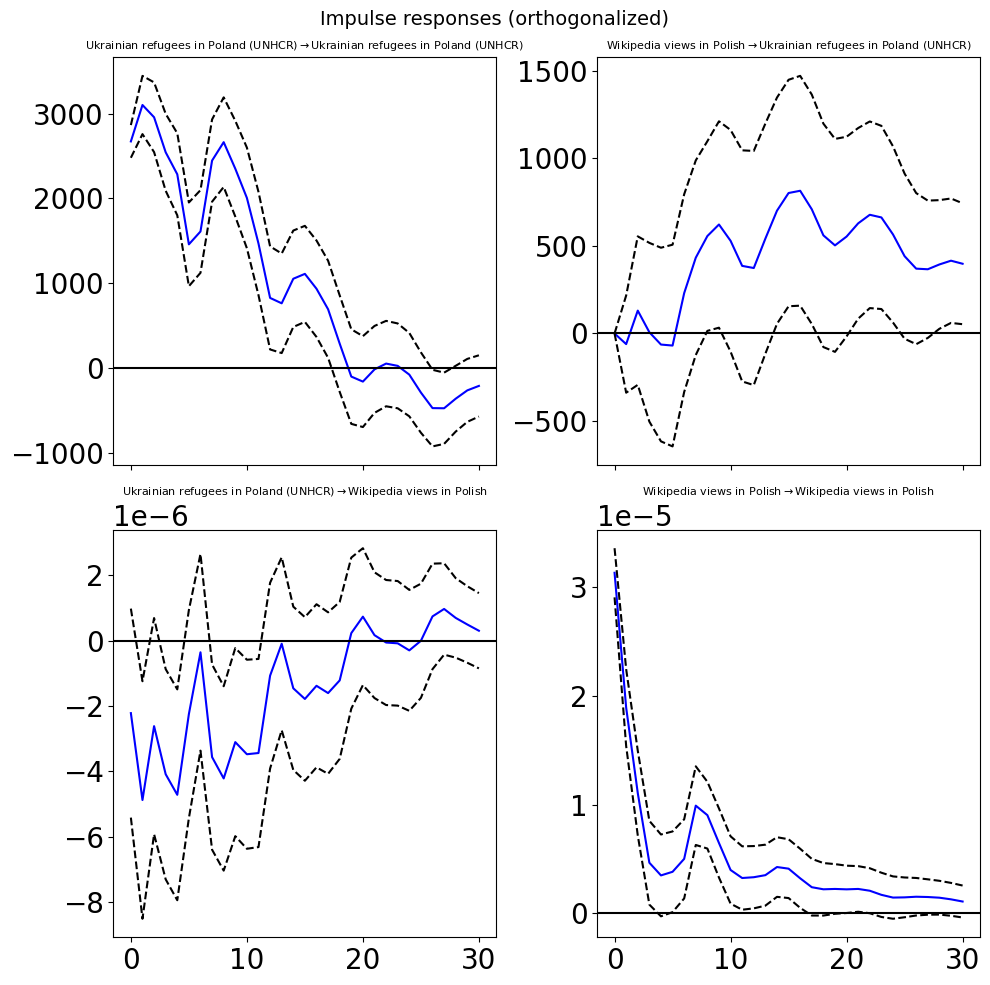

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    2.5389   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.5024   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.0107   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1549

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -8.877      -8.855   0.0001396      -8.868
1       -10.08      -10.02   4.183e-05      -10.06
2       -10.16      -10.05   3.862e-05      -10.12
3       -10.21     -10.06*   3.676e-05      -10.15
4       -10.23      -10.03   3.619e-05      -10.15
5       -10.23      -9.988   3.599e-05      -10.14
6       -10.32      -10.03   3.294e-05     -10.21*
7       -10.30      -9.968   3.362e-05      -10.17
8       -10.33      -9.953   3.264e-05      -10.18
9       -10.33      -9.913  3.251e-05*      -10.17
10      -10.33      -9.867   3.255e-05      -10.15
11      -10.32      -9.806   3.309e-05      -10.11
12      -10.30      -9.746   3.362e-05      -10.08
13      -10.29      -9.690   3.401e-05      -10.05
14      -10.30      -9.656   3.368e-05      -10.04
15      -10.3

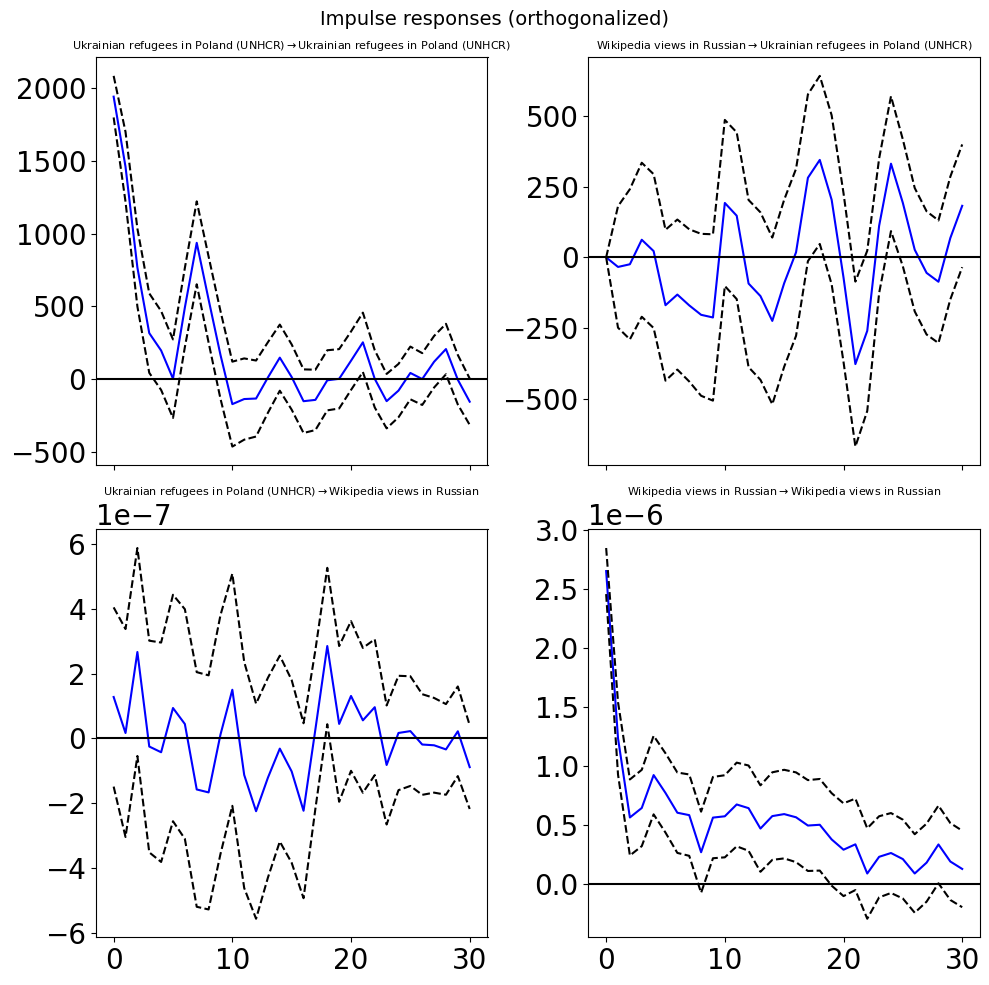

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
23                                   2.0560   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
23                                   1.5852   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
23                                   0.0035   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
23                                   0.0452

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.640      -5.618    0.003553      -5.631
1       -7.043      -6.977   0.0008731      -7.017
2       -7.202      -7.091   0.0007454      -7.157
3       -7.277      -7.122   0.0006913      -7.215
4       -7.313      -7.113   0.0006670      -7.233
5       -7.349      -7.105   0.0006432      -7.252
6       -7.460     -7.172*   0.0005757      -7.345
7       -7.502      -7.169   0.0005519      -7.370
8      -7.530*      -7.153  0.0005370*     -7.380*
9       -7.528      -7.107   0.0005378      -7.360
10      -7.525      -7.059   0.0005396      -7.339
11      -7.508      -6.998   0.0005487      -7.305
12      -7.493      -6.938   0.0005572      -7.272
13      -7.489      -6.890   0.0005595      -7.251
14      -7.487      -6.843   0.0005610      -7.230
15      -7.48

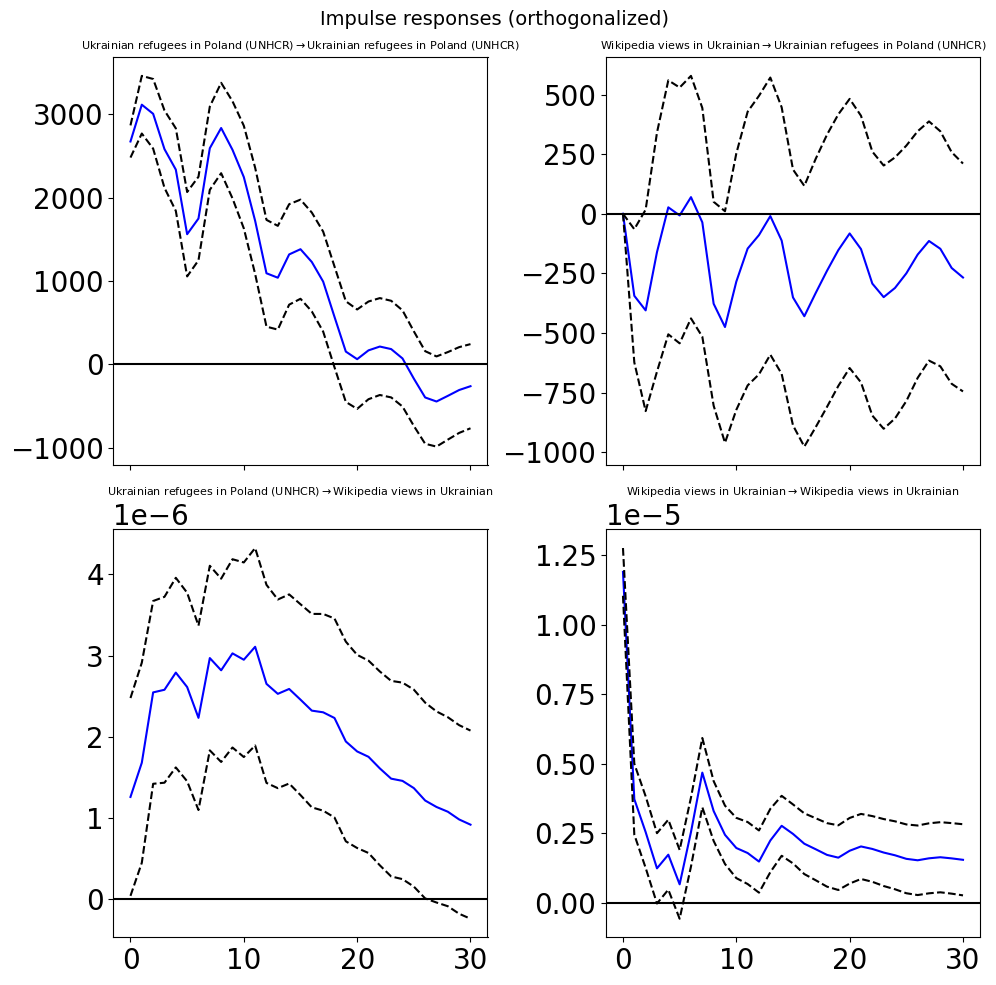

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    6.5972   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.4339   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1809

Białystok
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -14.26      -14.24   6.401e-07      -14.25
1       -14.93      -14.86   3.279e-07      -14.90
2       -15.00     -14.89*   3.044e-07      -14.96
3       -15.01      -14.86   3.017e-07      -14.95
4       -15.01      -14.81   3.024e-07      -14.93
5       -15.03      -14.79   2.971e-07      -14.93
6       -15.11      -14.82   2.736e-07     -15.00*
7       -15.11      -14.78   2.740e-07      -14.98
8      -15.14*      -14.77  2.650e-07*      -14.99
9       -15.13      -14.71   2.686e-07      -14.96
10      -15.11      -14.65   2.734e-07      -14.93
11      -15.10      -14.59   2.771e-07      -14.90
12      -15.09      -14.53   2.808e-07      -14.87
13      -15.08      -14.48   2.828e-07      -14.84
14      -15.08      -14.44   2.828e-07      -14.82
15 

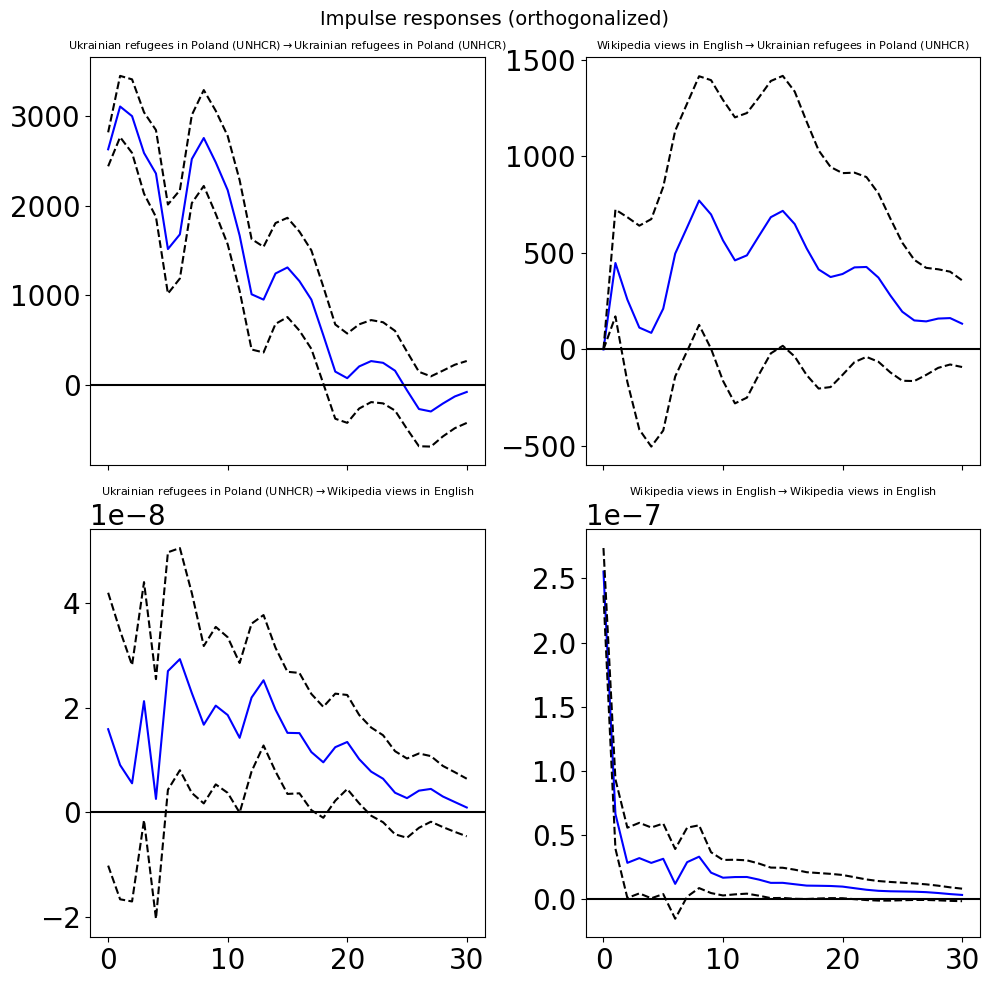

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    1.9771   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    2.8338   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.0484   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0046

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.814      -6.792    0.001098      -6.805
1       -7.681      -7.614   0.0004616      -7.654
2       -7.780     -7.669*   0.0004181      -7.736
3       -7.788      -7.633   0.0004145      -7.726
4       -7.814      -7.615   0.0004039      -7.735
5       -7.842      -7.598   0.0003928      -7.745
6       -7.936      -7.647   0.0003577     -7.821*
7       -7.940      -7.608   0.0003561      -7.808
8      -7.962*      -7.585  0.0003486*      -7.812
9       -7.939      -7.518   0.0003566      -7.771
10      -7.926      -7.460   0.0003613      -7.741
11      -7.913      -7.403   0.0003661      -7.710
12      -7.925      -7.370   0.0003619      -7.704
13      -7.915      -7.316   0.0003656      -7.676
14      -7.918      -7.275   0.0003644      -7.662
15      -7.90

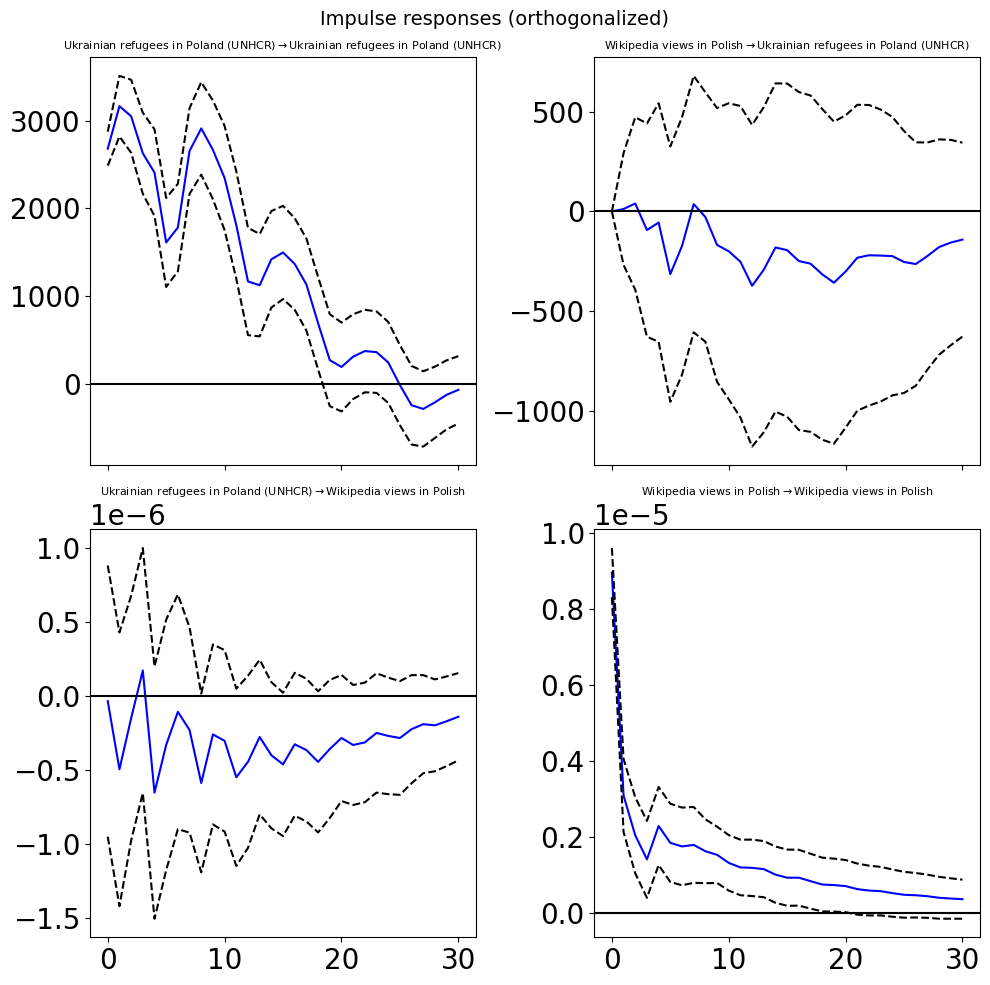

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.8330   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.2060   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.5739   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.2943

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -10.98      -10.96   1.706e-05      -10.97
1       -11.80      -11.73   7.503e-06      -11.77
2       -11.88     -11.76*   6.959e-06      -11.83
3       -11.87      -11.72   6.965e-06      -11.81
4       -11.87      -11.67   7.030e-06      -11.79
5       -11.87      -11.63   6.977e-06      -11.78
6       -11.98      -11.69   6.285e-06     -11.86*
7       -11.97      -11.64   6.311e-06      -11.84
8      -12.01*      -11.63  6.088e-06*      -11.86
9       -12.00      -11.57   6.170e-06      -11.83
10      -12.01      -11.54   6.104e-06      -11.82
11      -11.99      -11.48   6.221e-06      -11.78
12      -11.97      -11.42   6.311e-06      -11.75
13      -11.96      -11.36   6.384e-06      -11.72
14      -11.96      -11.31   6.418e-06      -11.70
15      -11.9

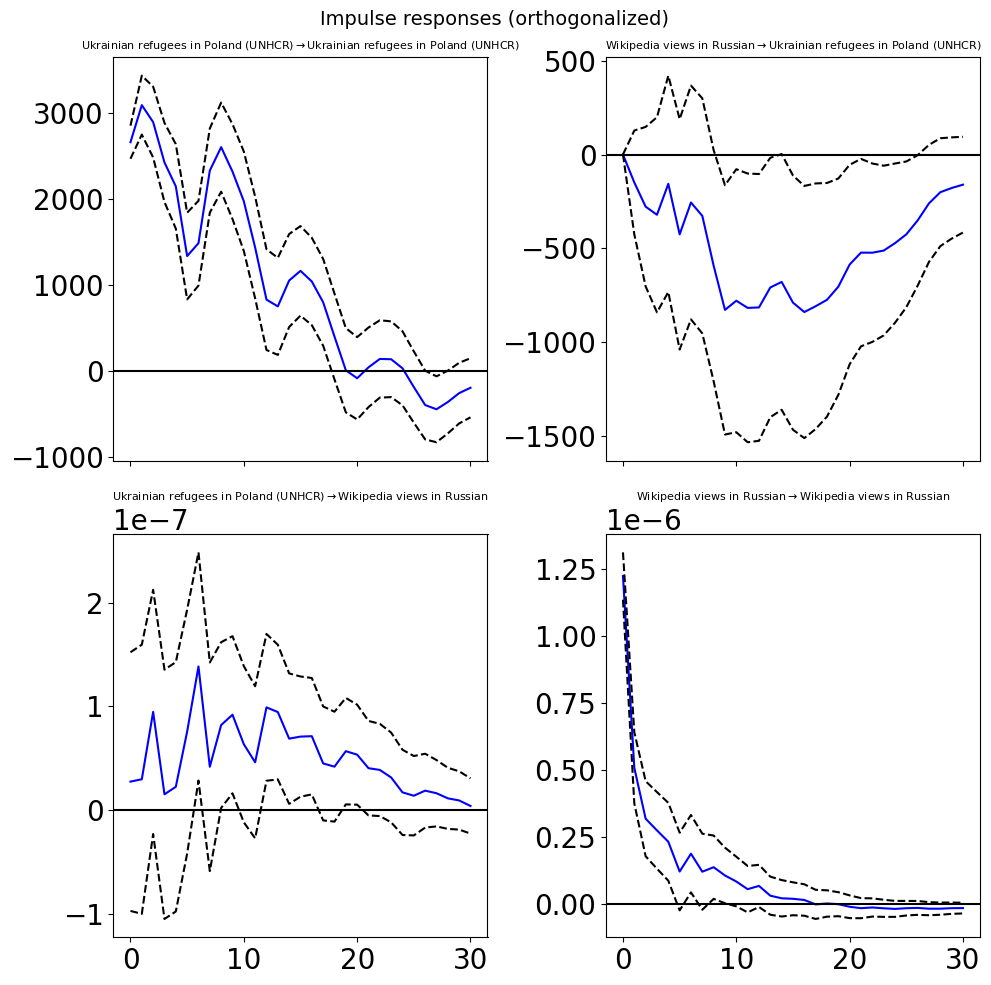

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    1.9516   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.9153   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0517   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0567

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -8.901      -8.879   0.0001362      -8.892
1       -9.727      -9.660   5.968e-05      -9.700
2       -9.856     -9.745*   5.245e-05      -9.811
3       -9.896      -9.741   5.037e-05      -9.834
4       -9.921      -9.721   4.913e-05      -9.842
5       -9.940      -9.696   4.821e-05      -9.843
6       -10.03      -9.744   4.394e-05     -9.918*
7       -10.03      -9.698   4.403e-05      -9.898
8      -10.07*      -9.690  4.245e-05*      -9.917
9       -10.05      -9.627   4.324e-05      -9.881
10      -10.04      -9.569   4.385e-05      -9.850
11      -10.02      -9.513   4.438e-05      -9.820
12      -10.02      -9.462   4.468e-05      -9.796
13      -10.01      -9.409   4.508e-05      -9.769
14      -10.01      -9.366   4.499e-05      -9.754
15      -9.99

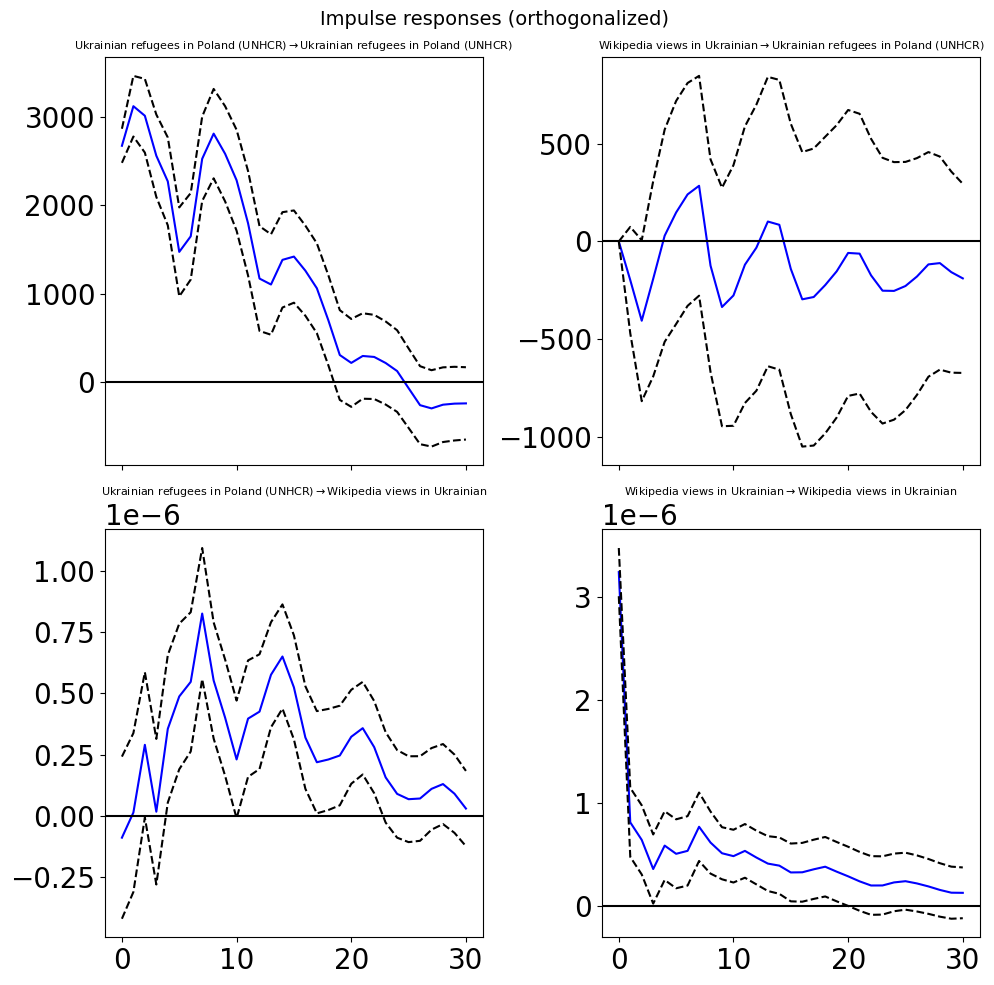

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    8.4468   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.5287   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1458

Gliwice
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -14.09      -14.07   7.587e-07      -14.08
1       -15.07      -15.01   2.846e-07      -15.05
2       -15.14     -15.03*   2.663e-07      -15.09
3       -15.16      -15.00   2.617e-07      -15.09
4       -15.16      -14.96   2.616e-07      -15.08
5       -15.16      -14.92   2.598e-07      -15.07
6       -15.25      -14.96   2.387e-07     -15.13*
7       -15.23      -14.90   2.426e-07      -15.10
8      -15.27*      -14.89  2.342e-07*      -15.12
9       -15.25      -14.83   2.384e-07      -15.08
10      -15.24      -14.77   2.414e-07      -15.05
11      -15.23      -14.72   2.422e-07      -15.03
12      -15.22      -14.67   2.452e-07      -15.00
13      -15.22      -14.62   2.462e-07      -14.98
14      -15.22      -14.57   2.464e-07      -14.96
15   

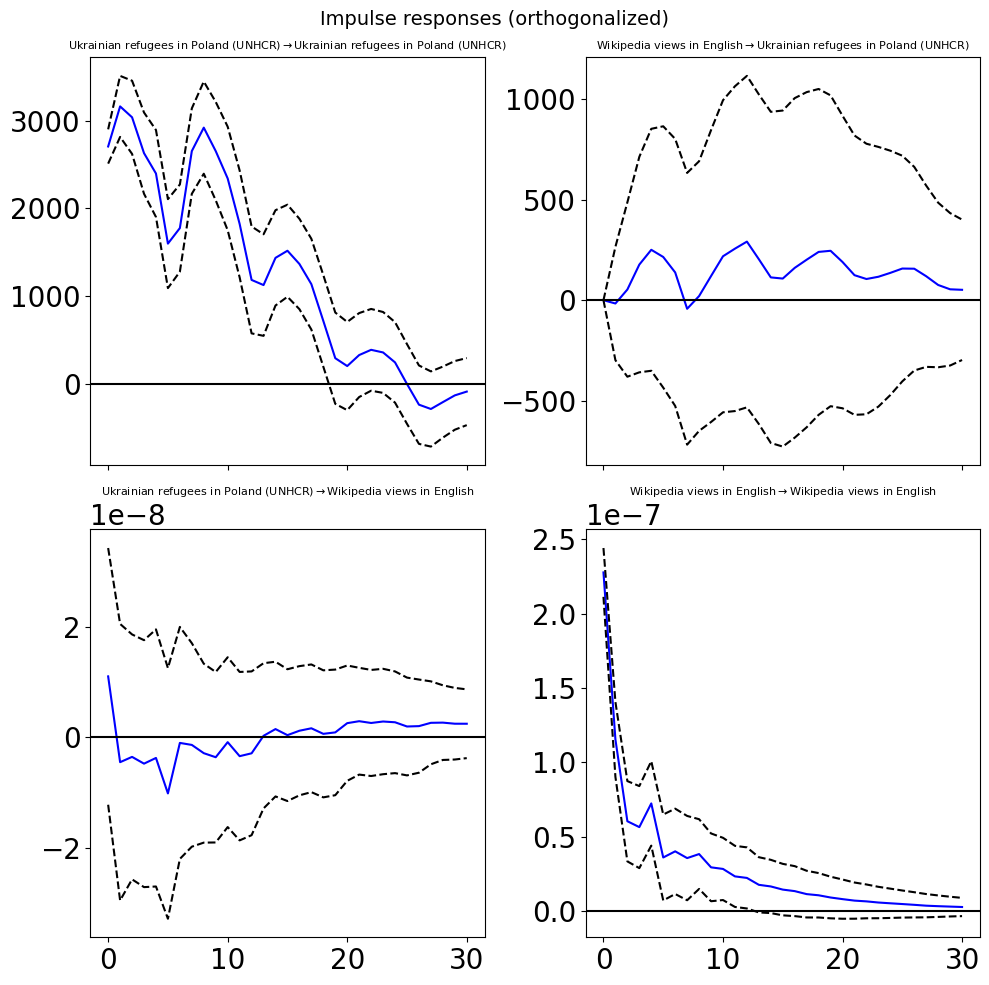

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.2192   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.3620   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.9874   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.9400

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.646      -6.623    0.001300      -6.637
1       -7.619      -7.552   0.0004912      -7.592
2       -7.723      -7.612   0.0004424      -7.679
3       -7.789      -7.634   0.0004142      -7.727
4       -7.862      -7.663   0.0003850      -7.783
5       -7.881      -7.637   0.0003779      -7.784
6       -7.982     -7.694*   0.0003415     -7.867*
7       -7.967      -7.634   0.0003468      -7.834
8       -7.989      -7.612   0.0003391      -7.839
9      -8.003*      -7.582  0.0003345*      -7.835
10      -7.989      -7.523   0.0003392      -7.804
11      -7.982      -7.472   0.0003417      -7.779
12      -7.978      -7.423   0.0003432      -7.757
13      -7.982      -7.383   0.0003418      -7.743
14      -7.977      -7.334   0.0003435      -7.721
15      -7.97

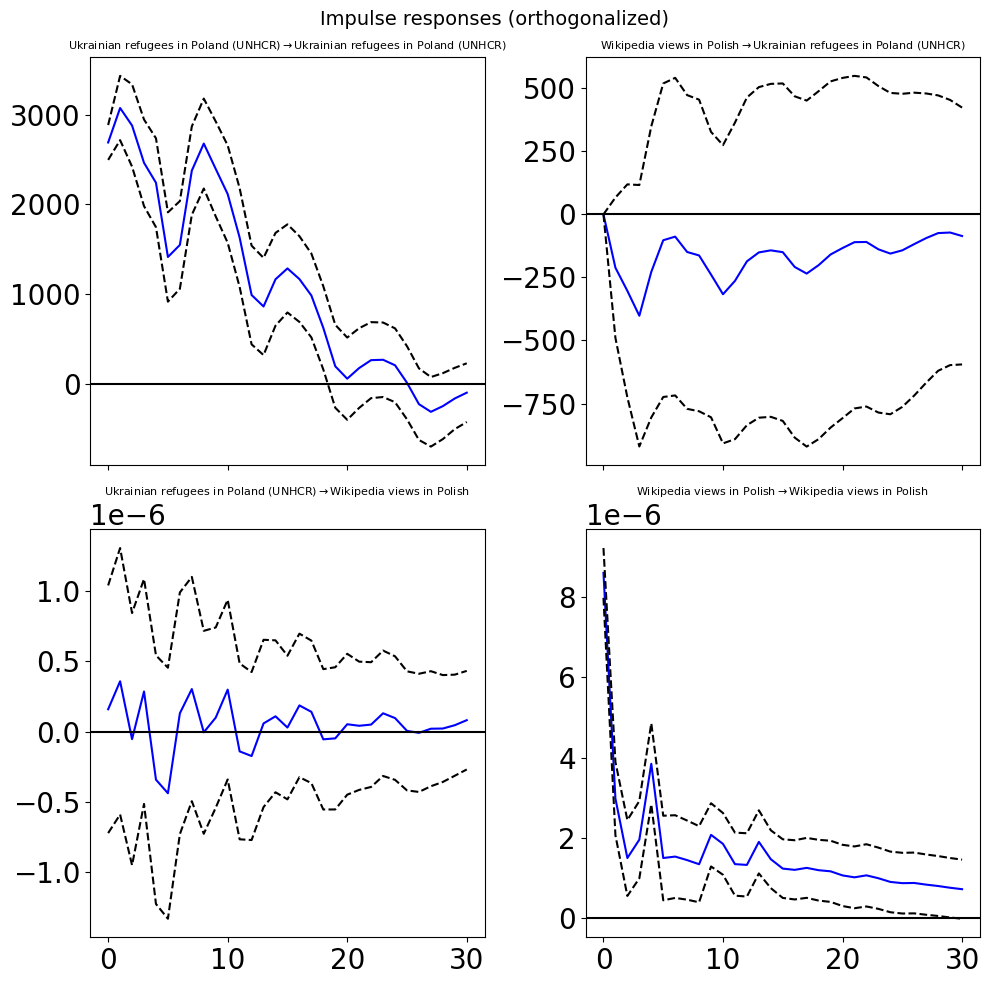

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
9                                    0.6552   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
9                                    0.5463   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
9                                    0.7493   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
9                                    0.8402

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -11.51      -11.48   1.006e-05      -11.50
1       -12.12      -12.05   5.457e-06      -12.09
2       -12.19     -12.08*   5.099e-06      -12.14
3       -12.18      -12.02   5.132e-06      -12.12
4       -12.17      -11.97   5.163e-06      -12.09
5       -12.18      -11.93   5.151e-06      -12.08
6       -12.26      -11.98   4.719e-06     -12.15*
7       -12.25      -11.92   4.776e-06      -12.12
8      -12.28*      -11.90  4.652e-06*      -12.13
9       -12.26      -11.84   4.730e-06      -12.09
10      -12.25      -11.78   4.808e-06      -12.06
11      -12.26      -11.75   4.749e-06      -12.05
12      -12.26      -11.70   4.756e-06      -12.04
13      -12.25      -11.65   4.807e-06      -12.01
14      -12.24      -11.59   4.848e-06      -11.98
15      -12.2

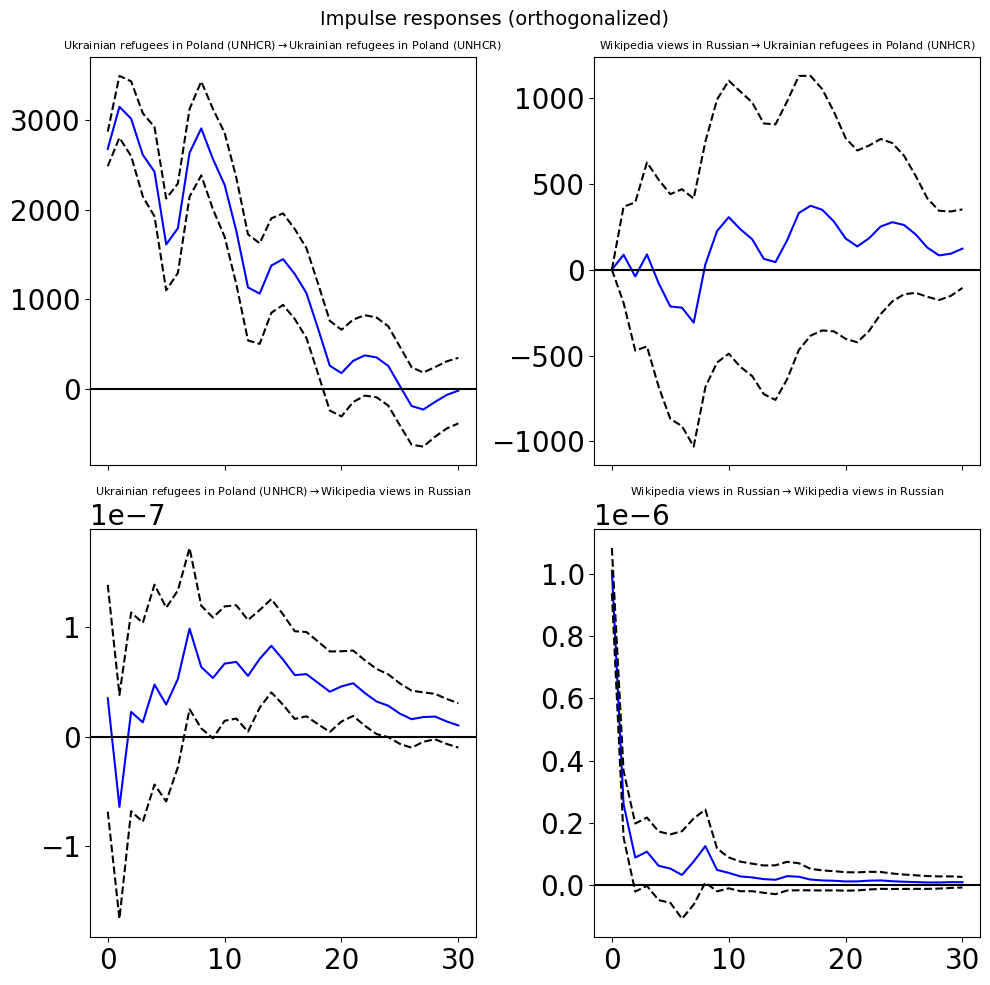

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    2.7340   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.2549   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0062   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.2663

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -8.795      -8.773   0.0001514      -8.787
1       -9.710      -9.643   6.070e-05      -9.683
2       -9.872     -9.761*   5.159e-05      -9.828
3       -9.903      -9.748   5.000e-05      -9.842
4       -9.934      -9.735   4.848e-05      -9.855
5       -9.945      -9.701   4.796e-05      -9.848
6       -10.04      -9.753   4.358e-05      -9.926
7       -10.04      -9.707   4.365e-05      -9.907
8      -10.08*      -9.707  4.175e-05*     -9.934*
9       -10.08      -9.660   4.184e-05      -9.914
10      -10.07      -9.609   4.215e-05      -9.889
11      -10.06      -9.552   4.266e-05      -9.859
12      -10.08      -9.524   4.201e-05      -9.857
13      -10.06      -9.465   4.260e-05      -9.826
14      -10.06      -9.420   4.263e-05      -9.807
15      -10.0

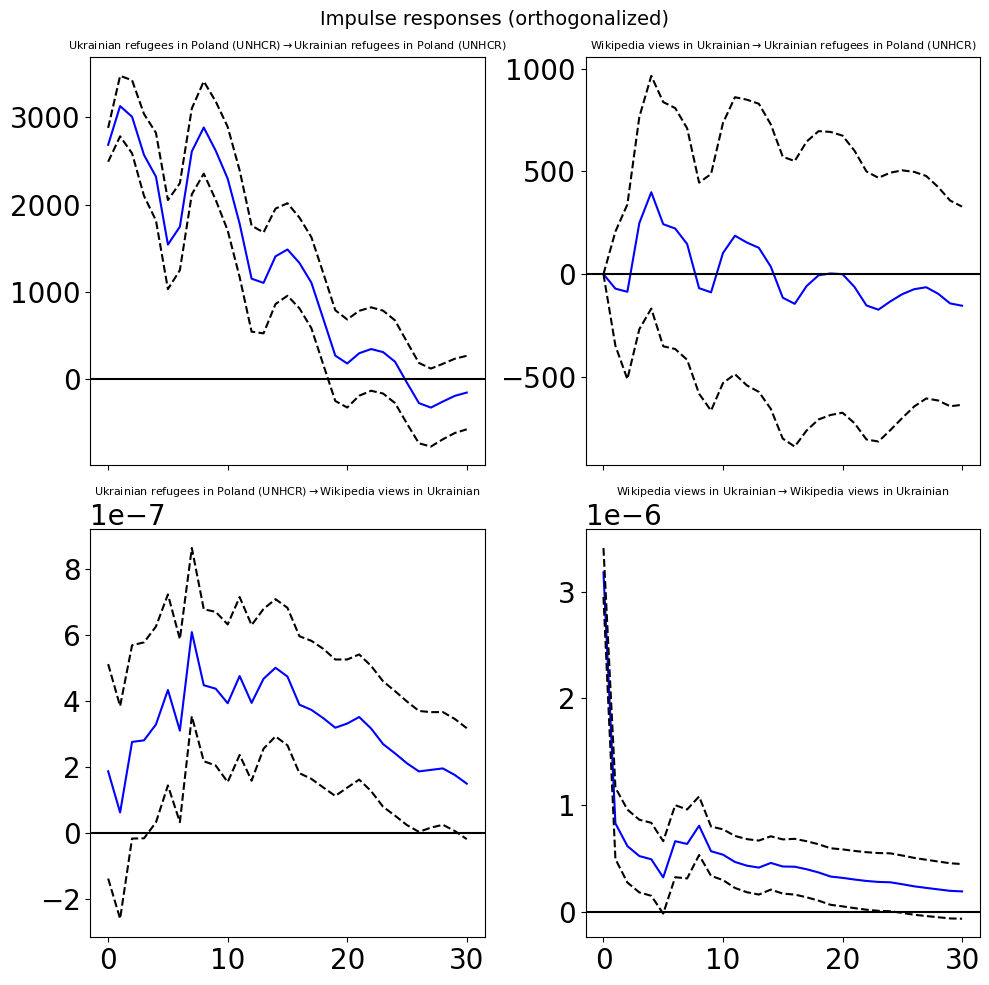

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    4.3188   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.0073   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0001   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.4301

Wrocław
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -10.94      -10.92   1.766e-05      -10.94
1       -12.80      -12.73   2.767e-06      -12.77
2       -12.85     -12.74*   2.613e-06      -12.81
3       -12.84      -12.68   2.655e-06      -12.78
4       -12.84      -12.64   2.665e-06      -12.76
5       -12.86      -12.61   2.612e-06      -12.76
6       -12.93      -12.64   2.420e-06     -12.82*
7       -12.91      -12.58   2.462e-06      -12.78
8      -12.95*      -12.57  2.382e-06*      -12.80
9       -12.93      -12.51   2.432e-06      -12.76
10      -12.91      -12.44   2.477e-06      -12.72
11      -12.89      -12.38   2.517e-06      -12.69
12      -12.88      -12.32   2.559e-06      -12.66
13      -12.86      -12.26   2.594e-06      -12.62
14      -12.87      -12.23   2.571e-06      -12.62
15   

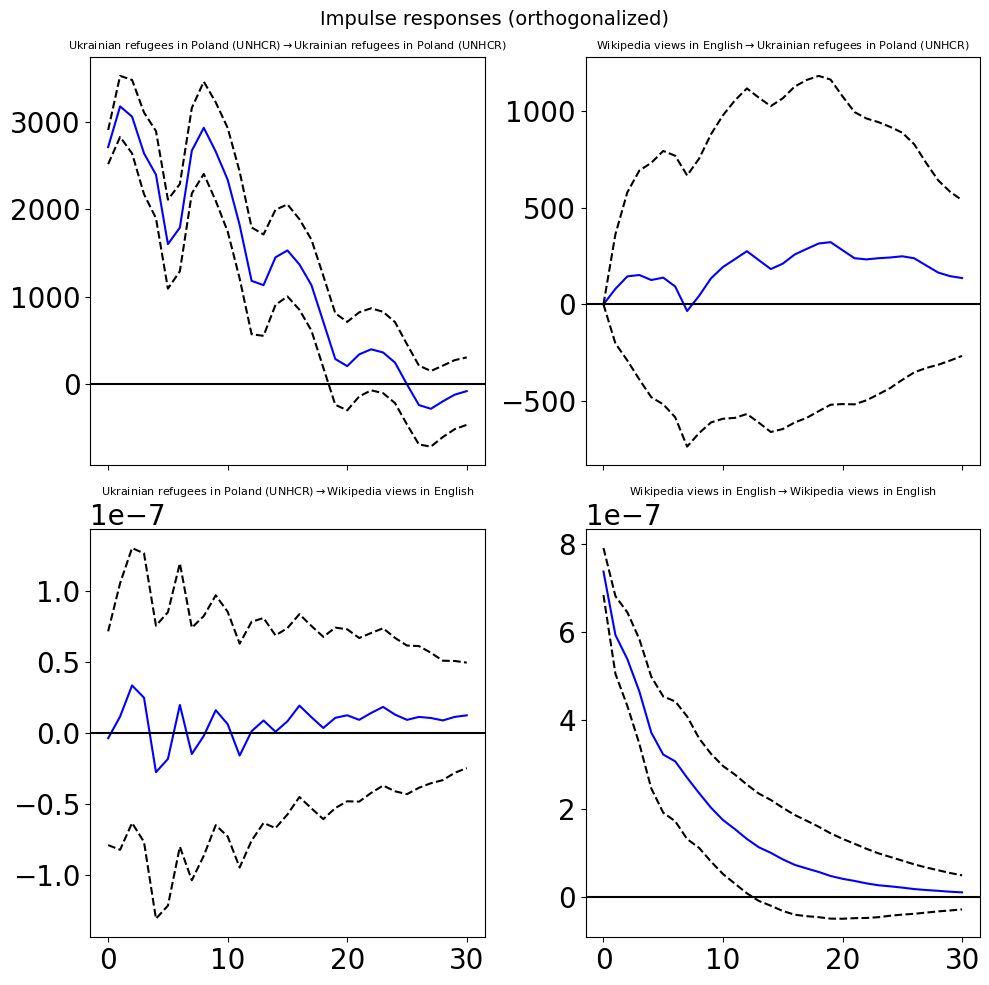

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.6674   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.2360   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.7202   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.9840

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -4.513      -4.491     0.01096      -4.504
1       -5.522      -5.455    0.003998      -5.495
2       -5.616     -5.505*    0.003640      -5.572
3       -5.630      -5.475    0.003587      -5.569
4       -5.619      -5.420    0.003628      -5.540
5       -5.650      -5.406    0.003517      -5.553
6       -5.732      -5.444    0.003239     -5.618*
7       -5.715      -5.382    0.003297      -5.582
8      -5.740*      -5.363   0.003216*      -5.590
9       -5.729      -5.307    0.003251      -5.561
10      -5.719      -5.253    0.003283      -5.534
11      -5.705      -5.195    0.003329      -5.502
12      -5.690      -5.135    0.003382      -5.469
13      -5.688      -5.089    0.003390      -5.449
14      -5.679      -5.035    0.003421      -5.423
15      -5.67

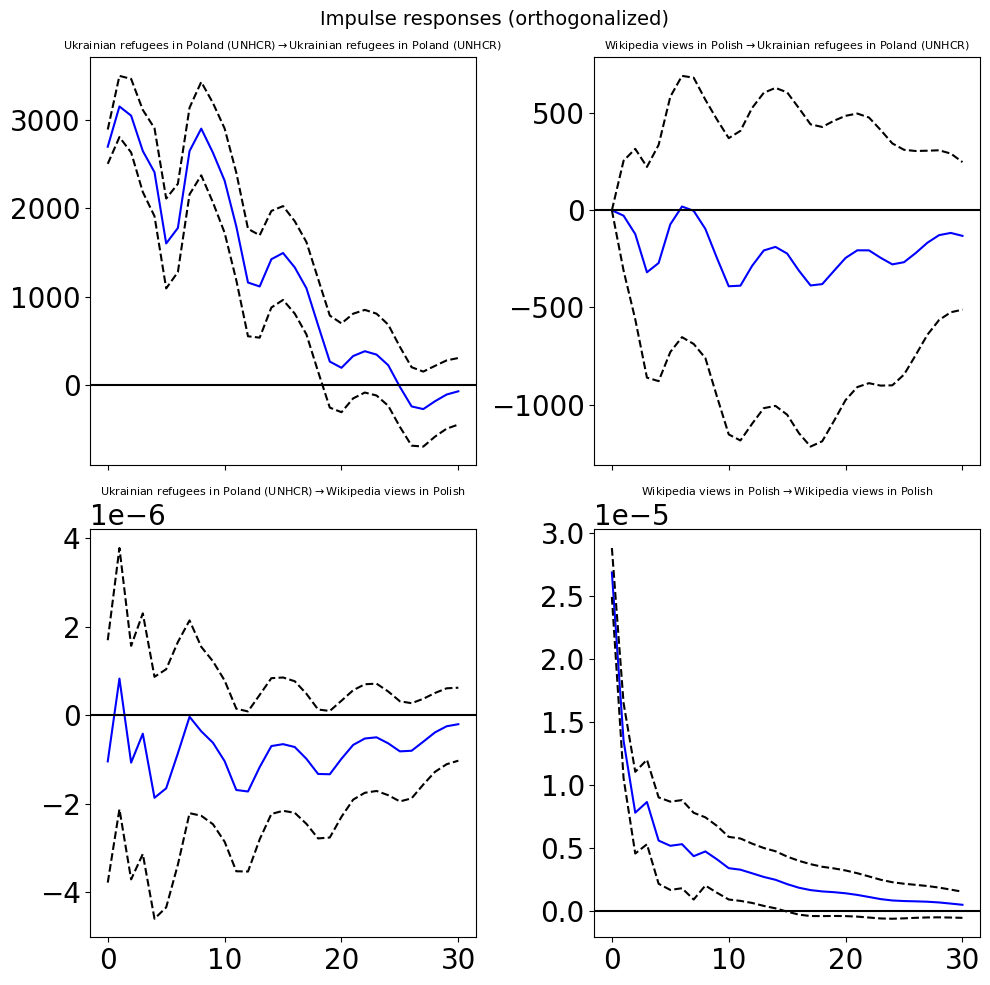

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.8468   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.5366   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.5619   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.8288

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -9.473      -9.451   7.690e-05      -9.464
1       -10.36      -10.29   3.168e-05      -10.33
2       -10.46     -10.35*   2.876e-05      -10.41
3       -10.49      -10.34   2.774e-05      -10.43
4       -10.49      -10.29   2.771e-05      -10.41
5       -10.50      -10.25   2.758e-05      -10.40
6       -10.59      -10.30   2.529e-05     -10.47*
7       -10.58      -10.25   2.531e-05      -10.45
8      -10.61*      -10.24  2.460e-05*      -10.46
9       -10.60      -10.17   2.503e-05      -10.43
10      -10.59      -10.12   2.519e-05      -10.40
11      -10.57      -10.06   2.566e-05      -10.37
12      -10.56      -10.01   2.591e-05      -10.34
13      -10.56      -9.961   2.595e-05      -10.32
14      -10.54      -9.900   2.639e-05      -10.29
15      -10.5

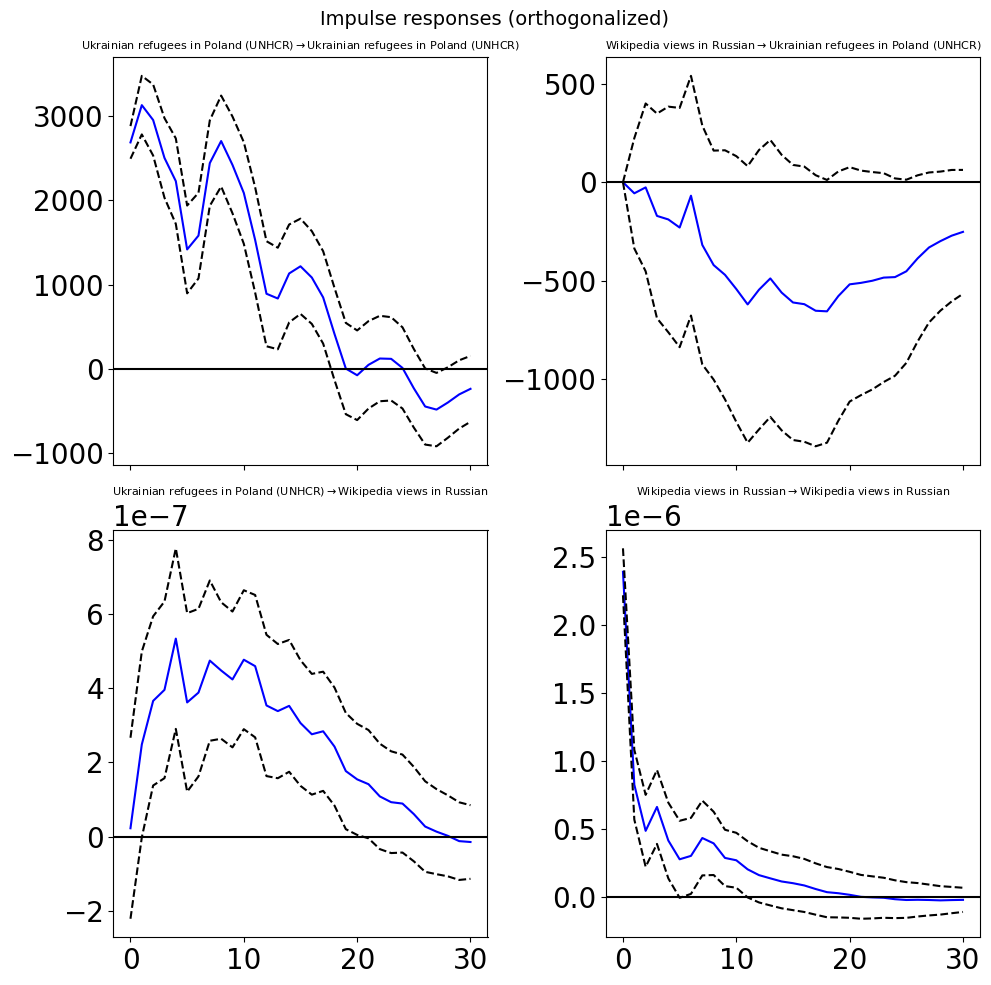

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    5.9403   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.9900   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.4434

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.624      -5.602    0.003611      -5.615
1       -7.324      -7.258   0.0006594      -7.298
2       -7.387      -7.276   0.0006191      -7.343
3       -7.441      -7.286   0.0005866      -7.379
4       -7.461      -7.262   0.0005748      -7.382
5       -7.569      -7.325   0.0005160      -7.472
6       -7.742      -7.453   0.0004344      -7.627
7       -7.800      -7.467   0.0004100      -7.667
8       -7.866     -7.489*   0.0003837     -7.716*
9       -7.874      -7.452   0.0003806      -7.706
10      -7.868      -7.402   0.0003828      -7.683
11      -7.857      -7.347   0.0003871      -7.654
12      -7.853      -7.298   0.0003887      -7.632
13      -7.891      -7.292   0.0003744      -7.652
14      -7.900      -7.256   0.0003711      -7.644
15      -7.97

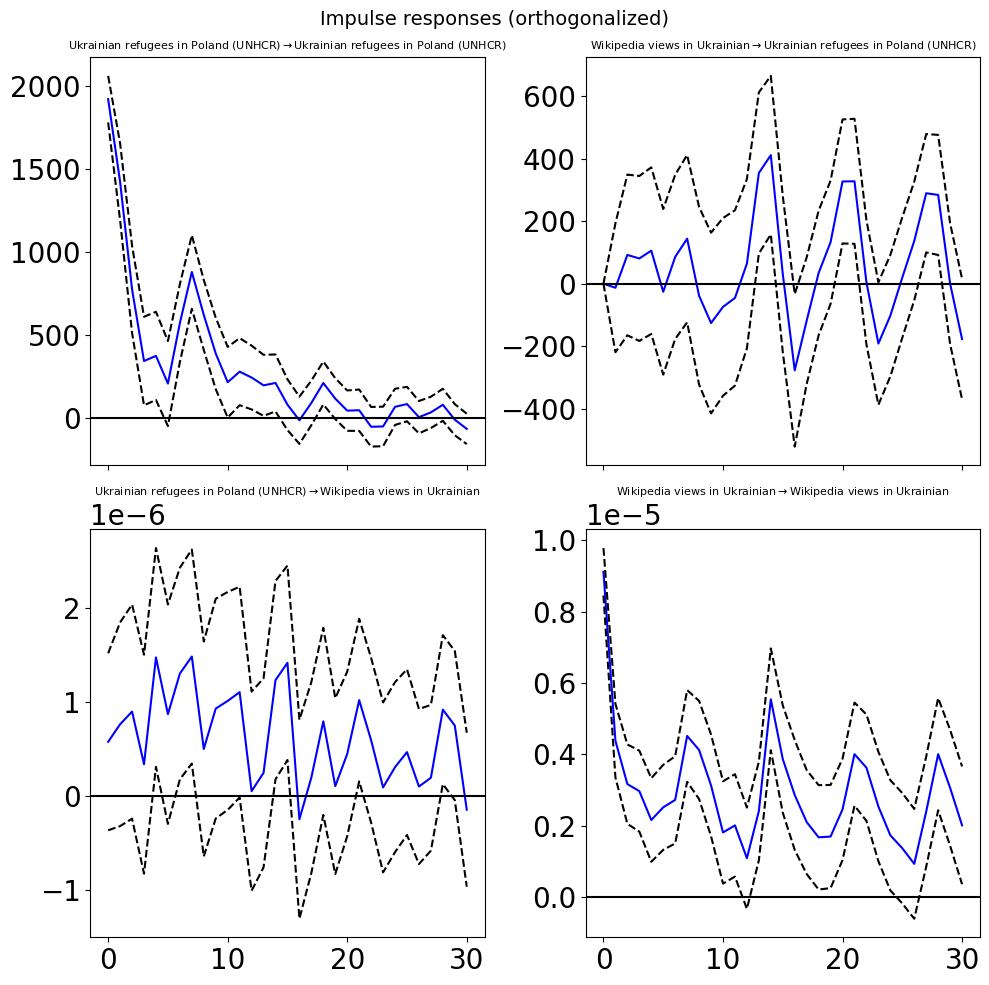

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
17                                   2.8308   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
17                                   2.9973   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
17                                   0.0002   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
17                                   0.0001

Radom
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -15.90      -15.87   1.249e-07      -15.89
1       -16.47      -16.40   7.023e-08      -16.44
2       -16.53     -16.42*   6.601e-08      -16.49
3       -16.54      -16.38   6.575e-08      -16.48
4       -16.56      -16.36   6.442e-08      -16.48
5       -16.59      -16.35   6.241e-08      -16.49
6       -16.68      -16.39   5.707e-08     -16.56*
7       -16.66      -16.33   5.794e-08      -16.53
8      -16.69*      -16.32  5.625e-08*      -16.54
9       -16.68      -16.25   5.723e-08      -16.51
10      -16.66      -16.19   5.846e-08      -16.47
11      -16.64      -16.13   5.919e-08      -16.44
12      -16.63      -16.08   5.968e-08      -16.41
13      -16.62      -16.02   6.043e-08      -16.38
14      -16.62      -15.97   6.080e-08      -16.36
15     

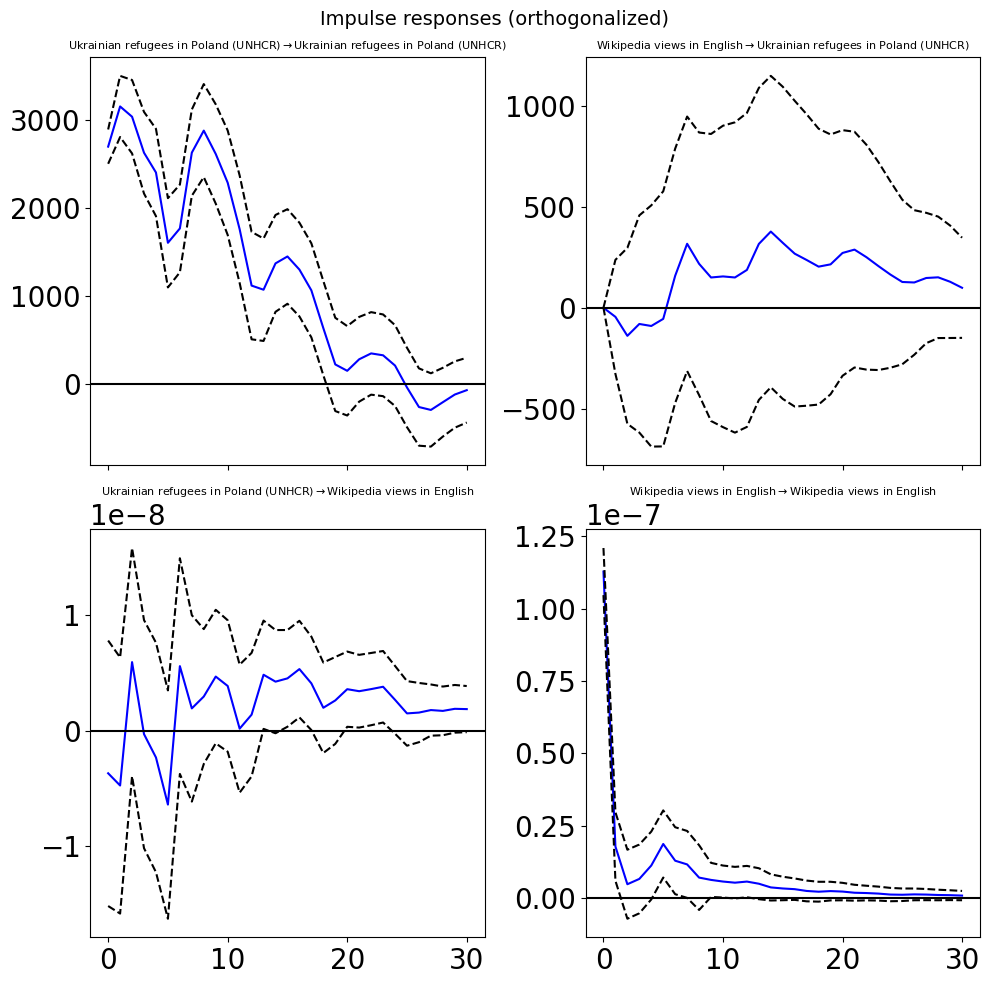

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    1.3482   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.4613   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.2184   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.8829

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.771      -6.749    0.001146      -6.762
1       -7.752      -7.685   0.0004300      -7.725
2       -7.873      -7.762   0.0003807      -7.829
3       -7.933     -7.778*   0.0003586      -7.871
4       -7.960      -7.761   0.0003490      -7.881
5       -7.972      -7.728   0.0003449      -7.875
6       -8.045      -7.757   0.0003207      -7.930
7       -8.065      -7.732   0.0003144      -7.933
8      -8.100*      -7.723  0.0003037*     -7.950*
9       -8.083      -7.662   0.0003087      -7.916
10      -8.074      -7.608   0.0003118      -7.888
11      -8.062      -7.552   0.0003155      -7.859
12      -8.064      -7.510   0.0003147      -7.843
13      -8.052      -7.453   0.0003186      -7.814
14      -8.048      -7.404   0.0003200      -7.792
15      -8.05

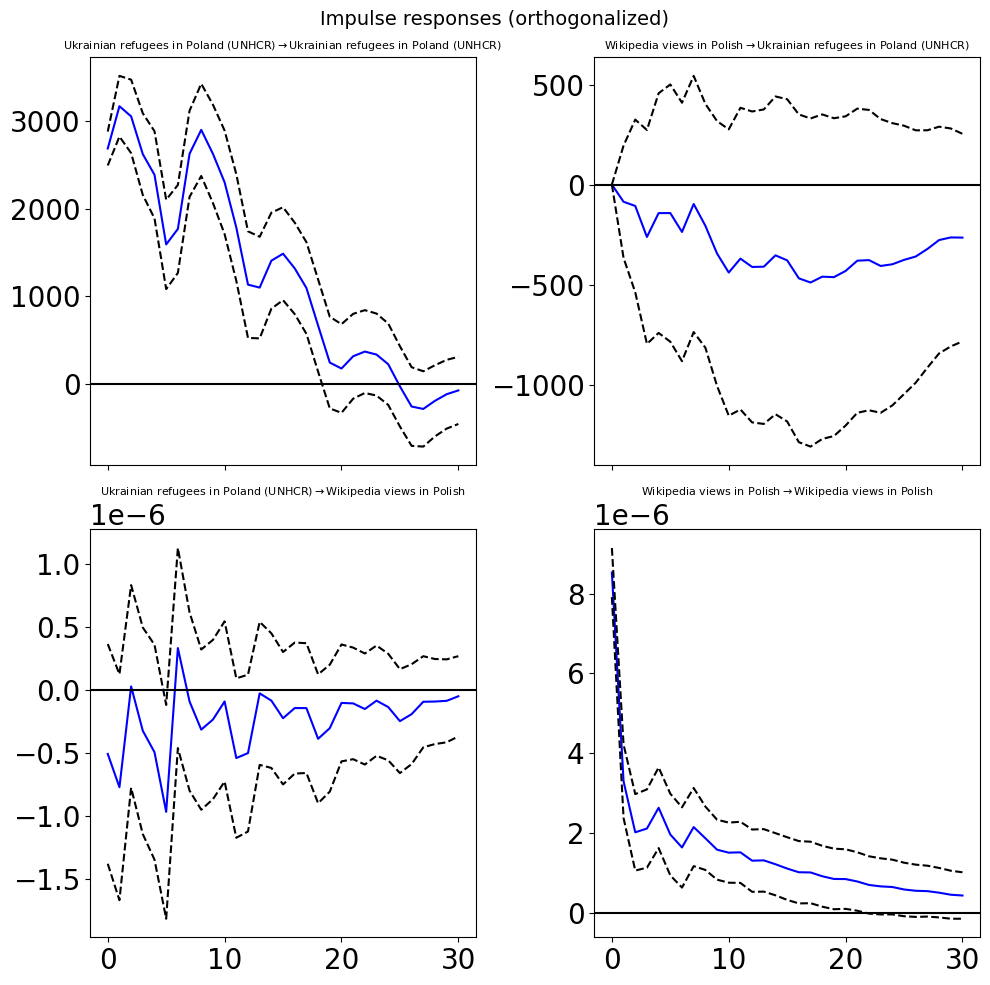

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    1.2716   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.8702   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.2571   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.5418

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -13.36      -13.33   1.584e-06      -13.35
1       -14.07      -14.01   7.733e-07      -14.05
2       -14.15     -14.04*   7.133e-07      -14.11
3       -14.16      -14.01   7.065e-07      -14.10
4       -14.16      -13.96   7.114e-07      -14.08
5       -14.20      -13.95   6.834e-07      -14.10
6       -14.30      -14.01   6.189e-07     -14.18*
7       -14.28      -13.95   6.295e-07      -14.15
8      -14.31*      -13.93  6.122e-07*      -14.16
9       -14.28      -13.86   6.264e-07      -14.12
10      -14.27      -13.80   6.381e-07      -14.08
11      -14.26      -13.75   6.402e-07      -14.06
12      -14.26      -13.70   6.436e-07      -14.04
13      -14.25      -13.65   6.478e-07      -14.01
14      -14.24      -13.60   6.534e-07      -13.99
15      -14.2

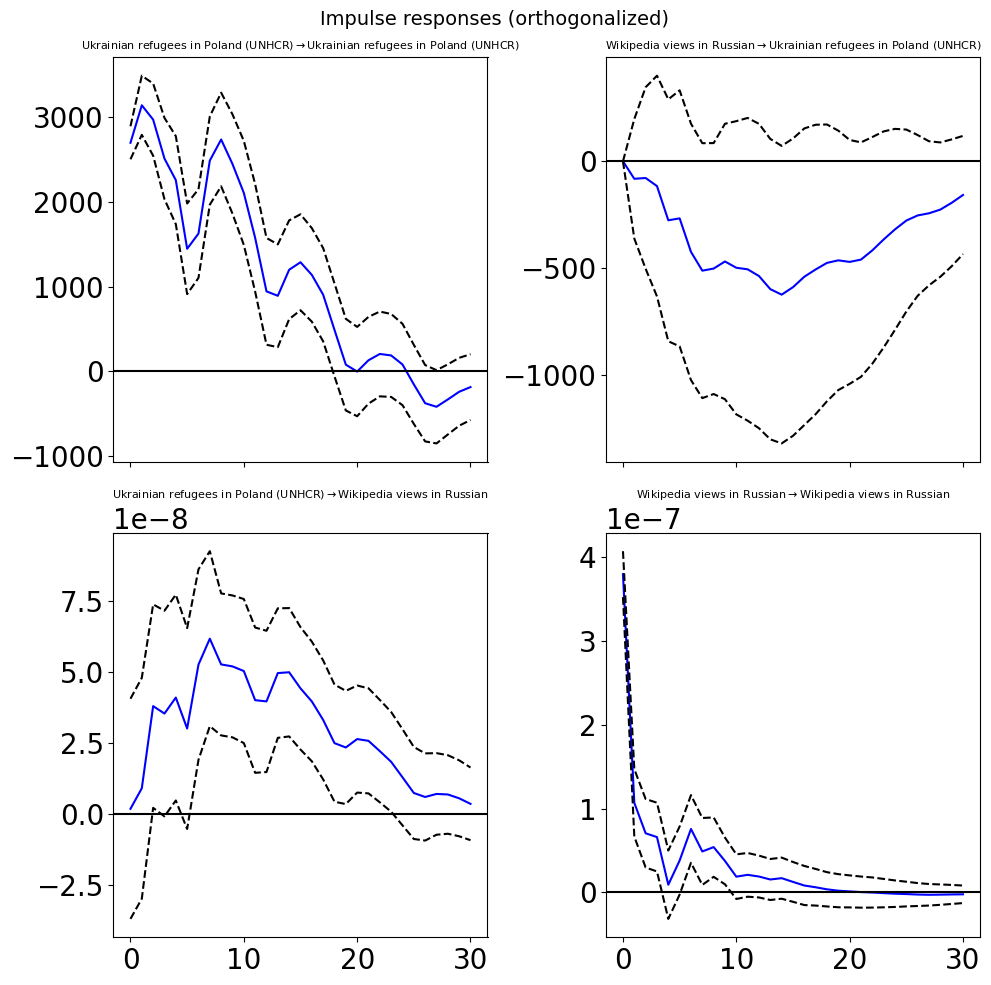

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    5.6661   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.6140   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.7661

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -9.229      -9.207   9.811e-05      -9.221
1       -10.05      -9.988   4.300e-05      -10.03
2       -10.18      -10.07   3.789e-05      -10.14
3       -10.26      -10.10   3.516e-05      -10.19
4       -10.27      -10.07   3.473e-05      -10.19
5       -10.30      -10.06   3.351e-05      -10.21
6       -10.40     -10.11*   3.033e-05      -10.29
7       -10.43      -10.10   2.943e-05      -10.30
8       -10.48      -10.10   2.813e-05     -10.33*
9       -10.47      -10.04   2.852e-05      -10.30
10      -10.47      -9.999   2.853e-05      -10.28
11      -10.45      -9.940   2.895e-05      -10.25
12      -10.45      -9.892   2.906e-05      -10.23
13      -10.44      -9.840   2.927e-05      -10.20
14      -10.45      -9.802   2.911e-05      -10.19
15     -10.48

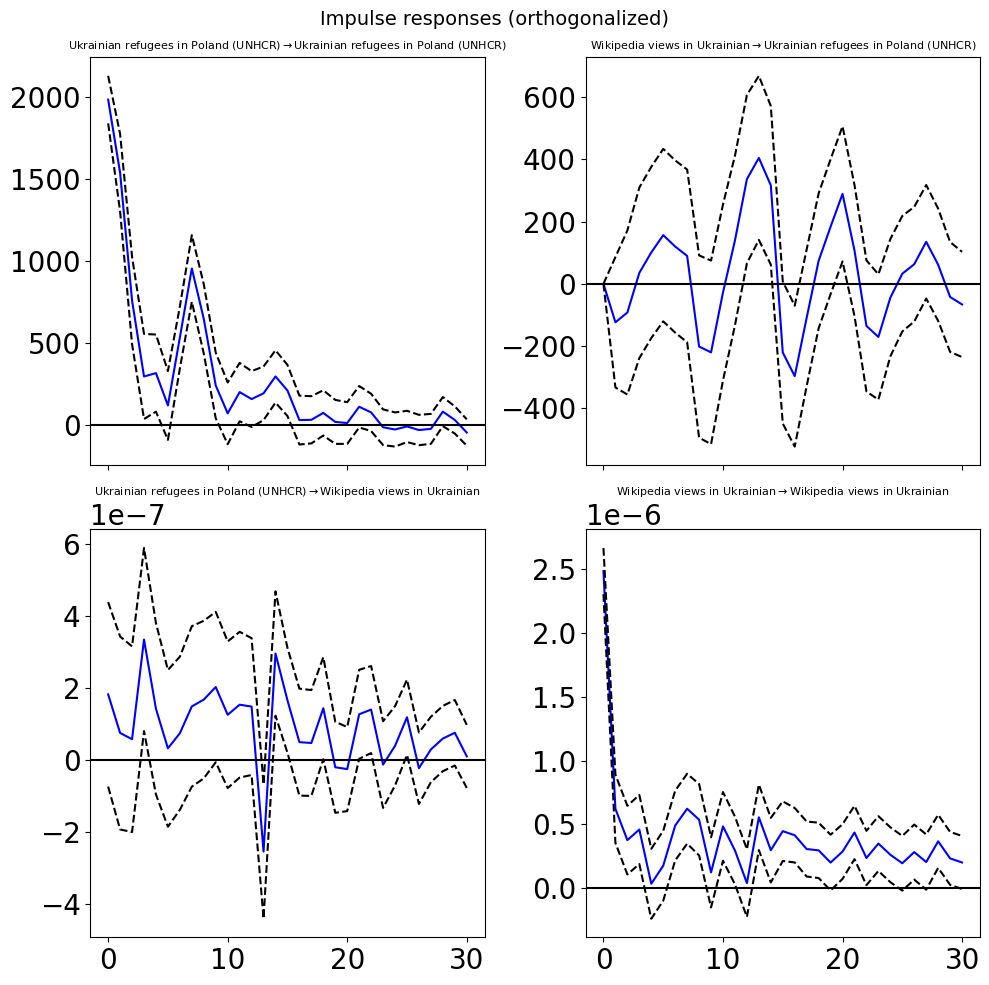

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
15                                   2.4844   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
15                                   1.9812   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
15                                   0.0018   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
15                                   0.0160

Częstochowa
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -14.76      -14.73   3.905e-07      -14.75
1       -15.67      -15.61   1.561e-07      -15.65
2       -15.76     -15.65*   1.430e-07      -15.72
3       -15.75      -15.60   1.441e-07      -15.69
4       -15.75      -15.55   1.440e-07      -15.67
5       -15.79      -15.54   1.394e-07      -15.69
6       -15.92      -15.63   1.225e-07      -15.80
7       -15.97      -15.64   1.156e-07      -15.84
8      -16.02*      -15.64  1.104e-07*     -15.87*
9       -16.00      -15.58   1.125e-07      -15.83
10      -15.98      -15.52   1.144e-07      -15.80
11      -15.97      -15.46   1.165e-07      -15.76
12      -15.97      -15.41   1.165e-07      -15.75
13      -15.96      -15.36   1.174e-07      -15.72
14      -15.95      -15.31   1.182e-07      -15.70
1

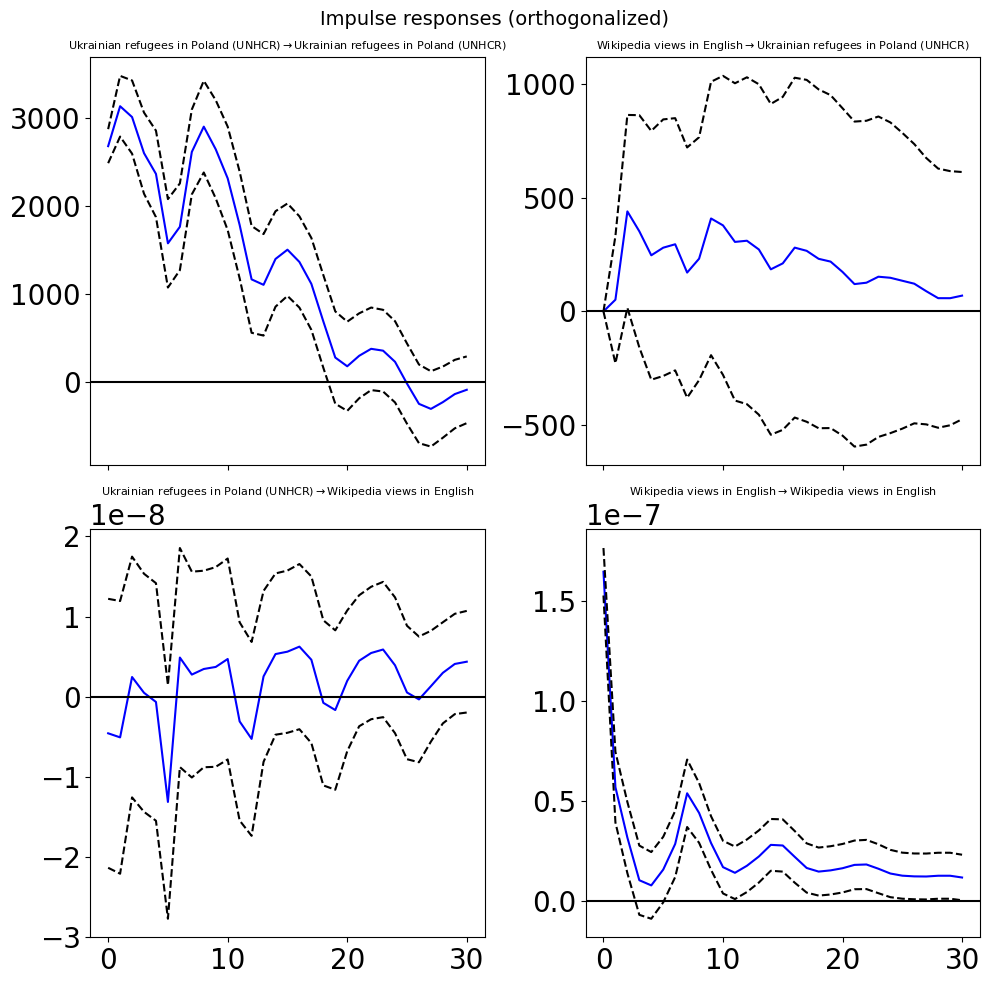

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.8848   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.1671   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.5293   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.3182

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.051      -6.029    0.002355      -6.042
1       -6.970      -6.904   0.0009396      -6.944
2       -7.038      -6.927   0.0008782      -6.993
3       -7.078      -6.922   0.0008438      -7.016
4       -7.093      -6.893   0.0008310      -7.013
5       -7.115      -6.871   0.0008128      -7.018
6       -7.220      -6.932   0.0007317      -7.105
7       -7.298     -6.965*   0.0006768      -7.166
8      -7.340*      -6.962  0.0006494*     -7.189*
9       -7.324      -6.902   0.0006597      -7.156
10      -7.307      -6.841   0.0006711      -7.121
11      -7.288      -6.778   0.0006838      -7.085
12      -7.275      -6.720   0.0006932      -7.054
13      -7.264      -6.665   0.0007010      -7.025
14      -7.265      -6.622   0.0006999      -7.009
15      -7.26

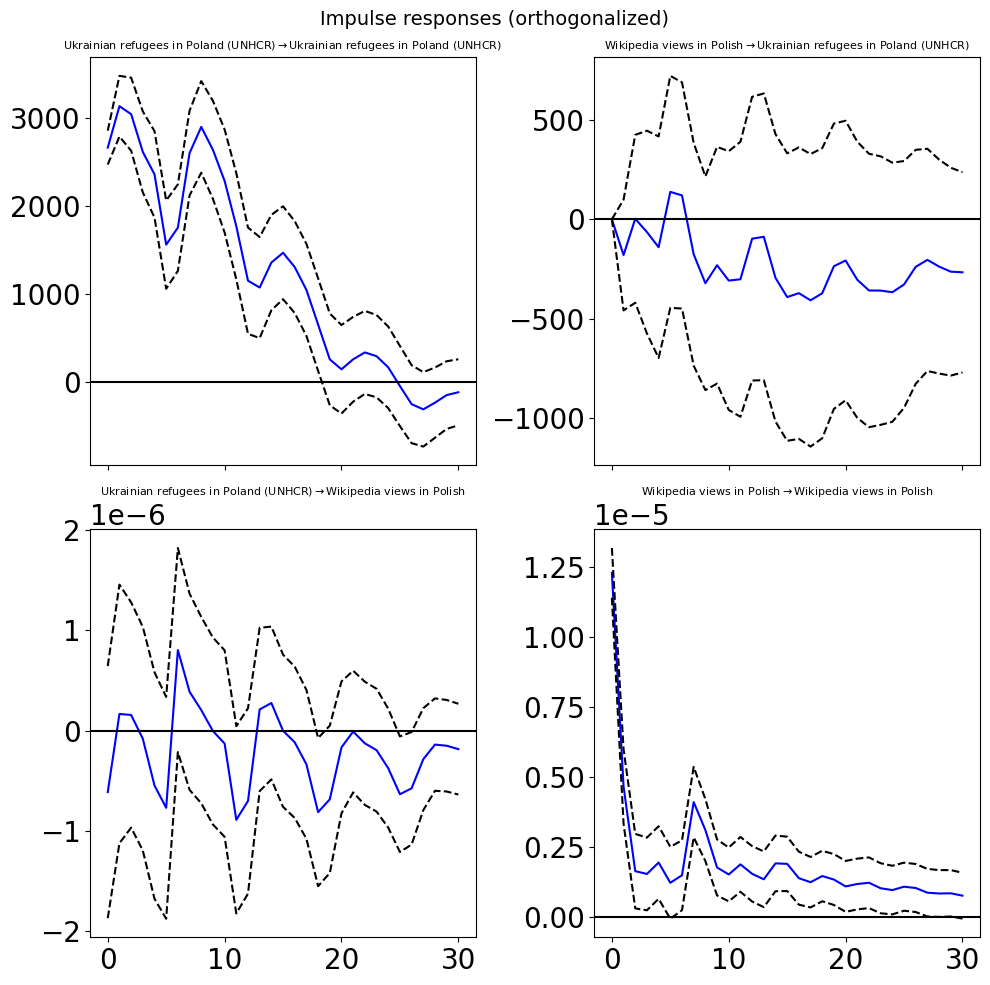

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    1.3331   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.7275   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.2257   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0908

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -11.85      -11.83   7.128e-06      -11.84
1       -12.80      -12.73   2.774e-06      -12.77
2       -12.91     -12.80*   2.479e-06      -12.86
3       -12.92      -12.77   2.440e-06      -12.86
4       -12.94      -12.74   2.402e-06      -12.86
5       -12.94      -12.69   2.405e-06      -12.84
6       -13.05      -12.76   2.151e-06      -12.93
7       -13.07      -12.74   2.111e-06      -12.94
8      -13.11*      -12.74  2.015e-06*     -12.96*
9       -13.10      -12.67   2.056e-06      -12.93
10      -13.10      -12.63   2.054e-06      -12.91
11      -13.09      -12.58   2.064e-06      -12.89
12      -13.08      -12.53   2.087e-06      -12.86
13      -13.07      -12.47   2.109e-06      -12.83
14      -13.06      -12.42   2.120e-06      -12.81
15      -13.0

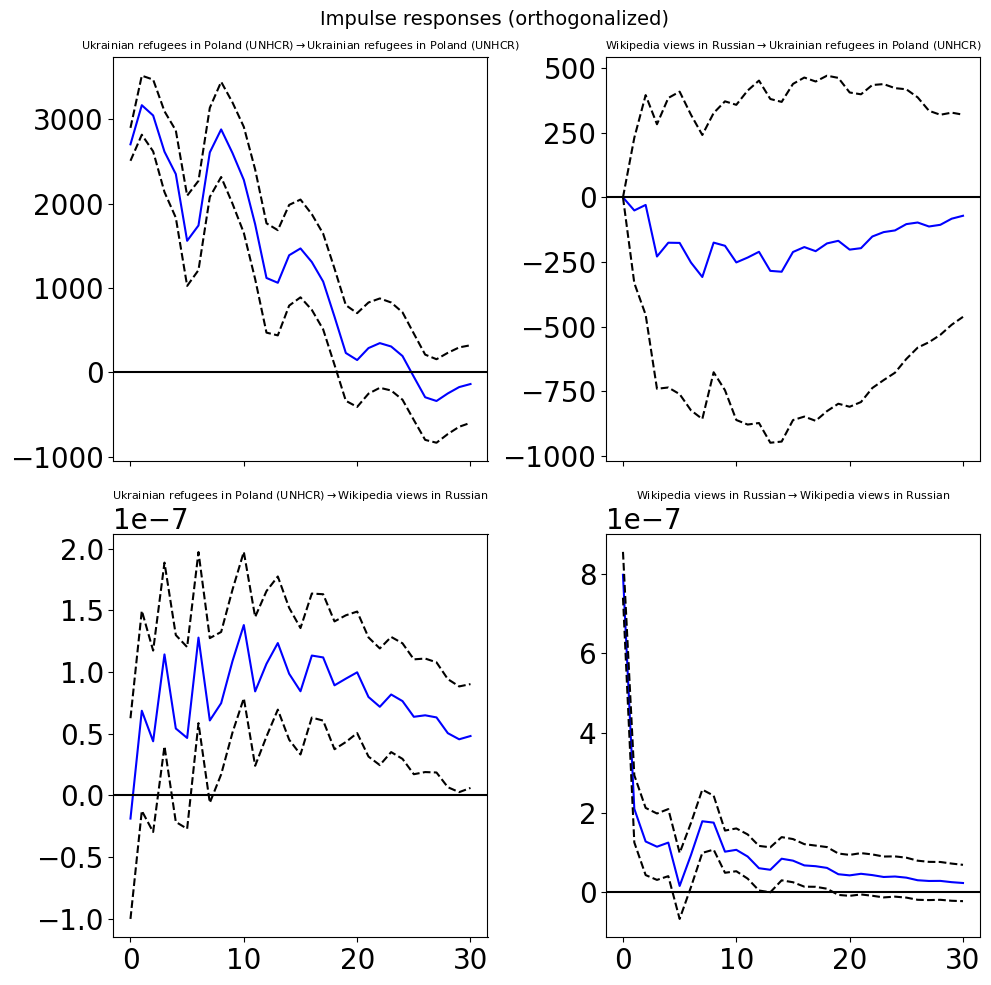

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    5.7896   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.4847   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.8670

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -7.933      -7.911   0.0003586      -7.925
1       -9.018      -8.951   0.0001212      -8.991
2       -9.125      -9.014   0.0001090      -9.080
3       -9.118      -8.963   0.0001096      -9.057
4       -9.175      -8.975   0.0001036      -9.095
5       -9.189      -8.945   0.0001022      -9.091
6       -9.316     -9.028*   8.998e-05      -9.201
7       -9.353      -9.020   8.675e-05      -9.220
8      -9.389*      -9.011  8.369e-05*     -9.238*
9       -9.379      -8.958   8.447e-05      -9.211
10      -9.365      -8.899   8.572e-05      -9.179
11      -9.365      -8.855   8.569e-05      -9.162
12      -9.360      -8.805   8.614e-05      -9.139
13      -9.353      -8.754   8.678e-05      -9.114
14      -9.341      -8.698   8.779e-05      -9.085
15      -9.33

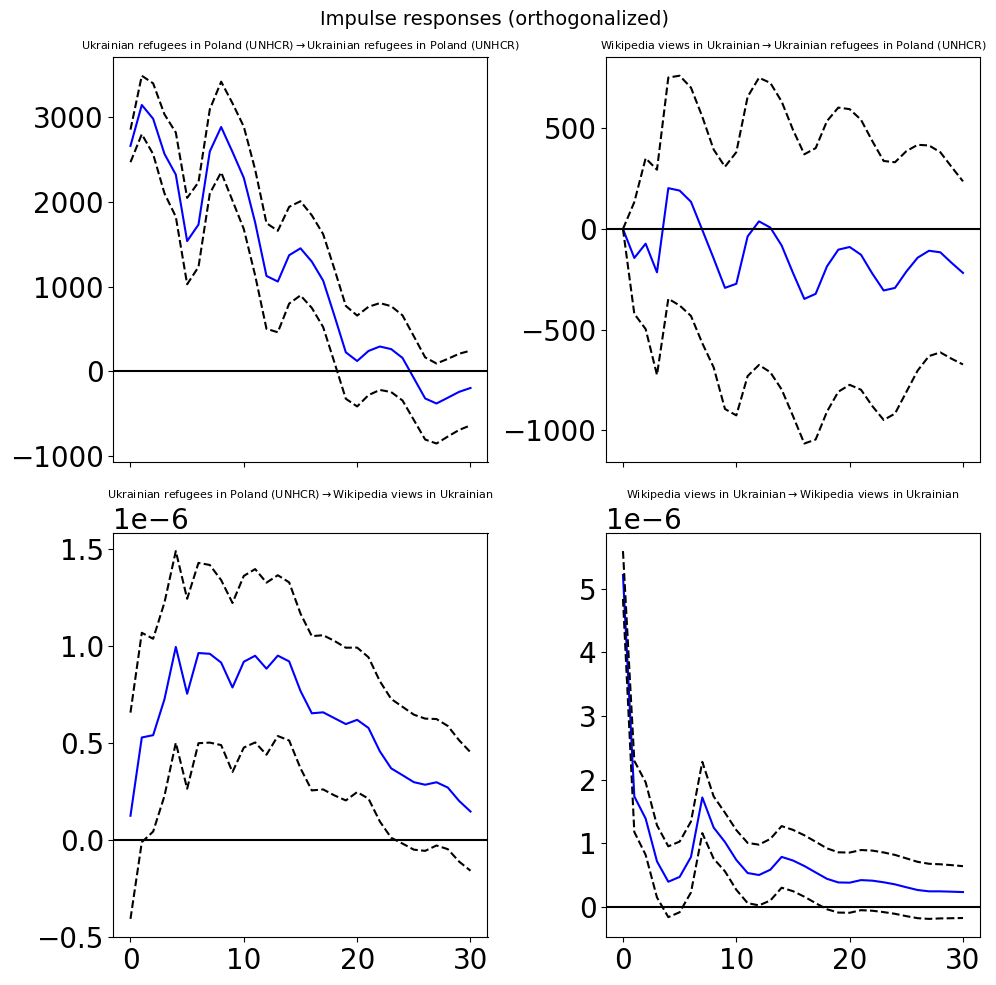

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    5.4890   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.8406   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0686

Rzeszów
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -12.71      -12.69   3.029e-06      -12.70
1       -14.37      -14.30   5.751e-07      -14.34
2       -14.44     -14.33*   5.367e-07      -14.39
3       -14.45      -14.30   5.280e-07      -14.39
4       -14.46      -14.26   5.241e-07      -14.38
5       -14.47      -14.23   5.184e-07      -14.38
6       -14.58      -14.29   4.664e-07     -14.46*
7       -14.58      -14.25   4.649e-07      -14.45
8      -14.61*      -14.23  4.534e-07*      -14.46
9       -14.60      -14.18   4.565e-07      -14.43
10      -14.59      -14.12   4.630e-07      -14.40
11      -14.58      -14.07   4.674e-07      -14.37
12      -14.57      -14.02   4.688e-07      -14.35
13      -14.57      -13.97   4.694e-07      -14.33
14      -14.59      -13.94   4.626e-07      -14.33
15   

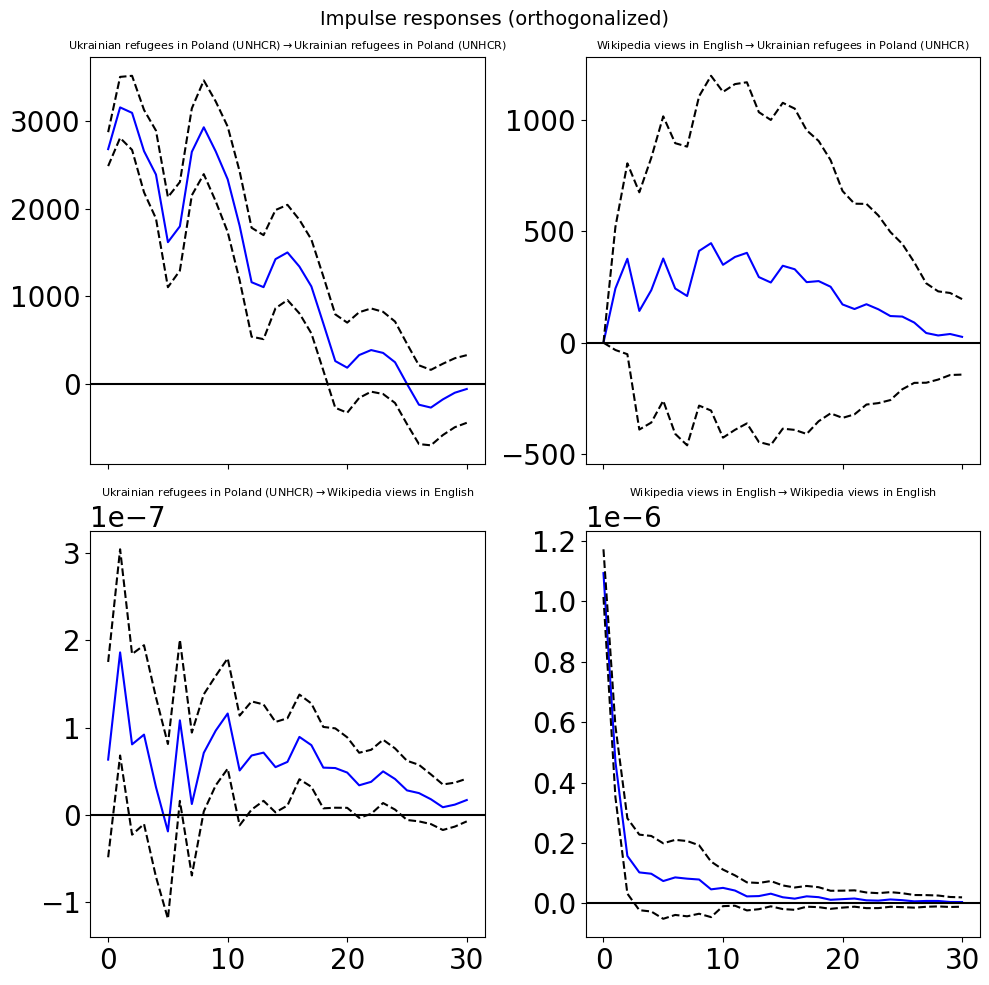

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    2.9978   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.2449   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.0029   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.2718

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.473      -5.451    0.004199      -5.464
1       -6.401      -6.334    0.001660      -6.374
2       -6.489     -6.379*    0.001519      -6.445
3       -6.527      -6.372    0.001463      -6.465
4       -6.520      -6.321    0.001473      -6.441
5       -6.551      -6.307    0.001429      -6.453
6       -6.630      -6.342    0.001320     -6.516*
7       -6.625      -6.293    0.001326      -6.493
8      -6.657*      -6.280   0.001285*      -6.507
9       -6.639      -6.217    0.001309      -6.471
10      -6.627      -6.161    0.001324      -6.442
11      -6.635      -6.124    0.001315      -6.431
12      -6.624      -6.070    0.001329      -6.403
13      -6.629      -6.030    0.001323      -6.390
14      -6.622      -5.979    0.001331      -6.366
15      -6.60

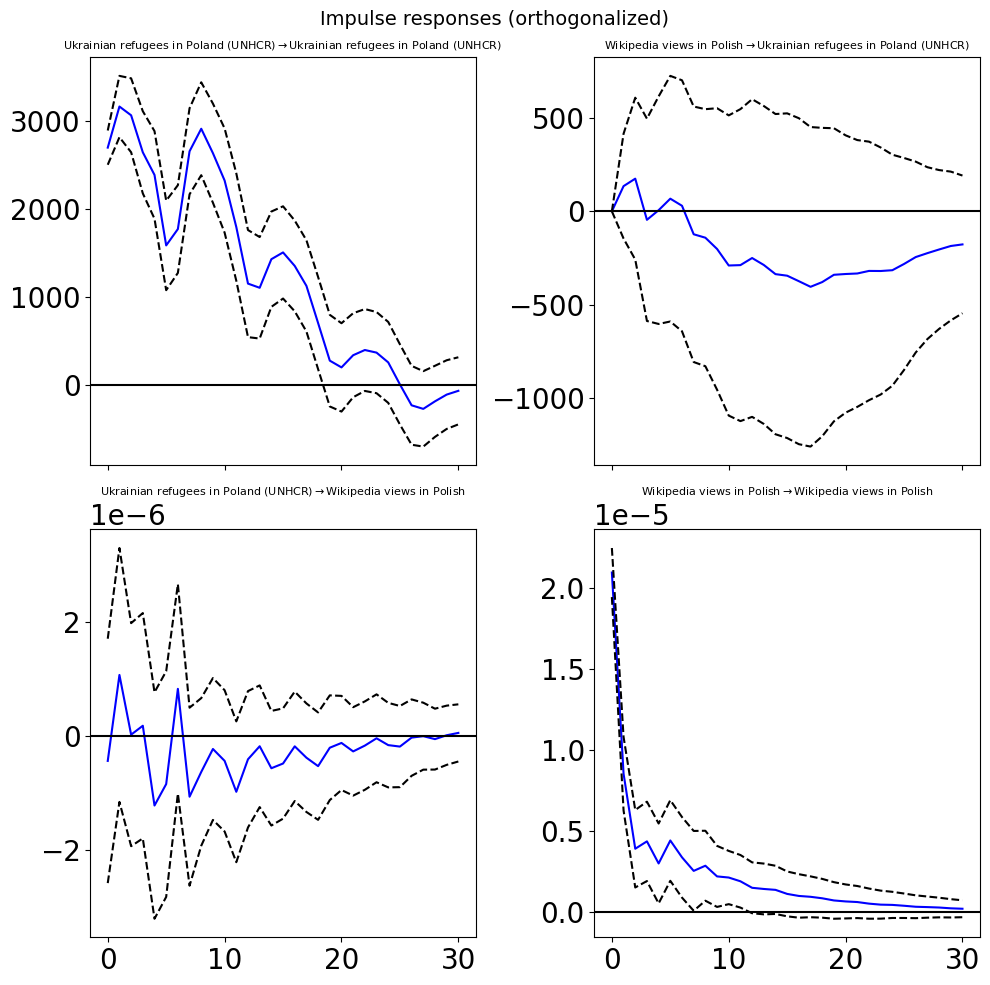

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.9109   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.7014   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.5074   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.6903

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -8.593      -8.571   0.0001854      -8.584
1       -9.299      -9.232   9.153e-05      -9.272
2       -9.358     -9.247*   8.626e-05     -9.314*
3       -9.347      -9.192   8.724e-05      -9.285
4       -9.336      -9.137   8.818e-05      -9.257
5       -9.339      -9.095   8.794e-05      -9.242
6       -9.425      -9.136   8.071e-05      -9.310
7       -9.416      -9.083   8.142e-05      -9.284
8      -9.435*      -9.058  7.986e-05*      -9.285
9       -9.416      -8.995   8.142e-05      -9.248
10      -9.402      -8.936   8.257e-05      -9.217
11      -9.389      -8.879   8.364e-05      -9.186
12      -9.376      -8.821   8.482e-05      -9.155
13      -9.365      -8.766   8.575e-05      -9.126
14      -9.378      -8.735   8.461e-05      -9.122
15      -9.36

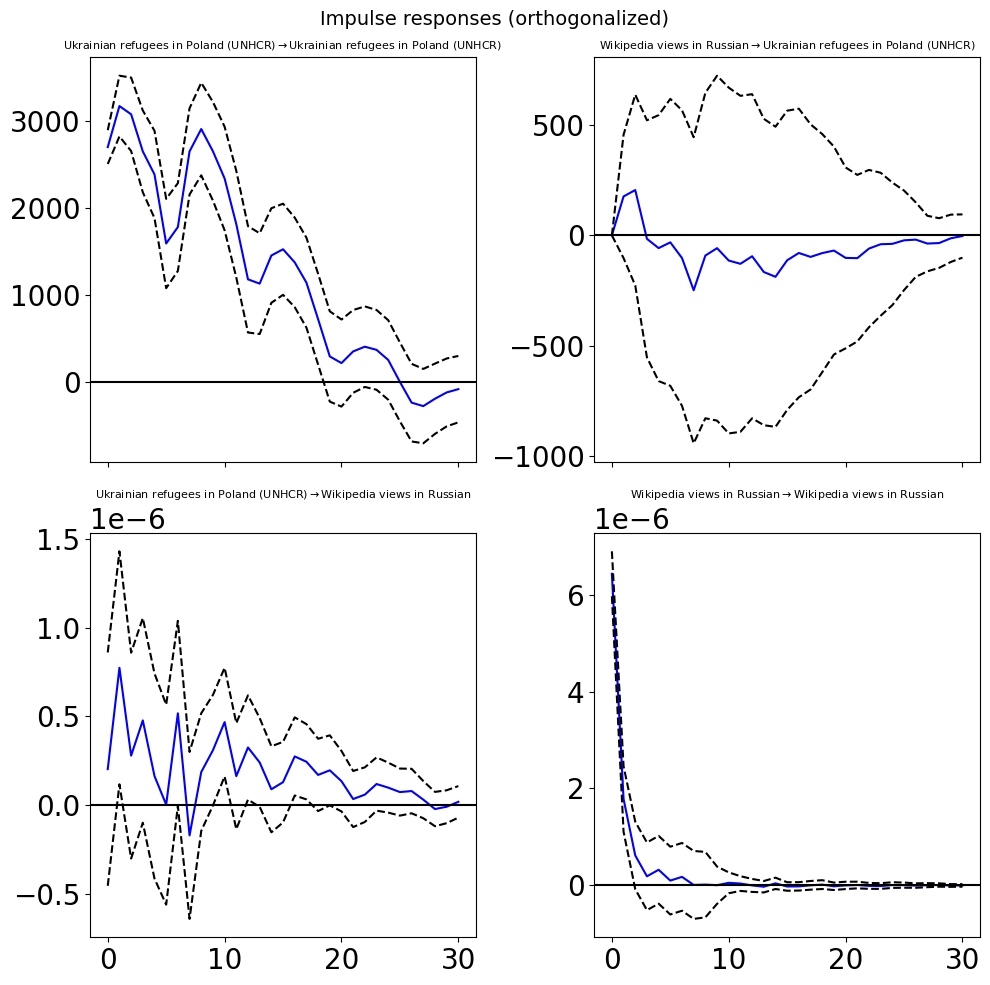

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    2.4445   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.6958   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0139   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.6953

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.326      -5.304    0.004865      -5.317
1       -5.991      -5.924    0.002501      -5.964
2       -6.048     -5.937*    0.002362     -6.004*
3       -6.033      -5.877    0.002399      -5.971
4       -6.030      -5.830    0.002406      -5.950
5       -6.032      -5.788    0.002400      -5.935
6       -6.113      -5.825    0.002213      -5.999
7       -6.097      -5.765    0.002249      -5.965
8      -6.122*      -5.745   0.002195*      -5.972
9       -6.104      -5.682    0.002234      -5.936
10      -6.088      -5.622    0.002272      -5.902
11      -6.075      -5.565    0.002300      -5.872
12      -6.068      -5.514    0.002316      -5.847
13      -6.060      -5.461    0.002337      -5.821
14      -6.052      -5.409    0.002354      -5.796
15      -6.04

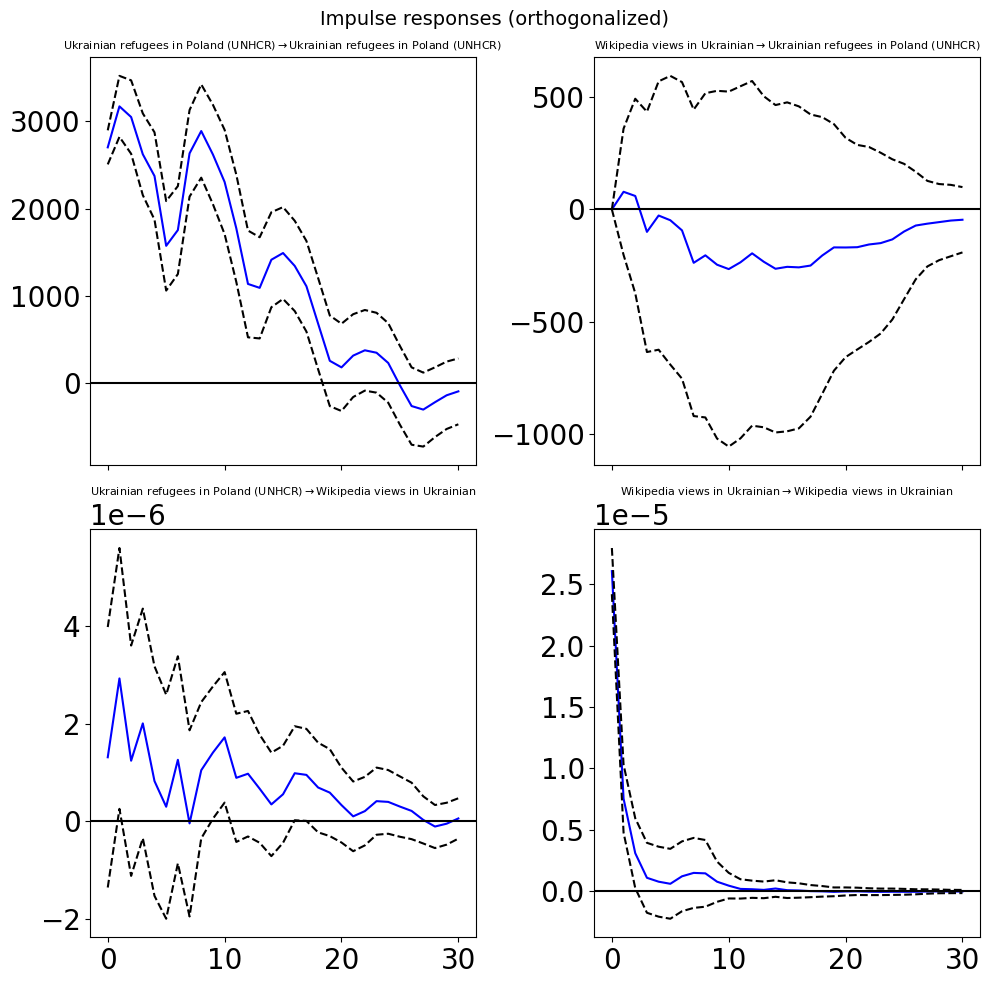

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    1.5555   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.4189   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.1370   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.9095

Poznań
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -13.24      -13.22   1.770e-06      -13.24
1       -13.96      -13.89   8.694e-07      -13.93
2       -14.02     -13.91*   8.138e-07      -13.98
3       -14.03      -13.88   8.053e-07      -13.97
4       -14.09      -13.89   7.572e-07      -14.01
5       -14.10      -13.85   7.537e-07      -14.00
6       -14.18      -13.89   6.939e-07      -14.07
7       -14.19      -13.86   6.863e-07      -14.06
8      -14.22*      -13.84  6.680e-07*     -14.07*
9       -14.20      -13.78   6.800e-07      -14.03
10      -14.18      -13.72   6.918e-07      -14.00
11      -14.17      -13.66   7.031e-07      -13.96
12      -14.16      -13.61   7.087e-07      -13.94
13      -14.16      -13.56   7.113e-07      -13.92
14      -14.15      -13.50   7.188e-07      -13.89
15    

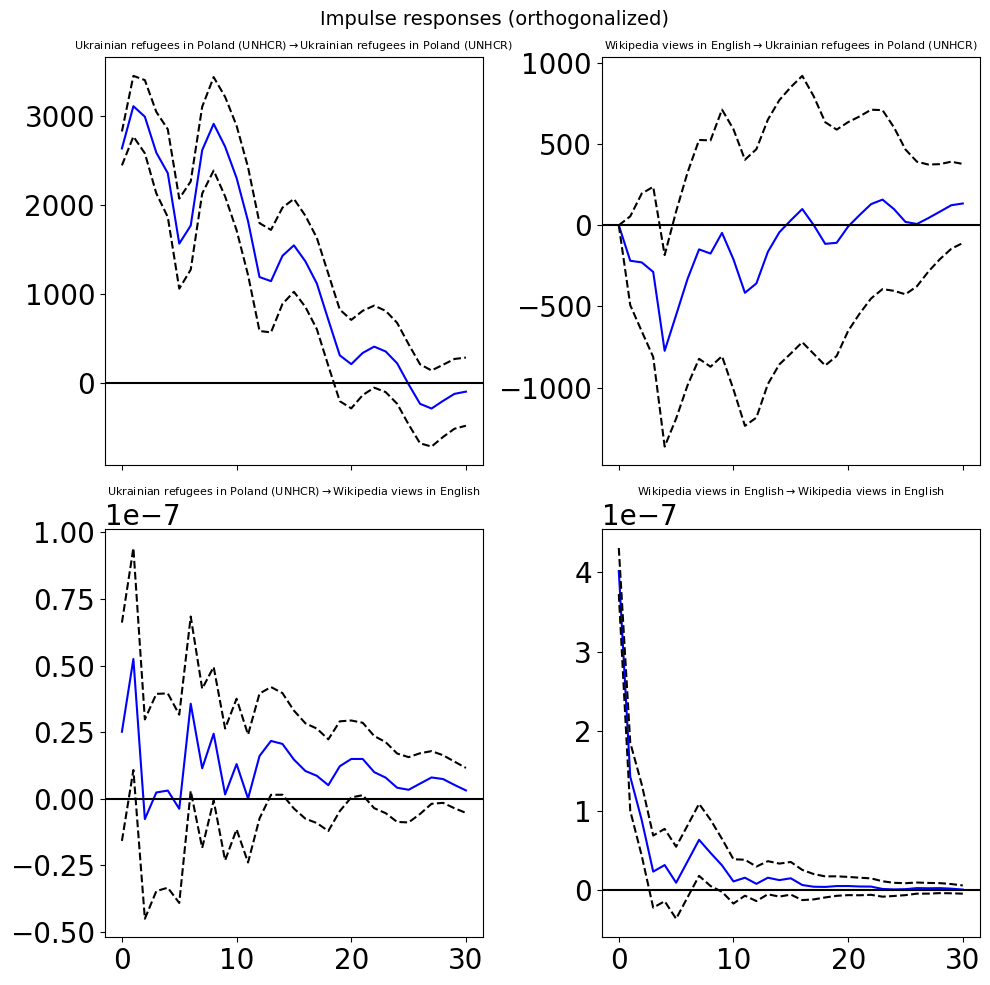

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    1.7454   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    2.6507   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.0869   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.0078

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -4.738      -4.716    0.008755      -4.729
1       -5.441      -5.374    0.004336      -5.414
2       -5.553      -5.442    0.003875      -5.509
3       -5.599      -5.444    0.003700      -5.538
4       -5.631      -5.431    0.003586      -5.551
5       -5.666      -5.422    0.003463      -5.569
6       -5.741     -5.452*    0.003213      -5.626
7       -5.743      -5.410    0.003207      -5.610
8      -5.790*      -5.413   0.003058*     -5.640*
9       -5.769      -5.347    0.003125      -5.601
10      -5.750      -5.284    0.003184      -5.564
11      -5.743      -5.232    0.003207      -5.540
12      -5.731      -5.176    0.003246      -5.510
13      -5.717      -5.117    0.003293      -5.478
14      -5.703      -5.059    0.003340      -5.446
15      -5.69

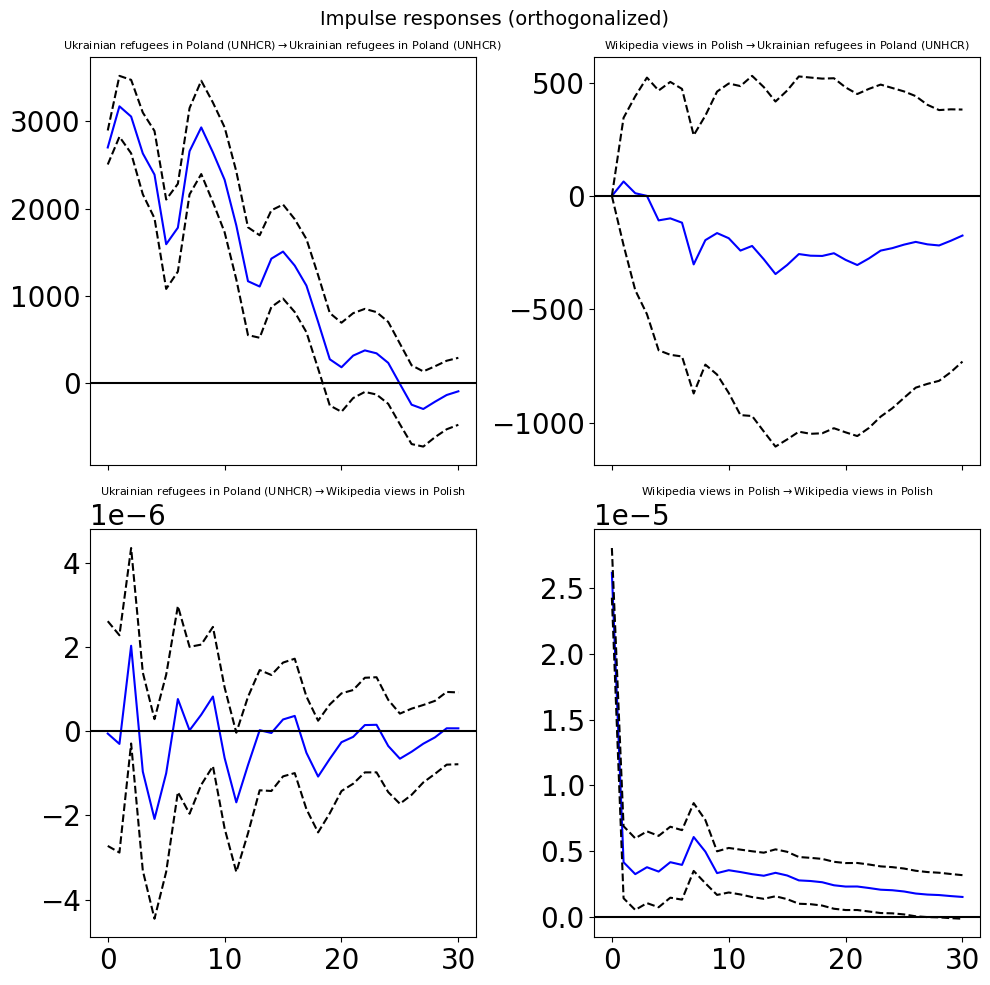

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    1.2357   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.5374   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
8                                    0.2770   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.8282

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -10.88      -10.86   1.881e-05      -10.87
1       -11.88      -11.81   6.935e-06      -11.85
2       -11.99      -11.88   6.181e-06      -11.95
3       -12.07     -11.91*   5.757e-06      -12.00
4       -12.07      -11.87   5.742e-06      -11.99
5       -12.09      -11.84   5.643e-06      -11.99
6       -12.16      -11.87   5.219e-06      -12.05
7       -12.19      -11.85   5.094e-06      -12.05
8      -12.22*      -11.84  4.955e-06*     -12.07*
9       -12.20      -11.78   5.025e-06      -12.03
10      -12.19      -11.72   5.093e-06      -12.00
11      -12.18      -11.67   5.158e-06      -11.97
12      -12.16      -11.61   5.214e-06      -11.94
13      -12.16      -11.56   5.222e-06      -11.92
14      -12.17      -11.52   5.202e-06      -11.91
15      -12.1

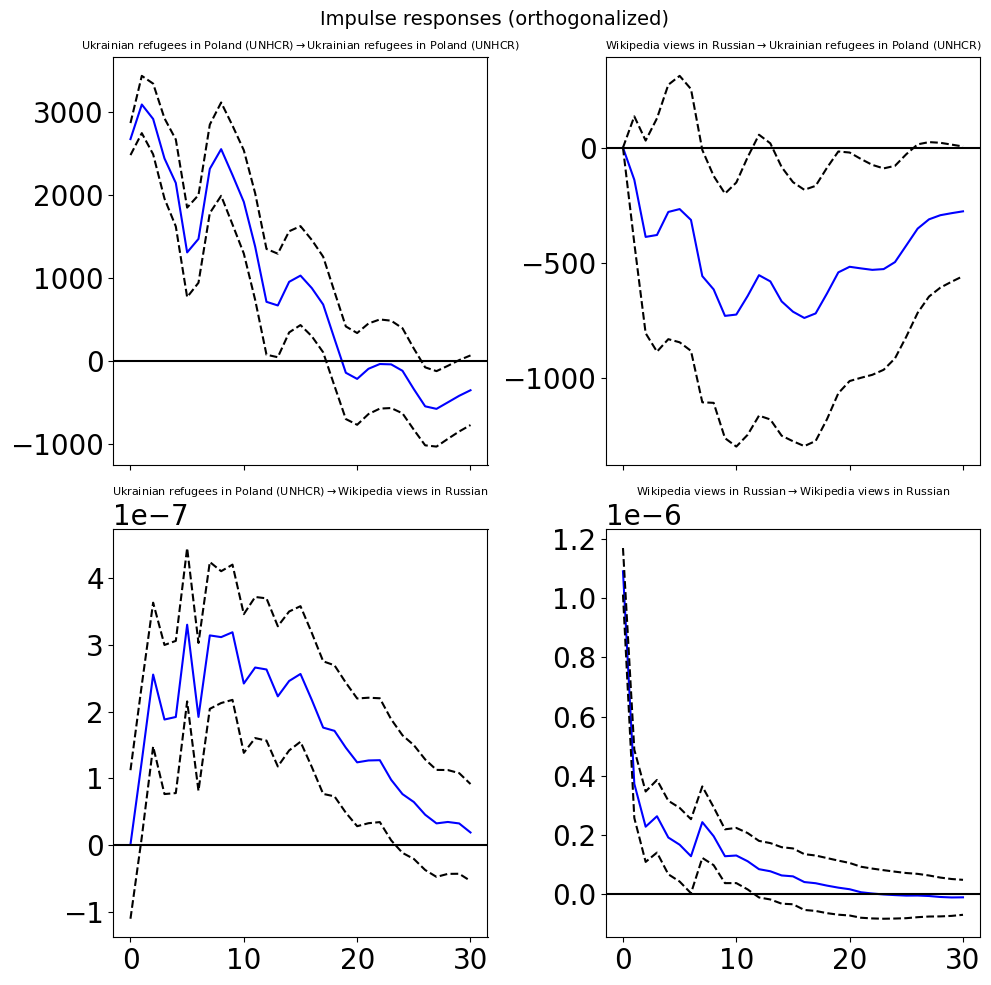

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                   10.2376   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.3356   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0000   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.2245

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.816      -6.794    0.001096      -6.807
1       -8.111      -8.044   0.0003003      -8.084
2       -8.201      -8.090   0.0002743      -8.157
3       -8.224      -8.069   0.0002681      -8.162
4       -8.256      -8.056   0.0002598      -8.176
5       -8.319      -8.075   0.0002439      -8.222
6       -8.420     -8.132*   0.0002204      -8.305
7       -8.438      -8.105   0.0002165      -8.305
8      -8.477*      -8.100  0.0002082*     -8.327*
9       -8.455      -8.034   0.0002128      -8.288
10      -8.453      -7.987   0.0002133      -8.268
11      -8.438      -7.928   0.0002166      -8.235
12      -8.437      -7.882   0.0002168      -8.216
13      -8.430      -7.831   0.0002184      -8.191
14      -8.436      -7.793   0.0002170      -8.180
15      -8.45

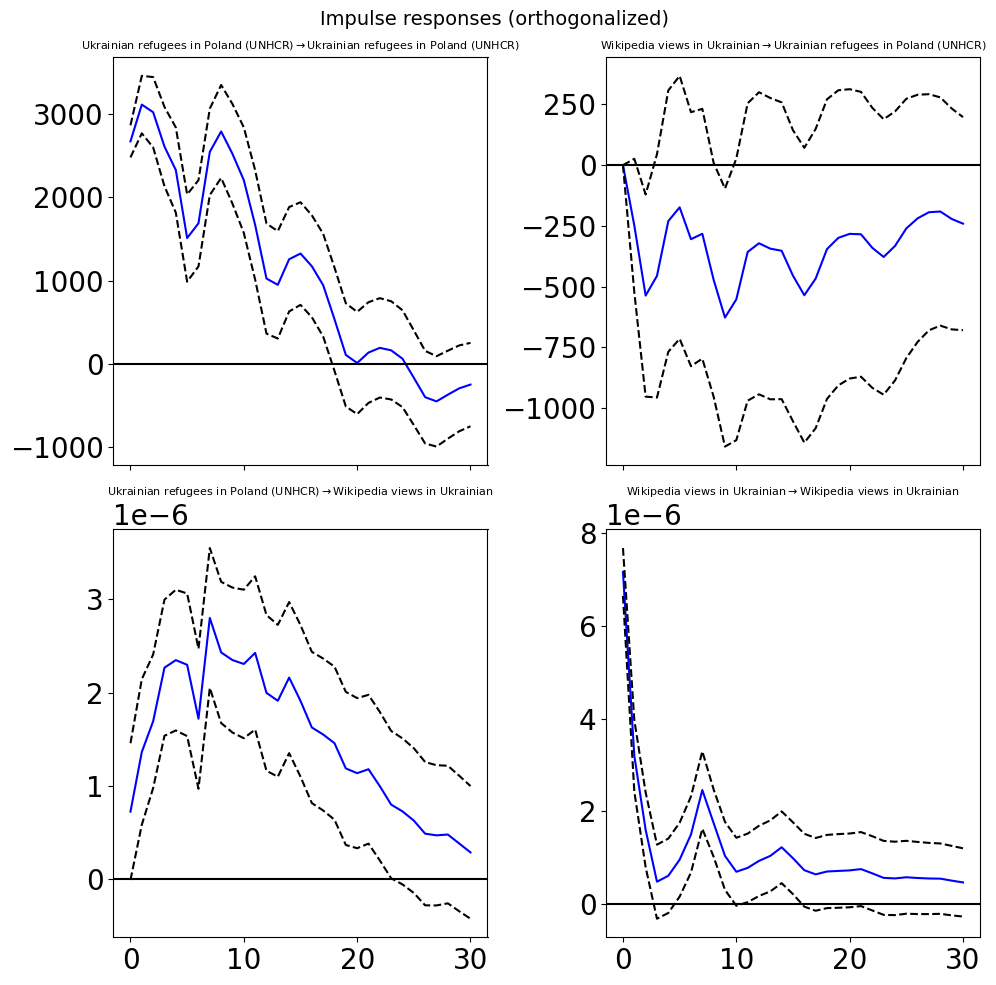

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                   10.9263   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.3899   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1994

Gdynia
Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -14.92      -14.90   3.305e-07      -14.91
1       -15.74      -15.67   1.465e-07      -15.71
2       -15.82     -15.71*   1.348e-07      -15.78
3       -15.84      -15.68   1.321e-07      -15.78
4       -15.83      -15.63   1.333e-07      -15.75
5       -15.86      -15.62   1.294e-07      -15.76
6       -15.94      -15.65   1.197e-07      -15.82
7       -15.94      -15.61   1.189e-07      -15.81
8      -15.98*      -15.61  1.144e-07*     -15.83*
9       -15.97      -15.55   1.158e-07      -15.80
10      -15.95      -15.49   1.178e-07      -15.77
11      -15.95      -15.44   1.186e-07      -15.74
12      -15.94      -15.39   1.192e-07      -15.72
13      -15.94      -15.34   1.192e-07      -15.70
14      -15.93      -15.29   1.206e-07      -15.68
15    

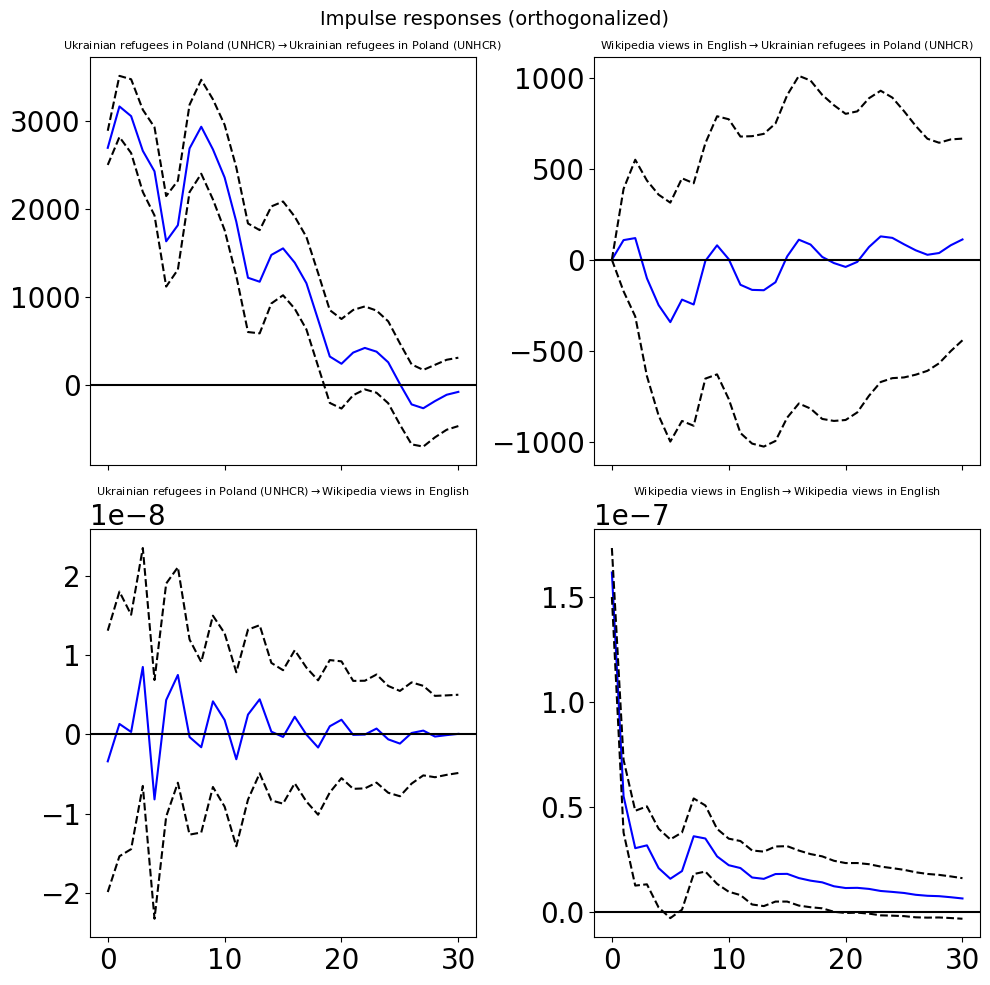

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.6543   

                                             \
Cause            Wikipedia views in English   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    0.6969   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in English   
Lag                                           
8                                    0.7316   

                                             
Cause            Wikipedia views in English  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.6944

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -5.769      -5.747    0.003122      -5.760
1       -6.535      -6.469    0.001452      -6.509
2       -6.612     -6.501*    0.001345      -6.568
3       -6.621      -6.466    0.001332      -6.559
4       -6.637      -6.437    0.001311      -6.557
5       -6.668      -6.424    0.001271      -6.570
6       -6.751      -6.463    0.001170      -6.636
7       -6.758      -6.425    0.001162      -6.625
8       -6.787      -6.410    0.001128     -6.637*
9       -6.766      -6.345    0.001152      -6.599
10      -6.757      -6.292    0.001163      -6.572
11      -6.763      -6.252    0.001157      -6.559
12      -6.751      -6.197    0.001170      -6.530
13      -6.738      -6.139    0.001186      -6.499
14      -6.728      -6.085    0.001198      -6.472
15      -6.75

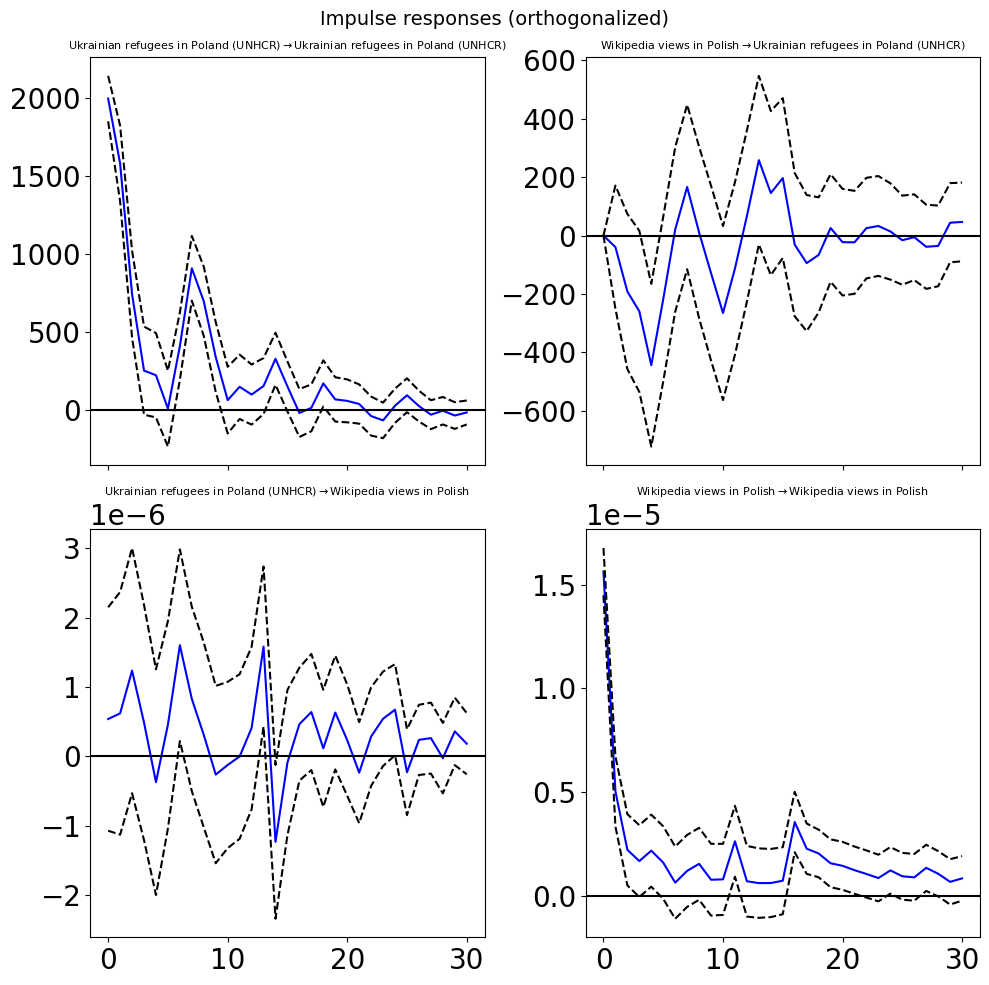

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
16                                   1.1271   

                                             \
Cause             Wikipedia views in Polish   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
16                                   1.3944   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect            Wikipedia views in Polish   
Lag                                           
16                                   0.3282   

                                             
Cause             Wikipedia views in Polish  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
16                                   0.1419

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -11.22      -11.20   1.335e-05      -11.22
1       -11.92      -11.86   6.639e-06      -11.90
2       -11.99     -11.88*   6.223e-06      -11.94
3       -12.00      -11.85   6.125e-06      -11.94
4       -12.03      -11.83   5.973e-06      -11.95
5       -12.05      -11.81   5.846e-06      -11.95
6       -12.16      -11.87   5.240e-06     -12.04*
7       -12.14      -11.81   5.334e-06      -12.01
8      -12.17*      -11.79  5.174e-06*      -12.02
9       -12.16      -11.74   5.252e-06      -11.99
10      -12.14      -11.68   5.321e-06      -11.96
11      -12.13      -11.62   5.412e-06      -11.92
12      -12.11      -11.56   5.503e-06      -11.89
13      -12.10      -11.50   5.585e-06      -11.86
14      -12.10      -11.46   5.569e-06      -11.84
15      -12.0

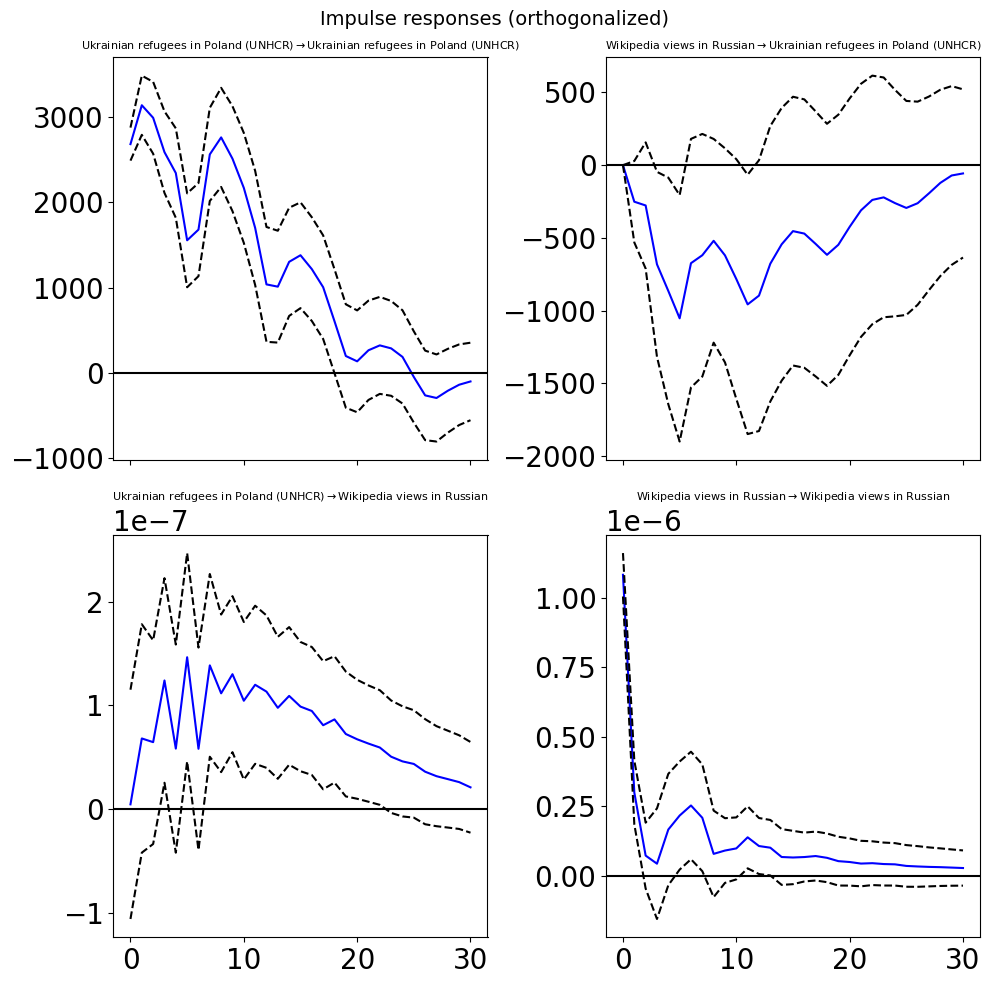

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    3.0884   

                                             \
Cause            Wikipedia views in Russian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.1181   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect           Wikipedia views in Russian   
Lag                                           
8                                    0.0022   

                                             
Cause            Wikipedia views in Russian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.3501

Step 1: Optimal lag selection using AIC and FPE
Lag Order Selection:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -7.970      -7.948   0.0003458      -7.961
1       -9.043      -8.976   0.0001182      -9.016
2       -9.232      -9.121   9.784e-05      -9.188
3       -9.265      -9.110   9.465e-05      -9.204
4       -9.311      -9.112   9.039e-05      -9.232
5       -9.326      -9.081   8.912e-05      -9.228
6       -9.443     -9.154*   7.927e-05      -9.328
7       -9.446      -9.113   7.904e-05      -9.313
8      -9.503*      -9.126  7.465e-05*     -9.353*
9       -9.488      -9.067   7.575e-05      -9.320
10      -9.473      -9.007   7.695e-05      -9.287
11      -9.478      -8.968   7.654e-05      -9.275
12      -9.479      -8.924   7.650e-05      -9.258
13      -9.468      -8.869   7.736e-05      -9.229
14      -9.462      -8.819   7.781e-05      -9.206
15      -9.46

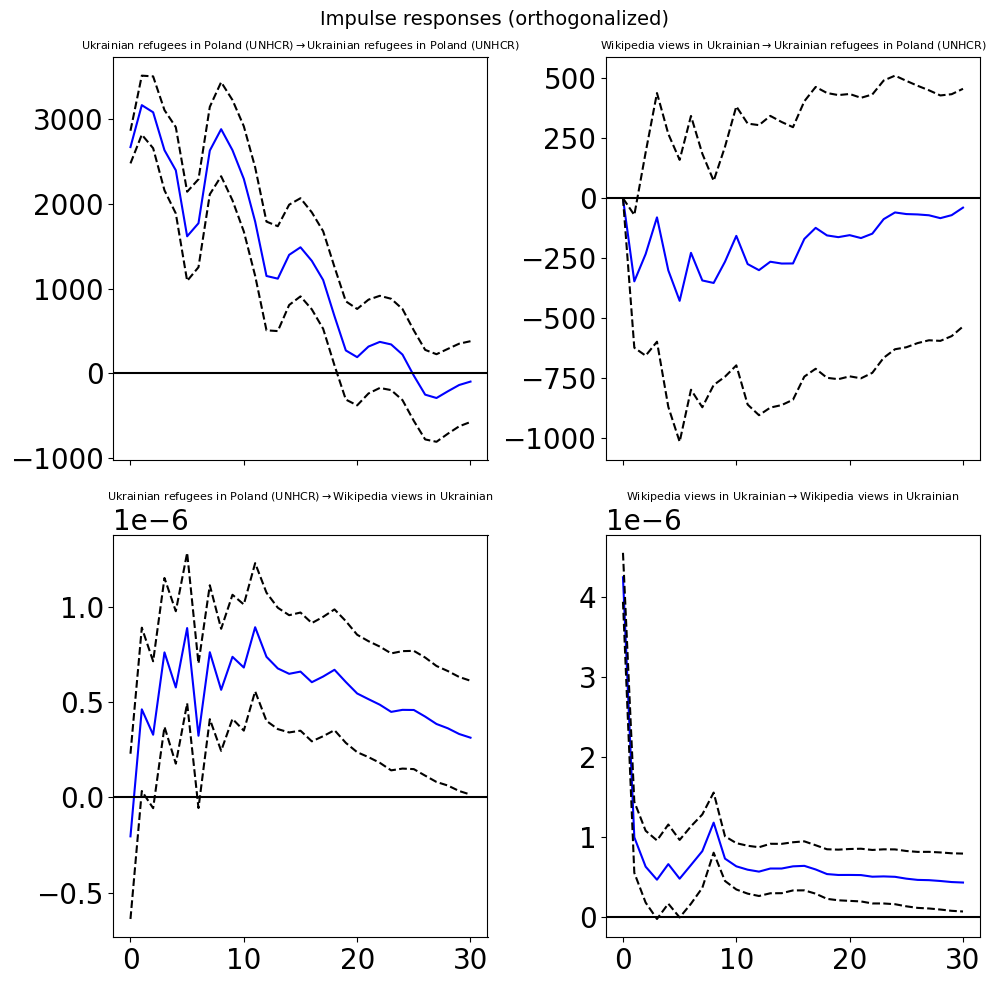

F-statistic  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    6.5065   

                                             \
Cause          Wikipedia views in Ukrainian   
Effect Ukrainian refugees in Poland (UNHCR)   
Lag                                           
8                                    1.5686   

                                    p-value  \
Cause  Ukrainian refugees in Poland (UNHCR)   
Effect         Wikipedia views in Ukrainian   
Lag                                           
8                                    0.0000   

                                             
Cause          Wikipedia views in Ukrainian  
Effect Ukrainian refugees in Poland (UNHCR)  
Lag                                          
8                                    0.1328

In [17]:
dict_stats = dict()

for csv_f in csv_files:
    city = csv_f.split("\\")[4].split("_")[0]
    print(city)

    dict_stats[city] = dict()
    
    df = pd.read_csv(csv_f, parse_dates=True, index_col=0)
    df.columns = [col.replace('\n', '').replace('  ', ' ') for col in df.columns]
    df = df.dropna()

    for col in df.columns:
        if col != "Ukrainian refugees in Poland (UNHCR)":
            selected_cols = ["Ukrainian refugees in Poland (UNHCR)"] + [col]
            selected_lag = run_var_analysis(df[selected_cols], wiki_page=city, language=col.split(" ")[-1])
            gc_combined = extract_granger_combined_results(df[selected_cols], maxlag=selected_lag)
            df_gc_combined = pd.DataFrame.from_dict(gc_combined)
            display(format_granger_combined_table(df_gc_combined))
            
            dict_stats[city][gc_combined[0]["Cause"] + " → " + gc_combined[0]["Effect"]] = gc_combined[0]
            dict_stats[city][gc_combined[1]["Cause"] + " → " + gc_combined[1]["Effect"]] = gc_combined[1]

In [18]:
dict_stats

{'Toruń': {'Ukrainian refugees in Poland (UNHCR) → Wikipedia views in English': {'Cause': 'Ukrainian refugees in Poland (UNHCR)',
   'Effect': 'Wikipedia views in English',
   'Lag': np.int64(8),
   'F-statistic': '0.2770',
   'p-value': '0.9732',
   'Chi-squared test (p-value)': '2.3229 (p = 0.9695)'},
  'Wikipedia views in English → Ukrainian refugees in Poland (UNHCR)': {'Cause': 'Wikipedia views in English',
   'Effect': 'Ukrainian refugees in Poland (UNHCR)',
   'Lag': np.int64(8),
   'F-statistic': '0.9472',
   'p-value': '0.4775',
   'Chi-squared test (p-value)': '7.9439 (p = 0.4390)'},
  'Ukrainian refugees in Poland (UNHCR) → Wikipedia views in Polish': {'Cause': 'Ukrainian refugees in Poland (UNHCR)',
   'Effect': 'Wikipedia views in Polish',
   'Lag': np.int64(8),
   'F-statistic': '0.6589',
   'p-value': '0.7276',
   'Chi-squared test (p-value)': '5.5258 (p = 0.7002)'},
  'Wikipedia views in Polish → Ukrainian refugees in Poland (UNHCR)': {'Cause': 'Wikipedia views in Polis

In [19]:
df_stats = pd.DataFrame.from_dict(dict_stats, orient='index')
df_stats = {(innerKey, outerKey): values for outerKey, innerDict in df_stats.items() for innerKey, values in innerDict.items()}
df_stats = pd.DataFrame.from_dict(df_stats, orient="index")
df_stats.index.names = ['City', 'Relationship']
df_stats

,,Cause,Effect,Lag,F-statistic,p-value,Chi-squared test (p-value)
City,Relationship,,,,,,
Toruń,Ukrainian refugees in Poland (UNHCR) → Wikipedia views in English,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.2770,0.9732,2.3229 (p = 0.9695)
Kielce,Ukrainian refugees in Poland (UNHCR) → Wikipedia views in English,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.4695,0.8774,3.9376 (p = 0.8627)
Sosnowiec,Ukrainian refugees in Poland (UNHCR) → Wikipedia views in English,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,1.3295,0.2275,11.1494 (p = 0.1934)
Katowice,Ukrainian refugees in Poland (UNHCR) → Wikipedia views in English,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.2359,0.9840,1.9780 (p = 0.9817)
Bydgoszcz,Ukrainian refugees in Poland (UNHCR) → Wikipedia views in English,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,1.9953,0.0462,16.7332 (p = 0.0330)
...,...,...,...,...,...,...,...
Radom,Wikipedia views in Ukrainian → Ukrainian refugees in Poland (UNHCR),Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),15,1.9812,0.0160,32.5010 (p = 0.0055)
Częstochowa,Wikipedia views in Ukrainian → Ukrainian refugees in Poland (UNHCR),Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),8,1.8406,0.0686,15.4362 (p = 0.0512)
Rzeszów,Wikipedia views in Ukrainian → Ukrainian refugees in Poland (UNHCR),Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),8,0.4189,0.9095,3.5127 (p = 0.8982)


In [20]:
df_stats.to_csv("data/stats_grangercausality.csv")

In [21]:
df_stats = pd.read_csv("data/stats_grangercausality.csv")
df_stats

,City,Relationship,Cause,Effect,Lag,F-statistic,p-value,Chi-squared test (p-value)
0,Toruń,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.2770,0.9732,2.3229 (p = 0.9695)
1,Kielce,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.4695,0.8774,3.9376 (p = 0.8627)
2,Sosnowiec,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,1.3295,0.2275,11.1494 (p = 0.1934)
3,Katowice,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.2359,0.9840,1.9780 (p = 0.9817)
4,Bydgoszcz,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,1.9953,0.0462,16.7332 (p = 0.0330)
...,...,...,...,...,...,...,...,...
147,Radom,Wikipedia views in Ukrainian → Ukrainian refug...,Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),15,1.9812,0.0160,32.5010 (p = 0.0055)
148,Częstochowa,Wikipedia views in Ukrainian → Ukrainian refug...,Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),8,1.8406,0.0686,15.4362 (p = 0.0512)
149,Rzeszów,Wikipedia views in Ukrainian → Ukrainian refug...,Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),8,0.4189,0.9095,3.5127 (p = 0.8982)
150,Poznań,Wikipedia views in Ukrainian → Ukrainian refug...,Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),8,1.3899,0.1994,11.6565 (p = 0.1672)


In [22]:
df_stats.groupby(by=["Lag"]).count()

,City,Relationship,Cause,Effect,F-statistic,p-value,Chi-squared test (p-value)
Lag,,,,,,,
8,132,132,132,132,132,132,132
9,4,4,4,4,4,4,4
10,2,2,2,2,2,2,2
13,2,2,2,2,2,2,2
15,2,2,2,2,2,2,2
16,2,2,2,2,2,2,2
17,4,4,4,4,4,4,4
23,4,4,4,4,4,4,4


In [23]:
df_stats[df_stats["Lag"] != 8]

,City,Relationship,Cause,Effect,Lag,F-statistic,p-value,Chi-squared test (p-value)
8,Kraków,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,9,4.4329,0.0000,42.0685 (p = 0.0000)
9,Lublin,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,13,0.4530,0.9486,6.3608 (p = 0.9320)
10,Warsaw,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,17,2.9418,0.0001,55.3956 (p = 0.0000)
27,Kraków,Wikipedia views in English → Ukrainian refugee...,Wikipedia views in English,Ukrainian refugees in Poland (UNHCR),9,9.6654,0.0000,91.7241 (p = 0.0000)
28,Lublin,Wikipedia views in English → Ukrainian refugee...,Wikipedia views in English,Ukrainian refugees in Poland (UNHCR),13,1.2192,0.2635,17.1192 (p = 0.1939)
29,Warsaw,Wikipedia views in English → Ukrainian refugee...,Wikipedia views in English,Ukrainian refugees in Poland (UNHCR),17,3.8055,0.0000,71.6597 (p = 0.0000)
50,Gliwice,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in Polish,9,0.6552,0.7493,6.2179 (p = 0.7179)
56,Gdynia,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in Polish,16,1.1271,0.3282,19.8475 (p = 0.2272)
69,Gliwice,Wikipedia views in Polish → Ukrainian refugees...,Wikipedia views in Polish,Ukrainian refugees in Poland (UNHCR),9,0.5463,0.8402,5.1848 (p = 0.8179)
75,Gdynia,Wikipedia views in Polish → Ukrainian refugees...,Wikipedia views in Polish,Ukrainian refugees in Poland (UNHCR),16,1.3944,0.1419,24.5558 (p = 0.0780)


In [24]:
df_stats

,City,Relationship,Cause,Effect,Lag,F-statistic,p-value,Chi-squared test (p-value)
0,Toruń,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.2770,0.9732,2.3229 (p = 0.9695)
1,Kielce,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.4695,0.8774,3.9376 (p = 0.8627)
2,Sosnowiec,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,1.3295,0.2275,11.1494 (p = 0.1934)
3,Katowice,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,0.2359,0.9840,1.9780 (p = 0.9817)
4,Bydgoszcz,Ukrainian refugees in Poland (UNHCR) → Wikiped...,Ukrainian refugees in Poland (UNHCR),Wikipedia views in English,8,1.9953,0.0462,16.7332 (p = 0.0330)
...,...,...,...,...,...,...,...,...
147,Radom,Wikipedia views in Ukrainian → Ukrainian refug...,Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),15,1.9812,0.0160,32.5010 (p = 0.0055)
148,Częstochowa,Wikipedia views in Ukrainian → Ukrainian refug...,Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),8,1.8406,0.0686,15.4362 (p = 0.0512)
149,Rzeszów,Wikipedia views in Ukrainian → Ukrainian refug...,Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),8,0.4189,0.9095,3.5127 (p = 0.8982)
150,Poznań,Wikipedia views in Ukrainian → Ukrainian refug...,Wikipedia views in Ukrainian,Ukrainian refugees in Poland (UNHCR),8,1.3899,0.1994,11.6565 (p = 0.1672)


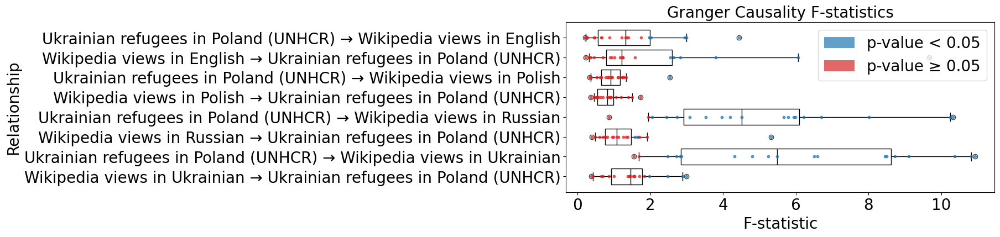

In [25]:
plot_fstat_by_relationship(df_stats)

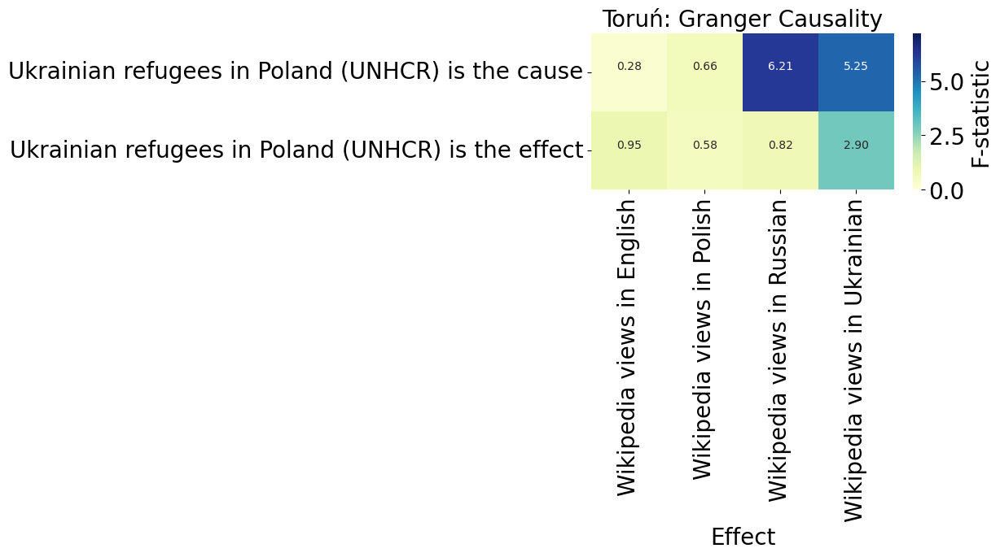

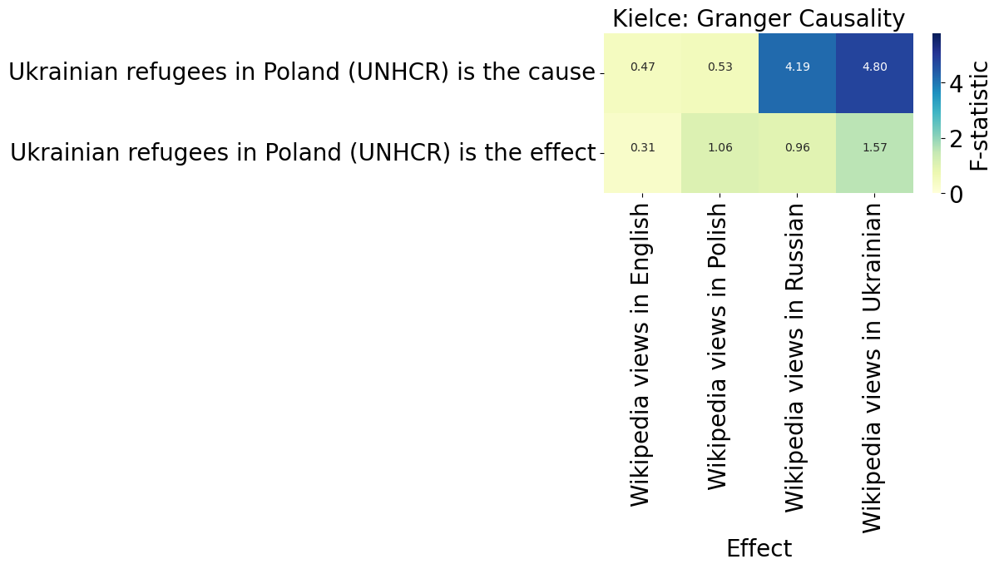

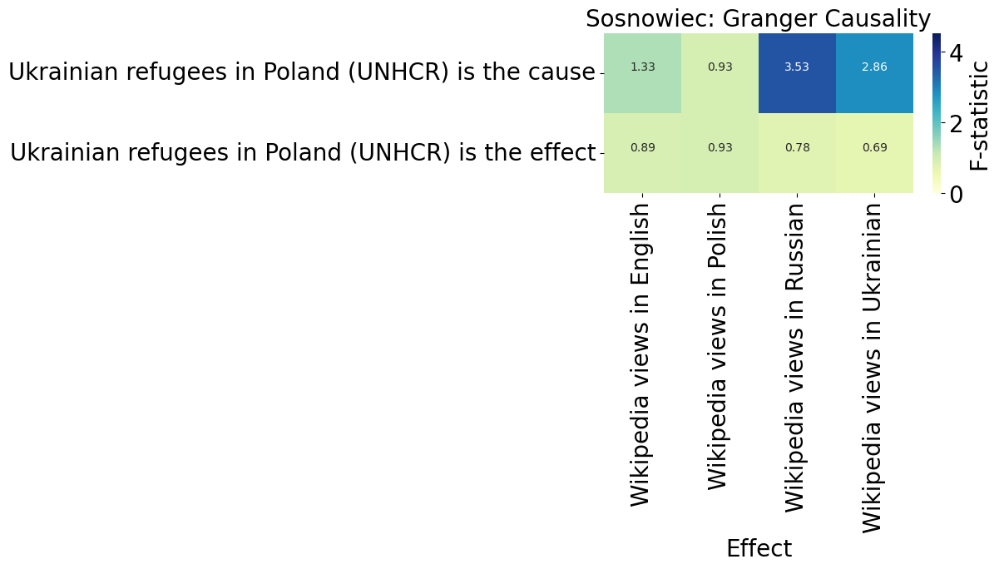

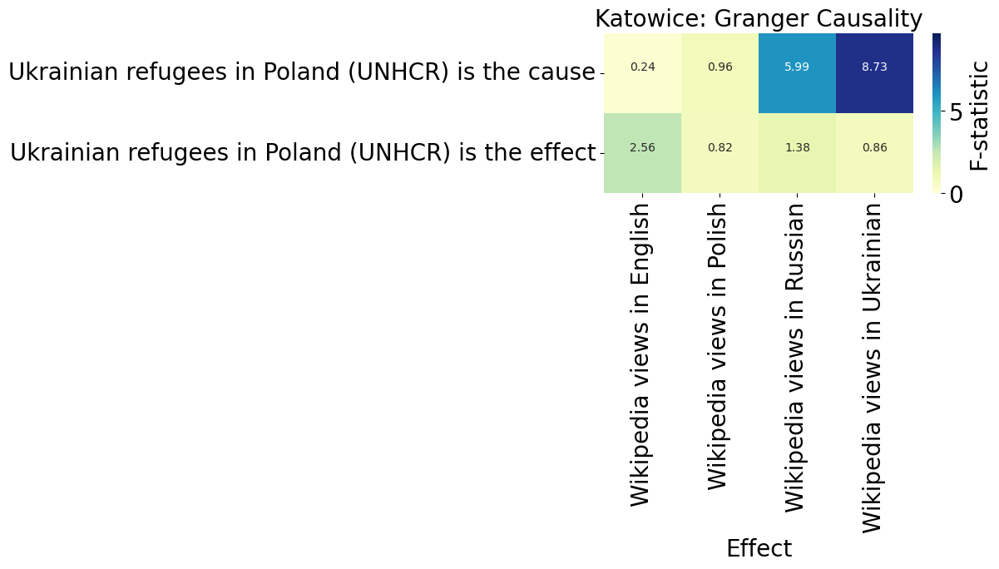

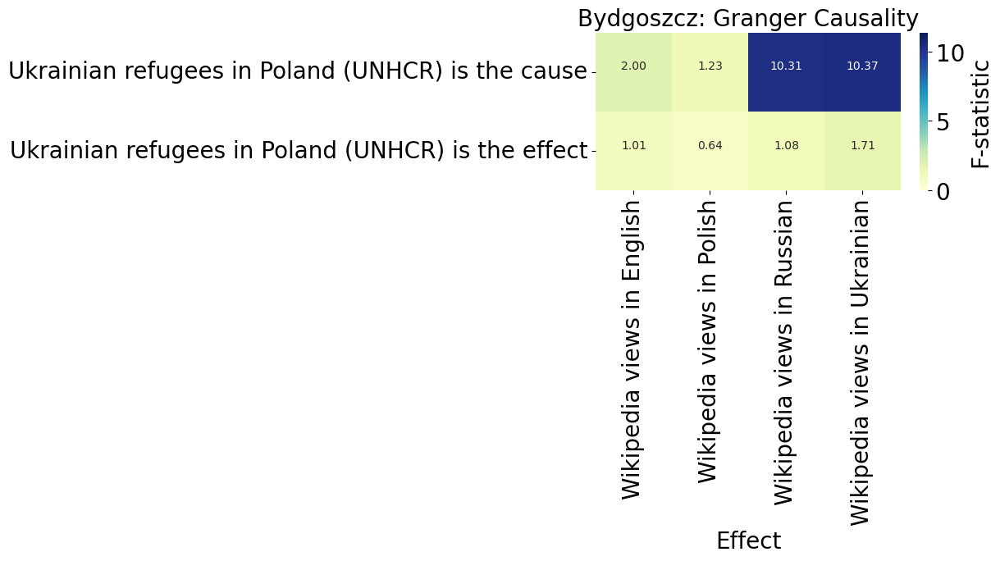

...

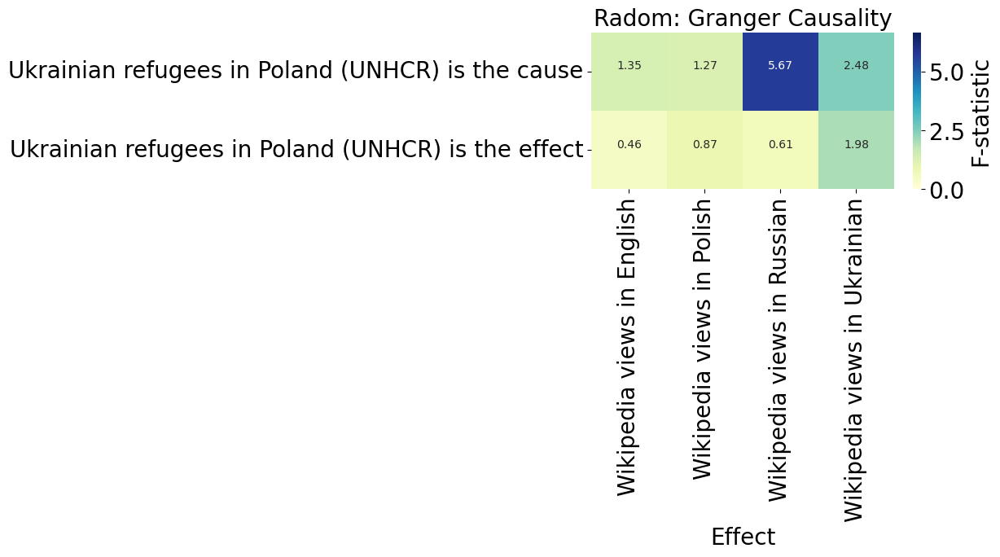

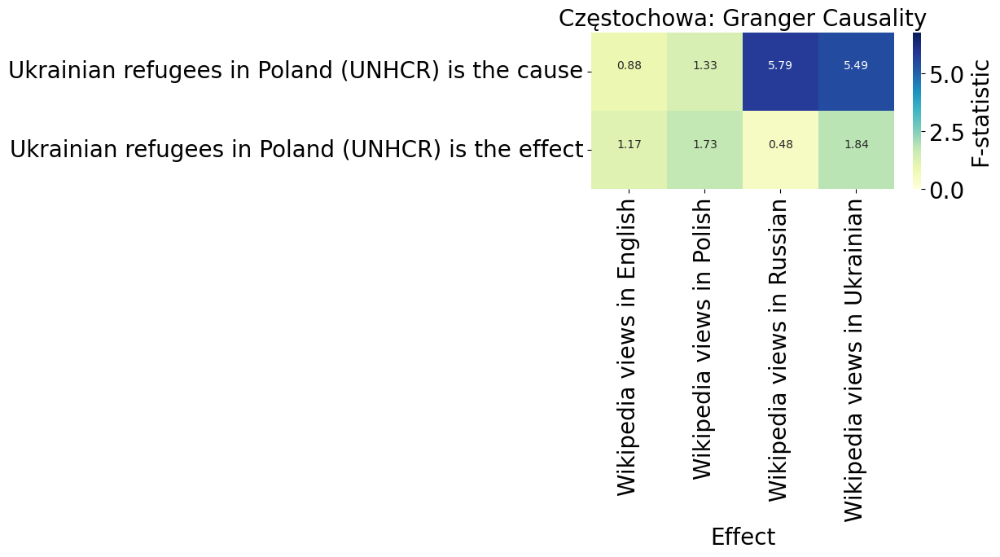

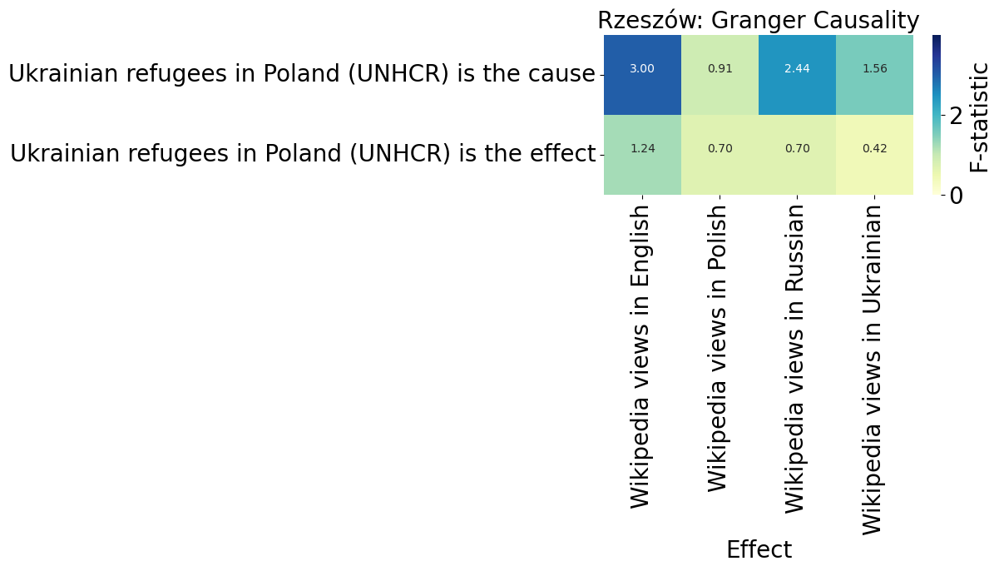

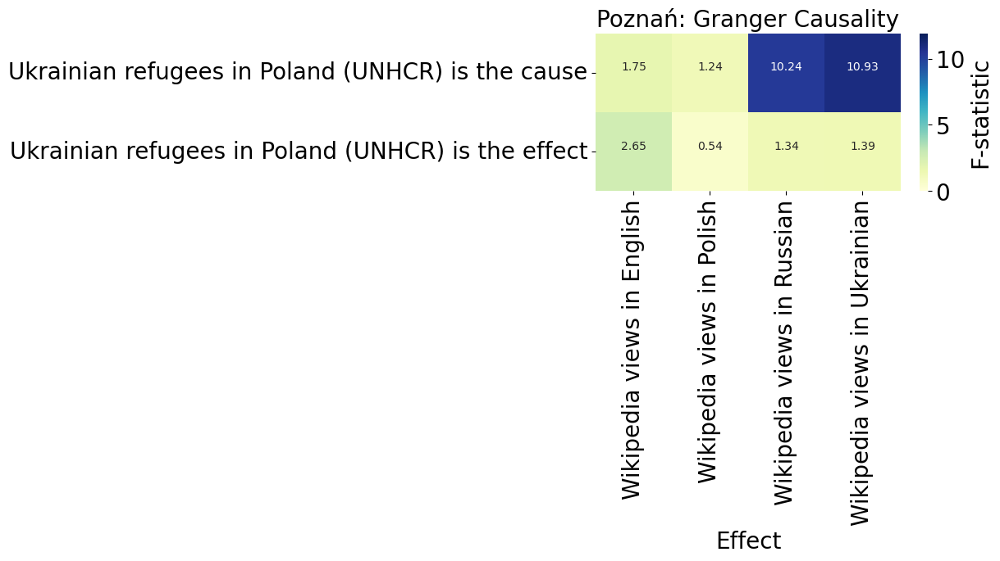

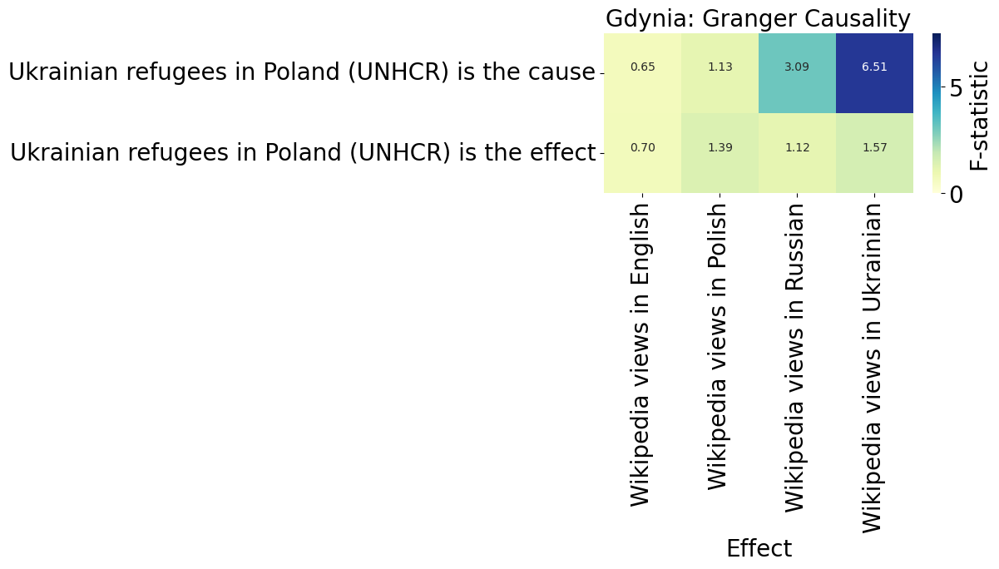

In [26]:
for city in df_stats["City"].unique():
    plot_granger_causality(df_stats, city)

In [27]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [28]:
df_stats_latex = df_stats.copy(deep=True)
    
df_stats_latex.sort_values(by=["City", "Relationship"])
df_stats_latex.set_index(["City", "Relationship"], inplace=True)
df_stats_latex["F-statistic (p-value)"] = df_stats_latex["F-statistic"].map(lambda x: f"{x:.2f}") + " (p = " + df_stats_latex["p-value"].map(lambda x: f"{x:.4f}") + ")"

In [29]:
df_stats_sig = df_stats_latex[df_stats_latex["p-value"] < 0.05]
df_stats_sig.drop(columns=["F-statistic", "p-value", "Cause", "Effect", "Chi-squared test (p-value)"], inplace=True)

In [30]:
df_stats_sig.sort_index()

Lag  \
City        Relationship                                              
Białystok   Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Wikipedia views in English → Ukrainian refugees...    8   
Bydgoszcz   Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
Częstochowa Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
Gdańsk      Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...   23   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Wikipedia views in English → Ukrainian refugees...    8   
            Wikipedia views in Russian → Ukrainian refugees...   23   
            Wikipedia views in Ukrainian → Ukrainian refuge...    8   
Gdynia      Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
Gliwice     Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
Katowice    Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Wikipedia views in English → Ukrainian refugees...    8   
Kielce      Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
Kraków      Ukrainian refugees in Poland (UNHCR) → Wikipedi...    9   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Wikipedia views in English → Ukrainian refugees...    9   
Poznań      Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Wikipedia views in English → Ukrainian refugees...    8   
Radom       Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...   15   
            Wikipedia views in Ukrainian → Ukrainian refuge...   15   
Rzeszów     Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
Sosnowiec   Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
Szczecin    Ukrainian refugees in Poland (UNHCR) → Wikipedi...   10   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Wikipedia views in Russian → Ukrainian refugees...   10   
Toruń       Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Wikipedia views in Ukrainian → Ukrainian refuge...    8   
Warsaw      Ukrainian refugees in Poland (UNHCR) → Wikipedi...   17   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...   23   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Wikipedia views in English → Ukrainian refugees...   17   
            Wikipedia views in Russian → Ukrainian refugees...   23   
Wrocław     Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...   17   
            Wikipedia views in Ukrainian → Ukrainian refuge...   17   
Łódź        Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   
            Ukrainian refugees in Poland (UNHCR) → Wikipedi...    8   

                                                               F-statistic (p-value)  


In [31]:
print(df_stats_sig.sort_index().to_latex(multirow=True))

\begin{tabular}{llrl}
\toprule
 &  & Lag & F-statistic (p-value) \\
City & Relationship &  &  \\
\midrule
\multirow[t]{3}{*}{Białystok} & Ukrainian refugees in Poland (UNHCR) → Wikipedia views in English & 8 & 1.98 (p = 0.0484) \\
 & Ukrainian refugees in Poland (UNHCR) → Wikipedia views in Ukrainian & 8 & 8.45 (p = 0.0000) \\
 & Wikipedia views in English → Ukrainian refugees in Poland (UNHCR) & 8 & 2.83 (p = 0.0046) \\
\cline{1-4}
\multirow[t]{3}{*}{Bydgoszcz} & Ukrainian refugees in Poland (UNHCR) → Wikipedia views in English & 8 & 2.00 (p = 0.0462) \\
 & Ukrainian refugees in Poland (UNHCR) → Wikipedia views in Russian & 8 & 10.31 (p = 0.0000) \\
 & Ukrainian refugees in Poland (UNHCR) → Wikipedia views in Ukrainian & 8 & 10.37 (p = 0.0000) \\
\cline{1-4}
\multirow[t]{2}{*}{Częstochowa} & Ukrainian refugees in Poland (UNHCR) → Wikipedia views in Russian & 8 & 5.79 (p = 0.0000) \\
 & Ukrainian refugees in Poland (UNHCR) → Wikipedia views in Ukrainian & 8 & 5.49 (p = 0.0000) \\
\clin